# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [9]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [10]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [11]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [12]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

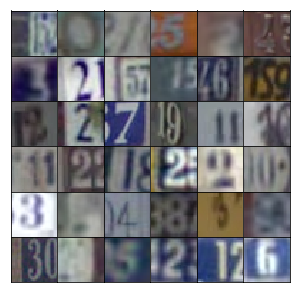

In [13]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [14]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    # AE: Turning whatever arbitrary scale we have (i.e. [-5, 5]) to [0, 1]
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    # AE: now turning our [0. 1] to [-1, 1]
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [15]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [16]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [58]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        # AE: making the output (for now) a flattened vector of 512 * 4 * 4 elements. We'll reshape it next.
        x = tf.layers.dense(inputs=z, units=512 * 4 * 4, activation=None, use_bias=True)
        # AE: Reshaping into the required geometry according to the architecture pictured above. 4D because the first one (-1)
        # AE: is for "batch", 4=height, 4=width, 512=filters. We'll use the dimensions in that order later in 
        # AE: tf.layers.conv2d_transpose by choosing data_format=channels_last
        x = tf.reshape(x, [-1, 4, 4, 512])
        # AE: applying batch normalisation.
        x = tf.layers.batch_normalization(inputs=x, training=training)
        # AE: applying leaky ReLU activation
        x = tf.maximum(x * alpha, x)
        
        # AE: Now we'll do convolutional layers.
        # AE: We'll use previous layer as inputs, we'll have number of filters halving with every new conv layer,
        # AE: kernel size (window size) will be 5 and strides will be 2 as per the architecture pictured above,
        # AE: we'll apply activation later and don't want bias as we'll be using batch normalisation
        xc = tf.layers.conv2d_transpose(inputs=x, filters=256, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=True, data_format='channels_last')
        # AE: Applying batch normalisation
        xc = tf.layers.batch_normalization(inputs=xc, training=training)
        # AE: Applying leaky ReLU
        xc = tf.maximum(xc * alpha, xc)

        # AE: now with filters = 128
        xc = tf.layers.conv2d_transpose(inputs=x, filters=128, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=True, data_format='channels_last')
        xc = tf.layers.batch_normalization(inputs=xc, training=training)
        xc = tf.maximum(xc * alpha, xc)

        # AE: now with dimensionality as specified (normally 32x32x3)
        # AE: don't want batch normalisation and activation function on this one as this will be logits
        xc = tf.layers.conv2d_transpose(inputs=x, filters=output_dim, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=True, data_format='channels_last')
        
        # Output layer, 32x32x3
        logits = xc
        
        out = tf.tanh(logits)
        
        return out

In [17]:
# AE: Generator from the solution notebook:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [18]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # AE: First convolutional layer is supposed to be without batch normalisation
        xc = tf.layers.conv2d(inputs=x, filters=64, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=True, data_format='channels_last')
        # AE: Applying leaky ReLU
        xc = tf.maximum(xc * alpha, xc)

        # AE: We now have a geometry of 16 x 16 x 64
        # AE: downsampling by increasing number of filters and halving width and height width strides=2
        xc = tf.layers.conv2d(inputs=xc, filters=128, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=False, data_format='channels_last')
        # AE: applying batch normalisation
        xc = tf.layers.batch_normalization(inputs=xc, training=True)
        # AE: Applying leaky ReLU
        xc = tf.maximum(xc * alpha, xc)
        
        # AE: We now have a geometry of 8 x 8 x 128
        # AE: downsampling by increasing number of filters and halving width and height width strides=2
        xc = tf.layers.conv2d(inputs=xc, filters=256, kernel_size=5, strides=2, padding='same', 
                                        activation=None, use_bias=False, data_format='channels_last')
        # AE: applying batch normalisation
        xc = tf.layers.batch_normalization(inputs=xc, training=True)
        # AE: Applying leaky ReLU
        xc = tf.maximum(xc * alpha, xc)
        
        # AE: We now have a geometry of 4 x 4 x 256
        # AE: Flattening our convolutional result so that we can reduce it to 1 output with a dense layer.
        xc = tf.reshape(xc, (-1, 4 * 4 * 256))
        final_fc = tf.layers.dense(inputs=xc, units=1, activation=None, use_bias=True)
        
        logits = final_fc
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [19]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [20]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [21]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [22]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [23]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [24]:
#real_size = (32,32,3)
#z_size = 100
#learning_rate = 0.001
#batch_size = 64
#epochs = 1
#alpha = 0.01
#beta1 = 0.9

# AE: From the paper:
#No pre-processing was applied to training images besides scaling to the range of the tanh activation
#function [-1, 1]. All models were trained with mini-batch stochastic gradient descent (SGD) with
#a mini-batch size of 128. All weights were initialized from a zero-centered Normal distribution
#with standard deviation 0.02. In the LeakyReLU, the slope of the leak was set to 0.2 in all models.
#While previous GAN work has used momentum to accelerate training, we used the Adam optimizer
#(Kingma & Ba, 2014) with tuned hyperparameters. We found the suggested learning rate of 0.001,
#to be too high, using 0.0002 instead. Additionally, we found leaving the momentum term β1 at the
#suggested value of 0.9 resulted in training oscillation and instability while reducing it to 0.5 helped
#stabilize training.

# Values from the solution jupyter notebook:
#real_size = (32,32,3)
#z_size = 100
#learning_rate = 0.0002
#batch_size = 128
#epochs = 25
#alpha = 0.2
#beta1 = 0.5

# AE: It seems that my discriminator constantly overpowers my generator. I've tried changing their architectures
# AE: to the point where they are identical to the solution notebook's ones. I've also tried to tune the hyper
# AE: parameters, but it proves very challenging. After a while generator typically starts generating a primitive
# AE: image of checkers board in two or 3 colours and it doesn't improve from that anymore. I think that alhpa, beta and
# AE: lr parameters here are crucial.

#real_size = (32,32,3)
#z_size = 100
#learning_rate = 0.0002
#batch_size = 128
#epochs = 25
#alpha = 0.1
#beta1 = 0.8

#real_size = (32,32,3)
#z_size = 100
#learning_rate = 0.0001
#batch_size = 128
#epochs = 25
#alpha = 0.1
#beta1 = 0.5

real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# AE: A few words on the final result: I tried everything I could think of. Hyperparameters were taken from the paper early
# AE: on, then I started tweaking architectures of my discriminator and generator by removing layers from them and making
# AE: them simpler. That improved speed, but not the result. Eventually I ended up with both my discriminator and generator
# AE: architectures being (what I though should have been) functianlly identical to the ones in solution notebook. But even
# AE: so the result was wrong- discriminator was overpowering generator. Then out of desperation I copy-pasted generator
# AE: from the solution and it magically all worked. I still don't know how can it be functionally different from my
# AE: generator, but it is. My guess is that maybe the TF version has changed and I was reading the newest documentation
# AE: while working with an older TF. Perhaps the activation function in tf.layers.conv2d_transpose used to be ReLU by 
# AE: default and is now None by default. In that case the solution notebook would have been using ReLU activation functions
# AE: while I was using None. But that's just a guess. Maybe some time in the future I will try to revisit and completely
# AE: solve this problem.

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5478... Generator Loss: 0.6308
Epoch 1/25... Discriminator Loss: 0.3542... Generator Loss: 2.6208
Epoch 1/25... Discriminator Loss: 0.2049... Generator Loss: 2.0957
Epoch 1/25... Discriminator Loss: 0.1819... Generator Loss: 2.5389
Epoch 1/25... Discriminator Loss: 0.2053... Generator Loss: 2.3606
Epoch 1/25... Discriminator Loss: 0.1499... Generator Loss: 2.6014
Epoch 1/25... Discriminator Loss: 0.1783... Generator Loss: 2.5392
Epoch 1/25... Discriminator Loss: 0.1576... Generator Loss: 5.2122
Epoch 1/25... Discriminator Loss: 0.1402... Generator Loss: 3.2181
Epoch 1/25... Discriminator Loss: 0.1092... Generator Loss: 3.4663


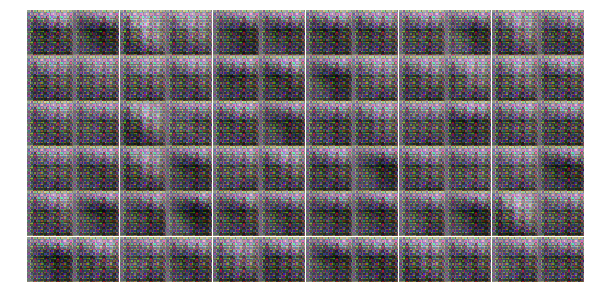

Epoch 1/25... Discriminator Loss: 0.5349... Generator Loss: 1.2775
Epoch 1/25... Discriminator Loss: 0.5254... Generator Loss: 1.6635
Epoch 1/25... Discriminator Loss: 0.4913... Generator Loss: 1.3746
Epoch 1/25... Discriminator Loss: 0.2847... Generator Loss: 2.2617
Epoch 1/25... Discriminator Loss: 0.4769... Generator Loss: 1.6794
Epoch 1/25... Discriminator Loss: 0.3911... Generator Loss: 1.6688
Epoch 1/25... Discriminator Loss: 0.1924... Generator Loss: 2.7289
Epoch 1/25... Discriminator Loss: 0.2448... Generator Loss: 2.8303
Epoch 1/25... Discriminator Loss: 0.2960... Generator Loss: 3.0799
Epoch 1/25... Discriminator Loss: 0.4686... Generator Loss: 1.3237


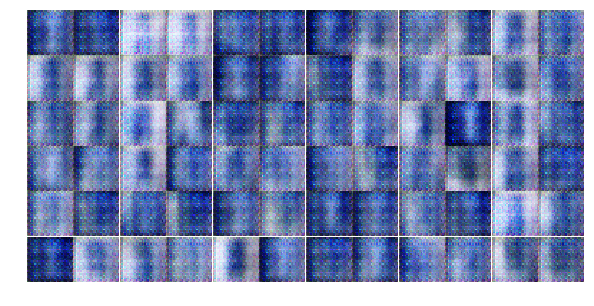

Epoch 1/25... Discriminator Loss: 1.0352... Generator Loss: 0.7800
Epoch 1/25... Discriminator Loss: 1.4514... Generator Loss: 0.3329
Epoch 1/25... Discriminator Loss: 0.7396... Generator Loss: 0.9257
Epoch 1/25... Discriminator Loss: 1.5980... Generator Loss: 1.2985
Epoch 1/25... Discriminator Loss: 0.7532... Generator Loss: 4.4834
Epoch 1/25... Discriminator Loss: 0.3934... Generator Loss: 3.3634
Epoch 1/25... Discriminator Loss: 0.4983... Generator Loss: 2.4626
Epoch 1/25... Discriminator Loss: 0.9365... Generator Loss: 1.2342
Epoch 1/25... Discriminator Loss: 0.8728... Generator Loss: 2.8630
Epoch 1/25... Discriminator Loss: 0.7907... Generator Loss: 1.2106


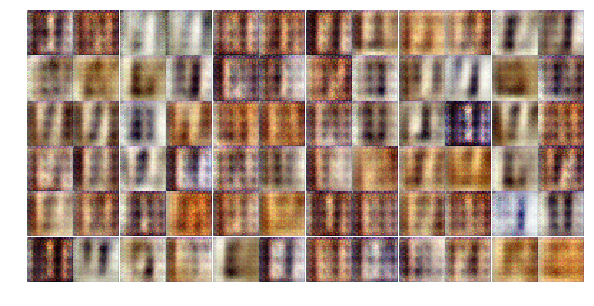

Epoch 1/25... Discriminator Loss: 0.9176... Generator Loss: 0.8409
Epoch 1/25... Discriminator Loss: 1.0838... Generator Loss: 0.7266
Epoch 1/25... Discriminator Loss: 1.0771... Generator Loss: 0.8795
Epoch 1/25... Discriminator Loss: 0.9954... Generator Loss: 1.6624
Epoch 1/25... Discriminator Loss: 0.4496... Generator Loss: 1.7174
Epoch 1/25... Discriminator Loss: 0.6857... Generator Loss: 1.4171
Epoch 1/25... Discriminator Loss: 0.6047... Generator Loss: 1.5581
Epoch 1/25... Discriminator Loss: 0.5731... Generator Loss: 1.8508
Epoch 1/25... Discriminator Loss: 0.4590... Generator Loss: 2.1600
Epoch 1/25... Discriminator Loss: 0.5642... Generator Loss: 1.5450


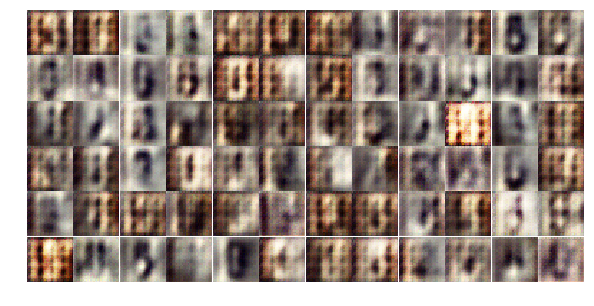

Epoch 1/25... Discriminator Loss: 0.6241... Generator Loss: 1.2368
Epoch 1/25... Discriminator Loss: 0.2257... Generator Loss: 2.5594
Epoch 1/25... Discriminator Loss: 0.6184... Generator Loss: 1.2740
Epoch 1/25... Discriminator Loss: 1.4663... Generator Loss: 0.7244
Epoch 1/25... Discriminator Loss: 0.9157... Generator Loss: 1.1991
Epoch 1/25... Discriminator Loss: 1.0164... Generator Loss: 0.8013
Epoch 1/25... Discriminator Loss: 0.7489... Generator Loss: 1.2638
Epoch 1/25... Discriminator Loss: 0.6464... Generator Loss: 2.1223
Epoch 1/25... Discriminator Loss: 1.0060... Generator Loss: 0.7881
Epoch 1/25... Discriminator Loss: 0.8195... Generator Loss: 0.9818


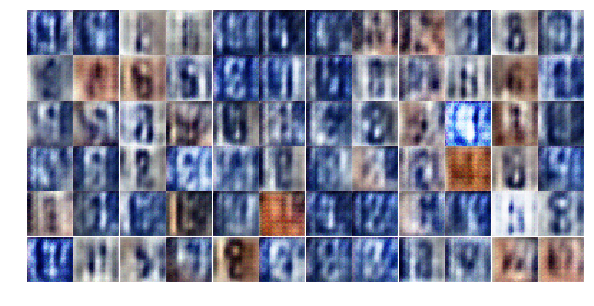

Epoch 1/25... Discriminator Loss: 0.8576... Generator Loss: 0.9914
Epoch 1/25... Discriminator Loss: 1.1994... Generator Loss: 1.2190
Epoch 1/25... Discriminator Loss: 0.5155... Generator Loss: 1.7329
Epoch 1/25... Discriminator Loss: 1.2878... Generator Loss: 0.5629
Epoch 1/25... Discriminator Loss: 0.5861... Generator Loss: 1.6580
Epoch 1/25... Discriminator Loss: 0.8385... Generator Loss: 1.0596
Epoch 1/25... Discriminator Loss: 0.3637... Generator Loss: 2.1782
Epoch 2/25... Discriminator Loss: 0.8194... Generator Loss: 1.5953
Epoch 2/25... Discriminator Loss: 0.6962... Generator Loss: 1.6184
Epoch 2/25... Discriminator Loss: 1.0081... Generator Loss: 0.8564


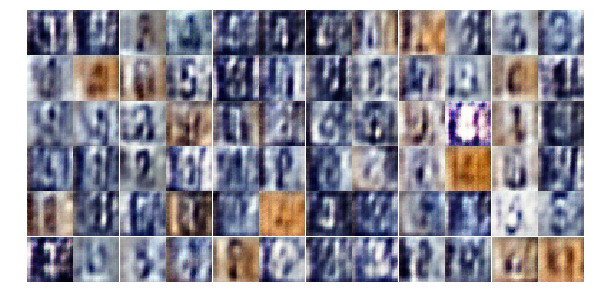

Epoch 2/25... Discriminator Loss: 0.9021... Generator Loss: 1.6509
Epoch 2/25... Discriminator Loss: 0.7431... Generator Loss: 1.0829
Epoch 2/25... Discriminator Loss: 0.7925... Generator Loss: 1.2862
Epoch 2/25... Discriminator Loss: 0.9260... Generator Loss: 1.2666
Epoch 2/25... Discriminator Loss: 0.9791... Generator Loss: 1.2596
Epoch 2/25... Discriminator Loss: 1.0234... Generator Loss: 1.0225
Epoch 2/25... Discriminator Loss: 0.7640... Generator Loss: 1.3106
Epoch 2/25... Discriminator Loss: 0.7557... Generator Loss: 1.2919
Epoch 2/25... Discriminator Loss: 0.7673... Generator Loss: 1.0476
Epoch 2/25... Discriminator Loss: 0.7699... Generator Loss: 1.1997


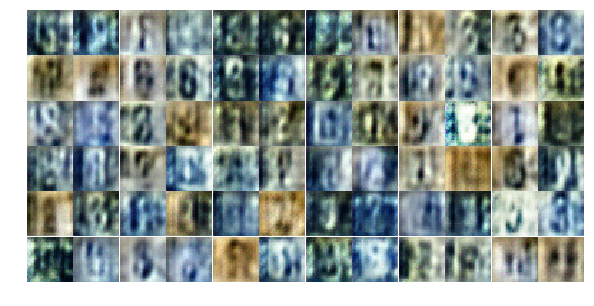

Epoch 2/25... Discriminator Loss: 0.8230... Generator Loss: 1.2246
Epoch 2/25... Discriminator Loss: 1.2919... Generator Loss: 2.1857
Epoch 2/25... Discriminator Loss: 0.7769... Generator Loss: 1.0028
Epoch 2/25... Discriminator Loss: 0.8133... Generator Loss: 1.3869
Epoch 2/25... Discriminator Loss: 1.0470... Generator Loss: 1.3994
Epoch 2/25... Discriminator Loss: 1.2742... Generator Loss: 0.8287
Epoch 2/25... Discriminator Loss: 1.2082... Generator Loss: 0.6328
Epoch 2/25... Discriminator Loss: 1.1362... Generator Loss: 1.1468
Epoch 2/25... Discriminator Loss: 1.0615... Generator Loss: 1.2392
Epoch 2/25... Discriminator Loss: 1.4500... Generator Loss: 0.6374


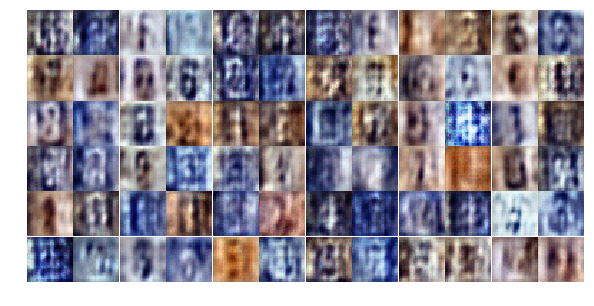

Epoch 2/25... Discriminator Loss: 1.1795... Generator Loss: 0.6649
Epoch 2/25... Discriminator Loss: 0.9515... Generator Loss: 1.1684
Epoch 2/25... Discriminator Loss: 0.9188... Generator Loss: 1.1421
Epoch 2/25... Discriminator Loss: 0.9305... Generator Loss: 1.4036
Epoch 2/25... Discriminator Loss: 0.8240... Generator Loss: 1.2610
Epoch 2/25... Discriminator Loss: 0.8679... Generator Loss: 1.0941
Epoch 2/25... Discriminator Loss: 1.1205... Generator Loss: 0.6477
Epoch 2/25... Discriminator Loss: 1.2278... Generator Loss: 0.5685
Epoch 2/25... Discriminator Loss: 1.0523... Generator Loss: 0.9716
Epoch 2/25... Discriminator Loss: 0.8572... Generator Loss: 1.1670


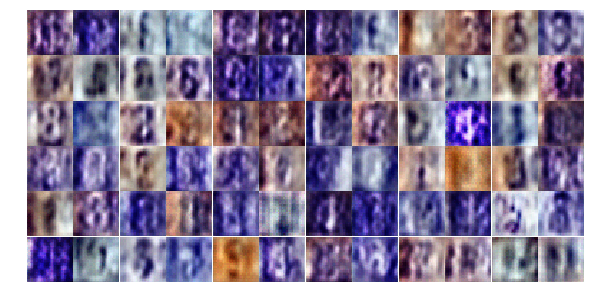

Epoch 2/25... Discriminator Loss: 1.0900... Generator Loss: 0.8906
Epoch 2/25... Discriminator Loss: 1.0515... Generator Loss: 1.0055
Epoch 2/25... Discriminator Loss: 1.0662... Generator Loss: 0.8652
Epoch 2/25... Discriminator Loss: 1.2411... Generator Loss: 0.7312
Epoch 2/25... Discriminator Loss: 0.8782... Generator Loss: 1.7734
Epoch 2/25... Discriminator Loss: 1.1787... Generator Loss: 1.0063
Epoch 2/25... Discriminator Loss: 1.0134... Generator Loss: 1.1007
Epoch 2/25... Discriminator Loss: 1.1269... Generator Loss: 1.2915
Epoch 2/25... Discriminator Loss: 1.2614... Generator Loss: 0.8153
Epoch 2/25... Discriminator Loss: 1.0108... Generator Loss: 1.6560


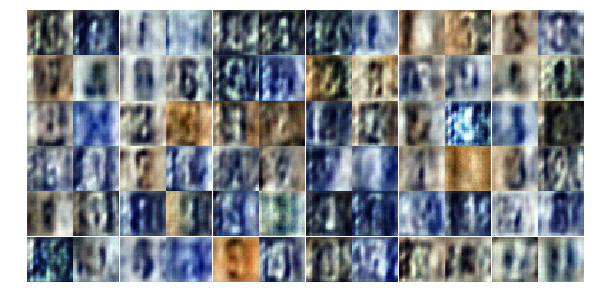

Epoch 2/25... Discriminator Loss: 0.7908... Generator Loss: 1.2013
Epoch 2/25... Discriminator Loss: 1.2197... Generator Loss: 0.7823
Epoch 2/25... Discriminator Loss: 0.6219... Generator Loss: 1.2366
Epoch 2/25... Discriminator Loss: 0.9902... Generator Loss: 1.2297
Epoch 2/25... Discriminator Loss: 0.8197... Generator Loss: 1.0233
Epoch 2/25... Discriminator Loss: 1.1038... Generator Loss: 0.8349
Epoch 2/25... Discriminator Loss: 0.6494... Generator Loss: 1.1869
Epoch 2/25... Discriminator Loss: 1.0025... Generator Loss: 2.6712
Epoch 2/25... Discriminator Loss: 0.7430... Generator Loss: 1.1995
Epoch 2/25... Discriminator Loss: 0.8145... Generator Loss: 0.8793


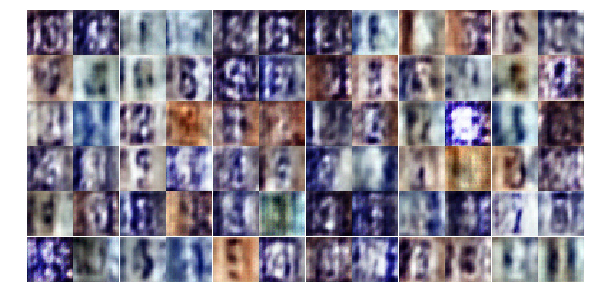

Epoch 2/25... Discriminator Loss: 1.1818... Generator Loss: 0.5130
Epoch 2/25... Discriminator Loss: 0.7674... Generator Loss: 1.3065
Epoch 2/25... Discriminator Loss: 1.4018... Generator Loss: 0.4099
Epoch 2/25... Discriminator Loss: 0.8818... Generator Loss: 1.1828
Epoch 3/25... Discriminator Loss: 0.4691... Generator Loss: 2.9711
Epoch 3/25... Discriminator Loss: 0.8270... Generator Loss: 1.1961
Epoch 3/25... Discriminator Loss: 0.8771... Generator Loss: 2.1908
Epoch 3/25... Discriminator Loss: 0.6120... Generator Loss: 1.5945
Epoch 3/25... Discriminator Loss: 0.7246... Generator Loss: 1.4326
Epoch 3/25... Discriminator Loss: 1.0583... Generator Loss: 0.8072


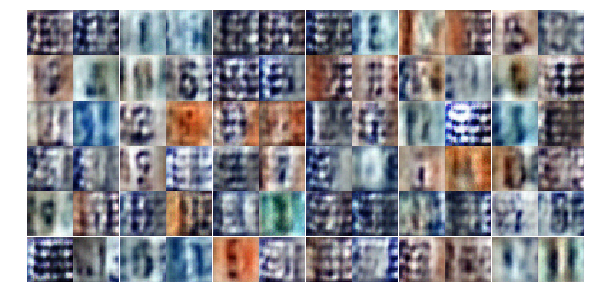

Epoch 3/25... Discriminator Loss: 0.4624... Generator Loss: 1.6567
Epoch 3/25... Discriminator Loss: 0.5467... Generator Loss: 1.3196
Epoch 3/25... Discriminator Loss: 0.8084... Generator Loss: 1.1175
Epoch 3/25... Discriminator Loss: 0.9877... Generator Loss: 1.0194
Epoch 3/25... Discriminator Loss: 0.9690... Generator Loss: 2.1325
Epoch 3/25... Discriminator Loss: 1.0004... Generator Loss: 0.7778
Epoch 3/25... Discriminator Loss: 0.7408... Generator Loss: 1.6340
Epoch 3/25... Discriminator Loss: 0.6187... Generator Loss: 1.3036
Epoch 3/25... Discriminator Loss: 0.4535... Generator Loss: 1.5661
Epoch 3/25... Discriminator Loss: 1.6037... Generator Loss: 3.8596


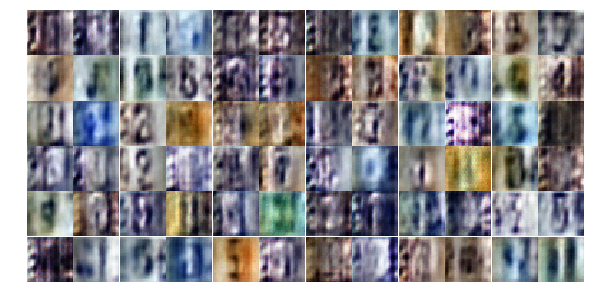

Epoch 3/25... Discriminator Loss: 0.8836... Generator Loss: 1.2875
Epoch 3/25... Discriminator Loss: 0.7033... Generator Loss: 2.1084
Epoch 3/25... Discriminator Loss: 0.6980... Generator Loss: 1.0209
Epoch 3/25... Discriminator Loss: 0.4536... Generator Loss: 1.6838
Epoch 3/25... Discriminator Loss: 0.8496... Generator Loss: 1.0996
Epoch 3/25... Discriminator Loss: 0.8796... Generator Loss: 1.0403
Epoch 3/25... Discriminator Loss: 0.8371... Generator Loss: 0.9033
Epoch 3/25... Discriminator Loss: 0.7887... Generator Loss: 2.4092
Epoch 3/25... Discriminator Loss: 0.4351... Generator Loss: 1.9047
Epoch 3/25... Discriminator Loss: 0.6218... Generator Loss: 1.2162


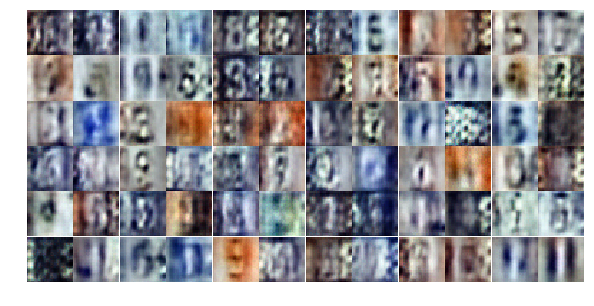

Epoch 3/25... Discriminator Loss: 0.6360... Generator Loss: 1.7601
Epoch 3/25... Discriminator Loss: 0.4087... Generator Loss: 1.9089
Epoch 3/25... Discriminator Loss: 0.5031... Generator Loss: 1.5055
Epoch 3/25... Discriminator Loss: 0.4510... Generator Loss: 1.4906
Epoch 3/25... Discriminator Loss: 0.8270... Generator Loss: 2.6765
Epoch 3/25... Discriminator Loss: 0.7221... Generator Loss: 1.1126
Epoch 3/25... Discriminator Loss: 1.4907... Generator Loss: 0.3820
Epoch 3/25... Discriminator Loss: 0.3814... Generator Loss: 1.7145
Epoch 3/25... Discriminator Loss: 0.8446... Generator Loss: 0.9780
Epoch 3/25... Discriminator Loss: 0.7573... Generator Loss: 1.0138


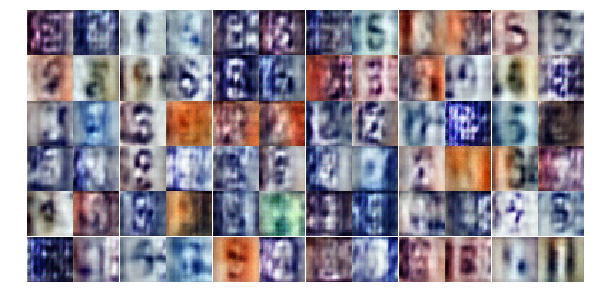

Epoch 3/25... Discriminator Loss: 0.4648... Generator Loss: 1.8503
Epoch 3/25... Discriminator Loss: 0.4168... Generator Loss: 2.1171
Epoch 3/25... Discriminator Loss: 0.4000... Generator Loss: 1.9117
Epoch 3/25... Discriminator Loss: 0.6624... Generator Loss: 1.2158
Epoch 3/25... Discriminator Loss: 1.1480... Generator Loss: 3.0995
Epoch 3/25... Discriminator Loss: 0.9604... Generator Loss: 2.5077
Epoch 3/25... Discriminator Loss: 0.8505... Generator Loss: 0.9217
Epoch 3/25... Discriminator Loss: 0.7640... Generator Loss: 1.0487
Epoch 3/25... Discriminator Loss: 2.1831... Generator Loss: 3.6164
Epoch 3/25... Discriminator Loss: 1.0803... Generator Loss: 2.4509


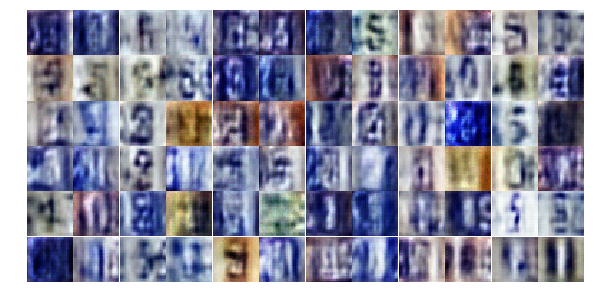

Epoch 3/25... Discriminator Loss: 0.8908... Generator Loss: 1.2137
Epoch 3/25... Discriminator Loss: 1.5659... Generator Loss: 0.3827
Epoch 3/25... Discriminator Loss: 0.5158... Generator Loss: 1.6190
Epoch 3/25... Discriminator Loss: 0.9246... Generator Loss: 0.8960
Epoch 3/25... Discriminator Loss: 0.9545... Generator Loss: 0.7917
Epoch 3/25... Discriminator Loss: 0.6150... Generator Loss: 1.2882
Epoch 3/25... Discriminator Loss: 0.5378... Generator Loss: 1.8361
Epoch 3/25... Discriminator Loss: 0.4625... Generator Loss: 1.8012
Epoch 3/25... Discriminator Loss: 0.6549... Generator Loss: 1.9105
Epoch 3/25... Discriminator Loss: 0.4685... Generator Loss: 1.5559


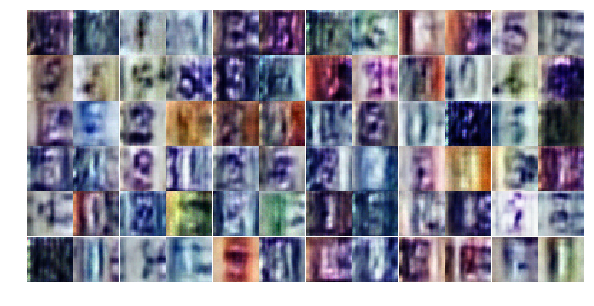

Epoch 3/25... Discriminator Loss: 0.6566... Generator Loss: 1.2959
Epoch 4/25... Discriminator Loss: 0.6799... Generator Loss: 1.1689
Epoch 4/25... Discriminator Loss: 1.1237... Generator Loss: 2.3171
Epoch 4/25... Discriminator Loss: 0.8137... Generator Loss: 0.9187
Epoch 4/25... Discriminator Loss: 0.5748... Generator Loss: 1.8188
Epoch 4/25... Discriminator Loss: 0.6864... Generator Loss: 1.1191
Epoch 4/25... Discriminator Loss: 1.0069... Generator Loss: 2.0484
Epoch 4/25... Discriminator Loss: 0.5750... Generator Loss: 1.4580
Epoch 4/25... Discriminator Loss: 0.4503... Generator Loss: 1.4244
Epoch 4/25... Discriminator Loss: 0.6534... Generator Loss: 1.1720


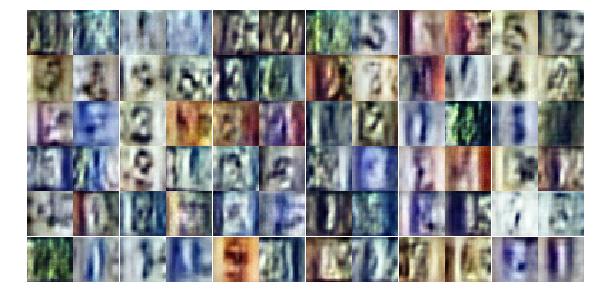

Epoch 4/25... Discriminator Loss: 0.5718... Generator Loss: 1.2612
Epoch 4/25... Discriminator Loss: 0.5278... Generator Loss: 1.2890
Epoch 4/25... Discriminator Loss: 0.9724... Generator Loss: 1.3417
Epoch 4/25... Discriminator Loss: 0.6042... Generator Loss: 1.6646
Epoch 4/25... Discriminator Loss: 0.9502... Generator Loss: 0.7634
Epoch 4/25... Discriminator Loss: 1.3163... Generator Loss: 0.4281
Epoch 4/25... Discriminator Loss: 0.5068... Generator Loss: 1.6506
Epoch 4/25... Discriminator Loss: 0.5441... Generator Loss: 1.4358
Epoch 4/25... Discriminator Loss: 0.7019... Generator Loss: 1.9072
Epoch 4/25... Discriminator Loss: 0.6203... Generator Loss: 1.6102


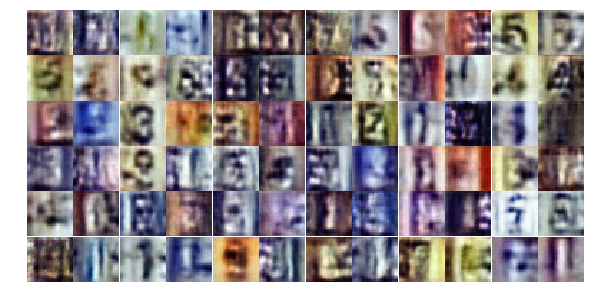

Epoch 4/25... Discriminator Loss: 0.4074... Generator Loss: 1.8912
Epoch 4/25... Discriminator Loss: 0.4372... Generator Loss: 1.6470
Epoch 4/25... Discriminator Loss: 0.4797... Generator Loss: 1.4557
Epoch 4/25... Discriminator Loss: 0.7665... Generator Loss: 0.9225
Epoch 4/25... Discriminator Loss: 0.3672... Generator Loss: 3.0813
Epoch 4/25... Discriminator Loss: 0.6677... Generator Loss: 2.5376
Epoch 4/25... Discriminator Loss: 0.8897... Generator Loss: 0.7178
Epoch 4/25... Discriminator Loss: 0.6698... Generator Loss: 1.2852
Epoch 4/25... Discriminator Loss: 0.6698... Generator Loss: 1.3957
Epoch 4/25... Discriminator Loss: 0.5474... Generator Loss: 1.3122


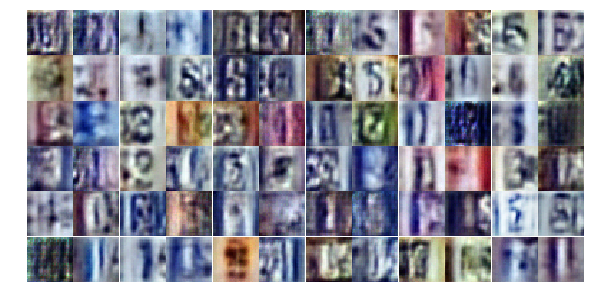

Epoch 4/25... Discriminator Loss: 0.4533... Generator Loss: 1.5671
Epoch 4/25... Discriminator Loss: 0.5045... Generator Loss: 1.5441
Epoch 4/25... Discriminator Loss: 0.6066... Generator Loss: 1.0820
Epoch 4/25... Discriminator Loss: 0.7340... Generator Loss: 3.8203
Epoch 4/25... Discriminator Loss: 0.4908... Generator Loss: 1.5795
Epoch 4/25... Discriminator Loss: 0.6183... Generator Loss: 1.4959
Epoch 4/25... Discriminator Loss: 0.5403... Generator Loss: 1.4017
Epoch 4/25... Discriminator Loss: 0.7017... Generator Loss: 1.0241
Epoch 4/25... Discriminator Loss: 0.5991... Generator Loss: 1.7082
Epoch 4/25... Discriminator Loss: 0.6097... Generator Loss: 1.0138


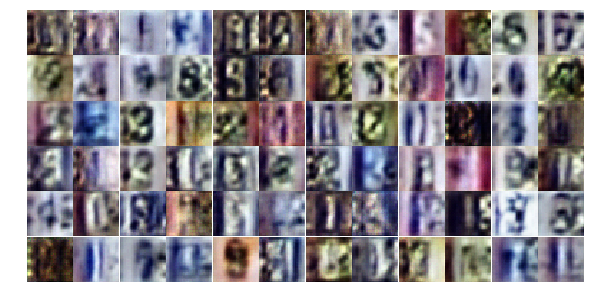

Epoch 4/25... Discriminator Loss: 0.4756... Generator Loss: 1.3927
Epoch 4/25... Discriminator Loss: 0.2917... Generator Loss: 1.8080
Epoch 4/25... Discriminator Loss: 0.5961... Generator Loss: 1.0794
Epoch 4/25... Discriminator Loss: 0.5026... Generator Loss: 2.3115
Epoch 4/25... Discriminator Loss: 0.5455... Generator Loss: 1.2641
Epoch 4/25... Discriminator Loss: 0.9696... Generator Loss: 0.8562
Epoch 4/25... Discriminator Loss: 1.3130... Generator Loss: 0.4616
Epoch 4/25... Discriminator Loss: 0.8925... Generator Loss: 2.0062
Epoch 4/25... Discriminator Loss: 0.9696... Generator Loss: 0.6772
Epoch 4/25... Discriminator Loss: 0.4982... Generator Loss: 1.6420


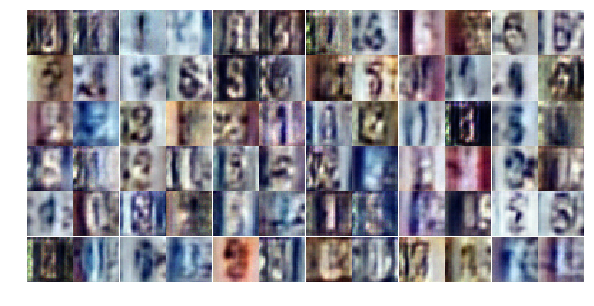

Epoch 4/25... Discriminator Loss: 0.5277... Generator Loss: 1.4527
Epoch 4/25... Discriminator Loss: 0.3795... Generator Loss: 2.5863
Epoch 4/25... Discriminator Loss: 0.3448... Generator Loss: 1.7257
Epoch 4/25... Discriminator Loss: 0.6996... Generator Loss: 2.3879
Epoch 4/25... Discriminator Loss: 1.1085... Generator Loss: 0.6294
Epoch 4/25... Discriminator Loss: 0.6026... Generator Loss: 1.4543
Epoch 4/25... Discriminator Loss: 0.6478... Generator Loss: 1.2557
Epoch 4/25... Discriminator Loss: 0.5573... Generator Loss: 1.6013
Epoch 4/25... Discriminator Loss: 0.6110... Generator Loss: 1.1781
Epoch 5/25... Discriminator Loss: 0.4439... Generator Loss: 2.1228


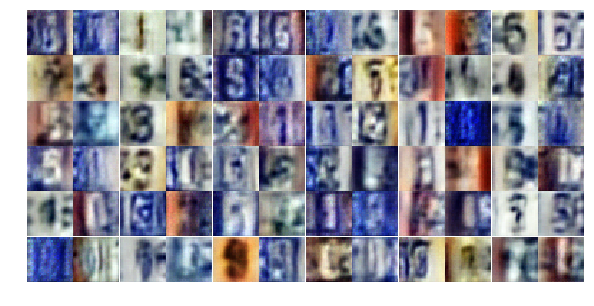

Epoch 5/25... Discriminator Loss: 0.3800... Generator Loss: 2.1372
Epoch 5/25... Discriminator Loss: 0.5307... Generator Loss: 1.4739
Epoch 5/25... Discriminator Loss: 0.8828... Generator Loss: 0.7396
Epoch 5/25... Discriminator Loss: 1.2524... Generator Loss: 0.4466
Epoch 5/25... Discriminator Loss: 0.4070... Generator Loss: 2.0024
Epoch 5/25... Discriminator Loss: 0.7752... Generator Loss: 0.9250
Epoch 5/25... Discriminator Loss: 0.4918... Generator Loss: 1.4165
Epoch 5/25... Discriminator Loss: 0.5375... Generator Loss: 1.2627
Epoch 5/25... Discriminator Loss: 0.4924... Generator Loss: 1.4499
Epoch 5/25... Discriminator Loss: 0.6974... Generator Loss: 1.1158


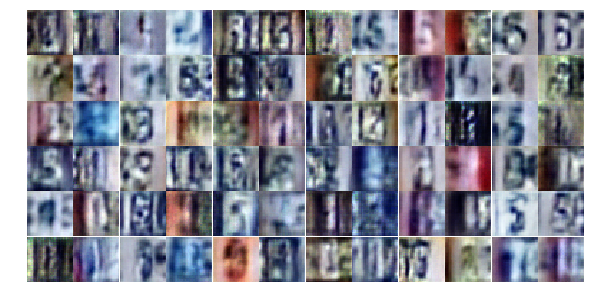

Epoch 5/25... Discriminator Loss: 0.5355... Generator Loss: 1.3367
Epoch 5/25... Discriminator Loss: 0.4091... Generator Loss: 1.8001
Epoch 5/25... Discriminator Loss: 0.4415... Generator Loss: 1.6908
Epoch 5/25... Discriminator Loss: 1.8569... Generator Loss: 0.2553
Epoch 5/25... Discriminator Loss: 0.8421... Generator Loss: 1.3596
Epoch 5/25... Discriminator Loss: 0.7155... Generator Loss: 1.0680
Epoch 5/25... Discriminator Loss: 0.5381... Generator Loss: 1.2511
Epoch 5/25... Discriminator Loss: 0.6564... Generator Loss: 1.0400
Epoch 5/25... Discriminator Loss: 0.4064... Generator Loss: 2.2774
Epoch 5/25... Discriminator Loss: 0.5297... Generator Loss: 1.2445


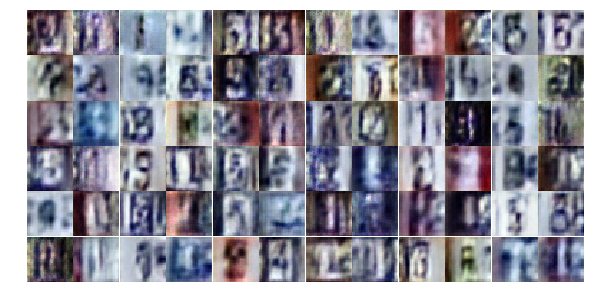

Epoch 5/25... Discriminator Loss: 0.5815... Generator Loss: 1.9325
Epoch 5/25... Discriminator Loss: 1.2606... Generator Loss: 0.5887
Epoch 5/25... Discriminator Loss: 0.7668... Generator Loss: 0.9377
Epoch 5/25... Discriminator Loss: 0.7277... Generator Loss: 0.9078
Epoch 5/25... Discriminator Loss: 1.2387... Generator Loss: 0.4858
Epoch 5/25... Discriminator Loss: 0.6889... Generator Loss: 0.9500
Epoch 5/25... Discriminator Loss: 0.8286... Generator Loss: 0.8234
Epoch 5/25... Discriminator Loss: 1.3541... Generator Loss: 0.4535
Epoch 5/25... Discriminator Loss: 0.5194... Generator Loss: 1.5307
Epoch 5/25... Discriminator Loss: 0.7537... Generator Loss: 0.9733


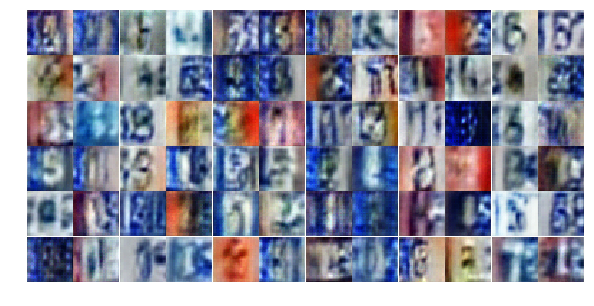

Epoch 5/25... Discriminator Loss: 0.6711... Generator Loss: 1.2880
Epoch 5/25... Discriminator Loss: 0.7976... Generator Loss: 2.3970
Epoch 5/25... Discriminator Loss: 0.5945... Generator Loss: 1.4290
Epoch 5/25... Discriminator Loss: 0.5784... Generator Loss: 1.1811
Epoch 5/25... Discriminator Loss: 0.6876... Generator Loss: 2.3585
Epoch 5/25... Discriminator Loss: 0.4509... Generator Loss: 1.5383
Epoch 5/25... Discriminator Loss: 0.8392... Generator Loss: 0.8405
Epoch 5/25... Discriminator Loss: 0.5446... Generator Loss: 1.2557
Epoch 5/25... Discriminator Loss: 0.6532... Generator Loss: 1.0908
Epoch 5/25... Discriminator Loss: 0.5462... Generator Loss: 1.1865


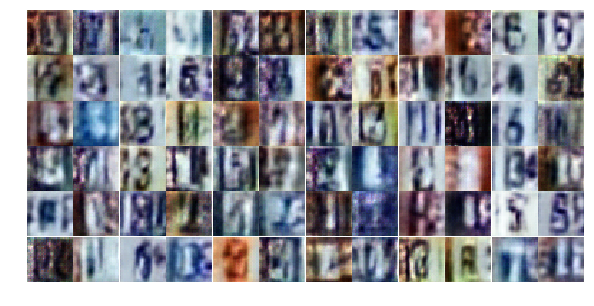

Epoch 5/25... Discriminator Loss: 0.4494... Generator Loss: 1.6514
Epoch 5/25... Discriminator Loss: 0.7749... Generator Loss: 0.8586
Epoch 5/25... Discriminator Loss: 0.6903... Generator Loss: 1.2093
Epoch 5/25... Discriminator Loss: 1.4538... Generator Loss: 0.4087
Epoch 5/25... Discriminator Loss: 0.8581... Generator Loss: 1.5236
Epoch 5/25... Discriminator Loss: 0.8877... Generator Loss: 1.4651
Epoch 5/25... Discriminator Loss: 0.5718... Generator Loss: 1.4300
Epoch 5/25... Discriminator Loss: 0.5900... Generator Loss: 1.7597
Epoch 5/25... Discriminator Loss: 1.2814... Generator Loss: 0.4654
Epoch 5/25... Discriminator Loss: 1.0796... Generator Loss: 2.5173


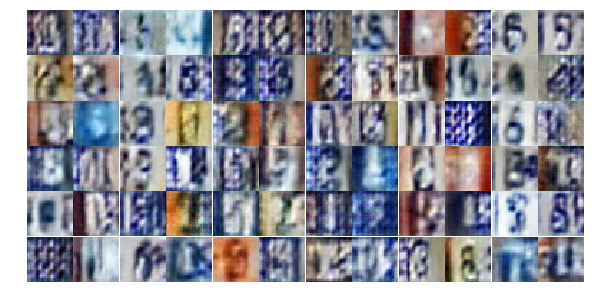

Epoch 5/25... Discriminator Loss: 0.9373... Generator Loss: 0.7083
Epoch 5/25... Discriminator Loss: 0.8301... Generator Loss: 1.1457
Epoch 5/25... Discriminator Loss: 1.4163... Generator Loss: 0.4170
Epoch 5/25... Discriminator Loss: 0.7809... Generator Loss: 0.8334
Epoch 5/25... Discriminator Loss: 0.6504... Generator Loss: 1.2688
Epoch 5/25... Discriminator Loss: 0.9443... Generator Loss: 0.7647
Epoch 6/25... Discriminator Loss: 0.7435... Generator Loss: 0.8859
Epoch 6/25... Discriminator Loss: 0.6580... Generator Loss: 1.0825
Epoch 6/25... Discriminator Loss: 0.7943... Generator Loss: 0.8820
Epoch 6/25... Discriminator Loss: 1.2673... Generator Loss: 0.4253


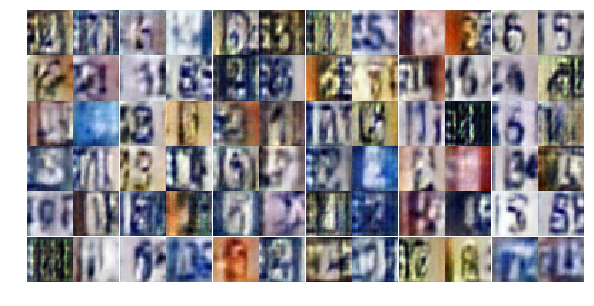

Epoch 6/25... Discriminator Loss: 0.5464... Generator Loss: 1.2547
Epoch 6/25... Discriminator Loss: 0.5566... Generator Loss: 1.4840
Epoch 6/25... Discriminator Loss: 0.5001... Generator Loss: 1.7266
Epoch 6/25... Discriminator Loss: 0.8512... Generator Loss: 1.0938
Epoch 6/25... Discriminator Loss: 0.9729... Generator Loss: 0.6783
Epoch 6/25... Discriminator Loss: 0.9219... Generator Loss: 0.6818
Epoch 6/25... Discriminator Loss: 0.9516... Generator Loss: 2.3229
Epoch 6/25... Discriminator Loss: 0.6891... Generator Loss: 0.9989
Epoch 6/25... Discriminator Loss: 0.5867... Generator Loss: 1.1938
Epoch 6/25... Discriminator Loss: 0.9652... Generator Loss: 0.7382


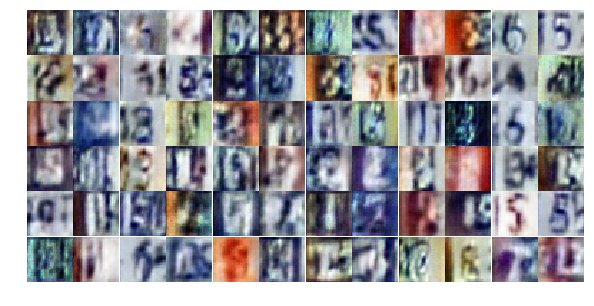

Epoch 6/25... Discriminator Loss: 0.5627... Generator Loss: 2.2243
Epoch 6/25... Discriminator Loss: 0.7621... Generator Loss: 1.0489
Epoch 6/25... Discriminator Loss: 1.2276... Generator Loss: 0.4692
Epoch 6/25... Discriminator Loss: 0.7858... Generator Loss: 0.8232
Epoch 6/25... Discriminator Loss: 0.3596... Generator Loss: 2.0446
Epoch 6/25... Discriminator Loss: 0.5246... Generator Loss: 1.4720
Epoch 6/25... Discriminator Loss: 0.6496... Generator Loss: 1.8549
Epoch 6/25... Discriminator Loss: 0.6808... Generator Loss: 1.1039
Epoch 6/25... Discriminator Loss: 0.6455... Generator Loss: 1.5709
Epoch 6/25... Discriminator Loss: 0.6307... Generator Loss: 1.5659


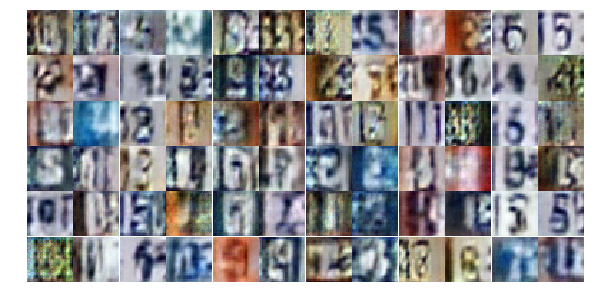

Epoch 6/25... Discriminator Loss: 1.0666... Generator Loss: 0.5861
Epoch 6/25... Discriminator Loss: 0.5655... Generator Loss: 1.1890
Epoch 6/25... Discriminator Loss: 0.9525... Generator Loss: 0.7178
Epoch 6/25... Discriminator Loss: 0.9468... Generator Loss: 0.6991
Epoch 6/25... Discriminator Loss: 0.6368... Generator Loss: 3.2951
Epoch 6/25... Discriminator Loss: 1.6787... Generator Loss: 0.4124
Epoch 6/25... Discriminator Loss: 0.6894... Generator Loss: 1.0760
Epoch 6/25... Discriminator Loss: 0.5982... Generator Loss: 1.0917
Epoch 6/25... Discriminator Loss: 0.5844... Generator Loss: 1.3483
Epoch 6/25... Discriminator Loss: 0.5201... Generator Loss: 1.3815


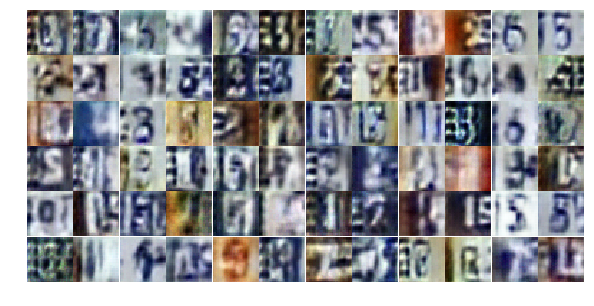

Epoch 6/25... Discriminator Loss: 0.7984... Generator Loss: 0.8814
Epoch 6/25... Discriminator Loss: 0.5951... Generator Loss: 1.8862
Epoch 6/25... Discriminator Loss: 0.6956... Generator Loss: 0.9681
Epoch 6/25... Discriminator Loss: 0.8750... Generator Loss: 0.8498
Epoch 6/25... Discriminator Loss: 0.6748... Generator Loss: 1.0602
Epoch 6/25... Discriminator Loss: 0.4488... Generator Loss: 1.7914
Epoch 6/25... Discriminator Loss: 0.5164... Generator Loss: 1.4004
Epoch 6/25... Discriminator Loss: 0.4485... Generator Loss: 1.4898
Epoch 6/25... Discriminator Loss: 0.6303... Generator Loss: 1.2288
Epoch 6/25... Discriminator Loss: 0.2733... Generator Loss: 1.8283


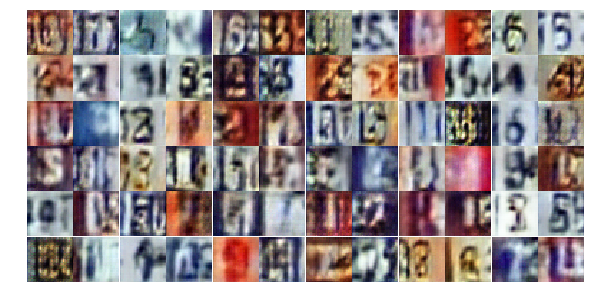

Epoch 6/25... Discriminator Loss: 2.2189... Generator Loss: 4.8407
Epoch 6/25... Discriminator Loss: 0.7748... Generator Loss: 1.1765
Epoch 6/25... Discriminator Loss: 0.6034... Generator Loss: 1.5963
Epoch 6/25... Discriminator Loss: 0.5976... Generator Loss: 1.9710
Epoch 6/25... Discriminator Loss: 0.7518... Generator Loss: 2.6476
Epoch 6/25... Discriminator Loss: 0.6990... Generator Loss: 1.2766
Epoch 6/25... Discriminator Loss: 0.7759... Generator Loss: 1.0221
Epoch 6/25... Discriminator Loss: 1.0739... Generator Loss: 0.6181
Epoch 6/25... Discriminator Loss: 0.5247... Generator Loss: 1.3685
Epoch 6/25... Discriminator Loss: 2.1053... Generator Loss: 0.1976


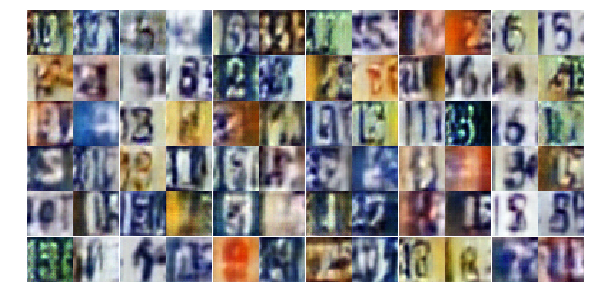

Epoch 6/25... Discriminator Loss: 0.5646... Generator Loss: 2.0897
Epoch 6/25... Discriminator Loss: 0.4136... Generator Loss: 1.8730
Epoch 6/25... Discriminator Loss: 0.5656... Generator Loss: 1.2617
Epoch 7/25... Discriminator Loss: 0.5924... Generator Loss: 1.4800
Epoch 7/25... Discriminator Loss: 0.6412... Generator Loss: 1.0565
Epoch 7/25... Discriminator Loss: 0.5610... Generator Loss: 1.3654
Epoch 7/25... Discriminator Loss: 0.7658... Generator Loss: 0.8688
Epoch 7/25... Discriminator Loss: 0.4100... Generator Loss: 2.0493
Epoch 7/25... Discriminator Loss: 0.4871... Generator Loss: 1.7236
Epoch 7/25... Discriminator Loss: 0.8238... Generator Loss: 0.8383


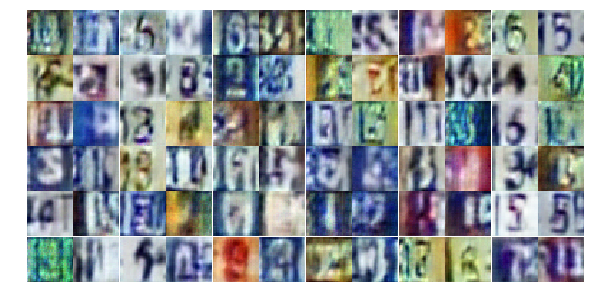

Epoch 7/25... Discriminator Loss: 0.8233... Generator Loss: 0.8301
Epoch 7/25... Discriminator Loss: 0.8949... Generator Loss: 0.7572
Epoch 7/25... Discriminator Loss: 0.8608... Generator Loss: 0.8098
Epoch 7/25... Discriminator Loss: 0.5370... Generator Loss: 1.6147
Epoch 7/25... Discriminator Loss: 0.7721... Generator Loss: 0.8607
Epoch 7/25... Discriminator Loss: 0.3292... Generator Loss: 2.0341
Epoch 7/25... Discriminator Loss: 0.7361... Generator Loss: 1.8101
Epoch 7/25... Discriminator Loss: 1.5939... Generator Loss: 4.0424
Epoch 7/25... Discriminator Loss: 0.6614... Generator Loss: 2.1615
Epoch 7/25... Discriminator Loss: 0.8491... Generator Loss: 1.3366


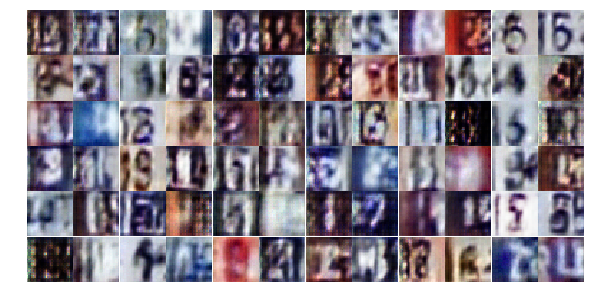

Epoch 7/25... Discriminator Loss: 0.6059... Generator Loss: 1.4926
Epoch 7/25... Discriminator Loss: 0.5509... Generator Loss: 1.4594
Epoch 7/25... Discriminator Loss: 0.7222... Generator Loss: 0.9362
Epoch 7/25... Discriminator Loss: 0.5238... Generator Loss: 1.5415
Epoch 7/25... Discriminator Loss: 0.5351... Generator Loss: 1.3494
Epoch 7/25... Discriminator Loss: 0.4697... Generator Loss: 1.3755
Epoch 7/25... Discriminator Loss: 0.4842... Generator Loss: 1.7983
Epoch 7/25... Discriminator Loss: 1.1693... Generator Loss: 0.5414
Epoch 7/25... Discriminator Loss: 0.3516... Generator Loss: 1.9872
Epoch 7/25... Discriminator Loss: 0.4655... Generator Loss: 1.6543


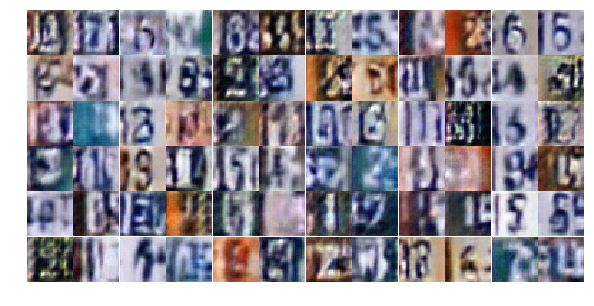

Epoch 7/25... Discriminator Loss: 1.1798... Generator Loss: 0.5492
Epoch 7/25... Discriminator Loss: 1.9966... Generator Loss: 0.2019
Epoch 7/25... Discriminator Loss: 0.6984... Generator Loss: 1.1011
Epoch 7/25... Discriminator Loss: 1.0031... Generator Loss: 0.6677
Epoch 7/25... Discriminator Loss: 0.7182... Generator Loss: 0.9313
Epoch 7/25... Discriminator Loss: 0.6166... Generator Loss: 1.1589
Epoch 7/25... Discriminator Loss: 0.6705... Generator Loss: 1.0896
Epoch 7/25... Discriminator Loss: 0.5908... Generator Loss: 1.2359
Epoch 7/25... Discriminator Loss: 0.7209... Generator Loss: 1.1240
Epoch 7/25... Discriminator Loss: 0.5053... Generator Loss: 1.8602


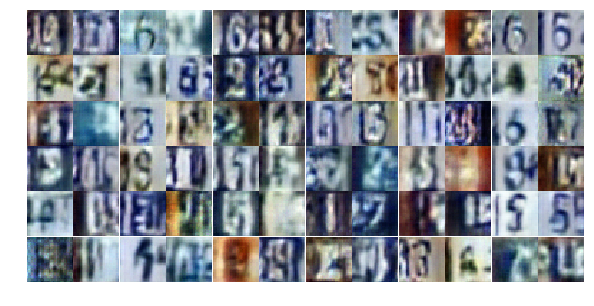

Epoch 7/25... Discriminator Loss: 1.2683... Generator Loss: 0.4774
Epoch 7/25... Discriminator Loss: 0.6690... Generator Loss: 1.4432
Epoch 7/25... Discriminator Loss: 0.4491... Generator Loss: 2.2150
Epoch 7/25... Discriminator Loss: 0.6378... Generator Loss: 1.1513
Epoch 7/25... Discriminator Loss: 0.4825... Generator Loss: 1.4518
Epoch 7/25... Discriminator Loss: 0.4469... Generator Loss: 1.9133
Epoch 7/25... Discriminator Loss: 0.3692... Generator Loss: 1.6773
Epoch 7/25... Discriminator Loss: 1.1329... Generator Loss: 0.5574
Epoch 7/25... Discriminator Loss: 0.4311... Generator Loss: 2.5994
Epoch 7/25... Discriminator Loss: 0.8983... Generator Loss: 0.8433


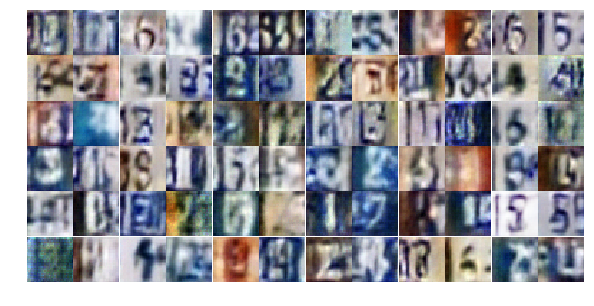

Epoch 7/25... Discriminator Loss: 0.2776... Generator Loss: 1.9899
Epoch 7/25... Discriminator Loss: 1.2377... Generator Loss: 0.4613
Epoch 7/25... Discriminator Loss: 0.8128... Generator Loss: 0.8808
Epoch 7/25... Discriminator Loss: 1.4032... Generator Loss: 0.4060
Epoch 7/25... Discriminator Loss: 0.5902... Generator Loss: 1.4330
Epoch 7/25... Discriminator Loss: 1.4644... Generator Loss: 0.4046
Epoch 7/25... Discriminator Loss: 1.6422... Generator Loss: 0.2796
Epoch 7/25... Discriminator Loss: 0.8155... Generator Loss: 1.8920
Epoch 7/25... Discriminator Loss: 0.7103... Generator Loss: 1.3783
Epoch 7/25... Discriminator Loss: 0.5105... Generator Loss: 1.2568


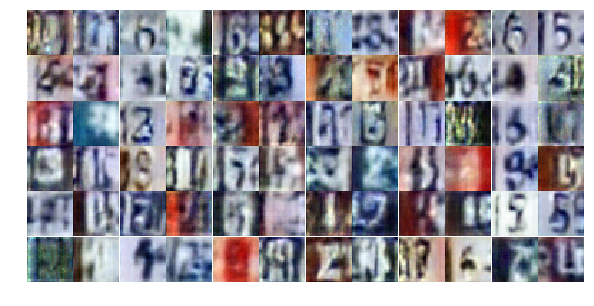

Epoch 7/25... Discriminator Loss: 0.4807... Generator Loss: 1.8093
Epoch 8/25... Discriminator Loss: 0.6248... Generator Loss: 1.1139
Epoch 8/25... Discriminator Loss: 0.7347... Generator Loss: 0.9504
Epoch 8/25... Discriminator Loss: 0.5507... Generator Loss: 1.3082
Epoch 8/25... Discriminator Loss: 0.7181... Generator Loss: 0.9281
Epoch 8/25... Discriminator Loss: 0.8169... Generator Loss: 1.2423
Epoch 8/25... Discriminator Loss: 0.6653... Generator Loss: 1.0140
Epoch 8/25... Discriminator Loss: 0.6697... Generator Loss: 1.9093
Epoch 8/25... Discriminator Loss: 0.9452... Generator Loss: 0.7501
Epoch 8/25... Discriminator Loss: 0.6165... Generator Loss: 1.1259


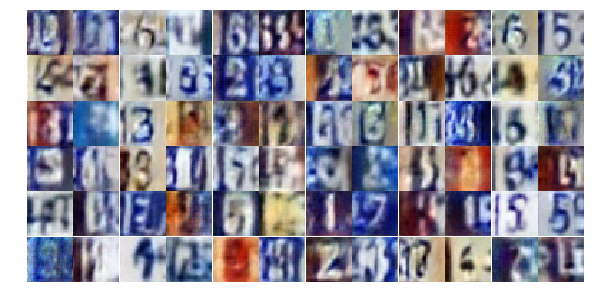

Epoch 8/25... Discriminator Loss: 0.5641... Generator Loss: 1.4092
Epoch 8/25... Discriminator Loss: 0.5116... Generator Loss: 1.2467
Epoch 8/25... Discriminator Loss: 0.6866... Generator Loss: 0.9557
Epoch 8/25... Discriminator Loss: 0.4341... Generator Loss: 1.5533
Epoch 8/25... Discriminator Loss: 0.8213... Generator Loss: 0.8471
Epoch 8/25... Discriminator Loss: 0.9101... Generator Loss: 2.1747
Epoch 8/25... Discriminator Loss: 0.4250... Generator Loss: 1.6861
Epoch 8/25... Discriminator Loss: 0.5505... Generator Loss: 1.6695
Epoch 8/25... Discriminator Loss: 0.7660... Generator Loss: 0.9373
Epoch 8/25... Discriminator Loss: 1.2527... Generator Loss: 0.4710


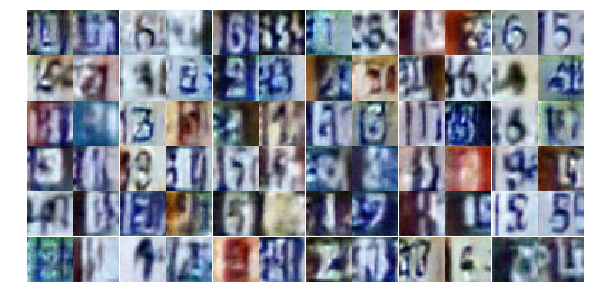

Epoch 8/25... Discriminator Loss: 0.3633... Generator Loss: 1.7593
Epoch 8/25... Discriminator Loss: 0.4040... Generator Loss: 1.7729
Epoch 8/25... Discriminator Loss: 0.5492... Generator Loss: 1.1639
Epoch 8/25... Discriminator Loss: 0.7001... Generator Loss: 1.7498
Epoch 8/25... Discriminator Loss: 0.3976... Generator Loss: 2.2340
Epoch 8/25... Discriminator Loss: 0.5256... Generator Loss: 1.3194
Epoch 8/25... Discriminator Loss: 0.6189... Generator Loss: 1.3860
Epoch 8/25... Discriminator Loss: 1.1020... Generator Loss: 0.5012
Epoch 8/25... Discriminator Loss: 1.1520... Generator Loss: 0.8272
Epoch 8/25... Discriminator Loss: 0.6516... Generator Loss: 1.0946


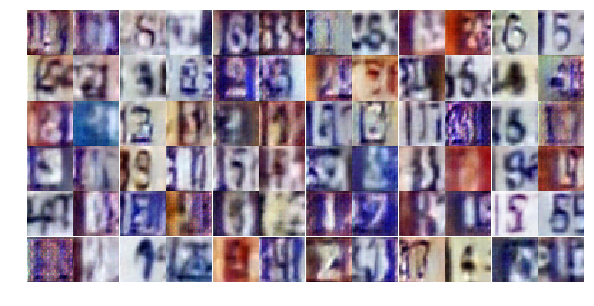

Epoch 8/25... Discriminator Loss: 0.6446... Generator Loss: 1.0940
Epoch 8/25... Discriminator Loss: 0.7452... Generator Loss: 0.9586
Epoch 8/25... Discriminator Loss: 0.6869... Generator Loss: 1.1713
Epoch 8/25... Discriminator Loss: 0.8679... Generator Loss: 0.7428
Epoch 8/25... Discriminator Loss: 0.4175... Generator Loss: 1.5109
Epoch 8/25... Discriminator Loss: 0.5956... Generator Loss: 1.1233
Epoch 8/25... Discriminator Loss: 0.5493... Generator Loss: 1.4353
Epoch 8/25... Discriminator Loss: 0.5573... Generator Loss: 1.2771
Epoch 8/25... Discriminator Loss: 0.5938... Generator Loss: 1.1352
Epoch 8/25... Discriminator Loss: 0.4865... Generator Loss: 1.3504


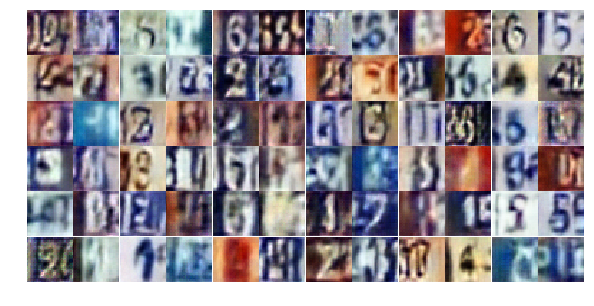

Epoch 8/25... Discriminator Loss: 0.4397... Generator Loss: 2.1813
Epoch 8/25... Discriminator Loss: 0.8778... Generator Loss: 0.8302
Epoch 8/25... Discriminator Loss: 0.5346... Generator Loss: 1.2372
Epoch 8/25... Discriminator Loss: 0.4859... Generator Loss: 1.6294
Epoch 8/25... Discriminator Loss: 1.6112... Generator Loss: 3.2102
Epoch 8/25... Discriminator Loss: 0.6475... Generator Loss: 1.7273
Epoch 8/25... Discriminator Loss: 0.8360... Generator Loss: 0.7090
Epoch 8/25... Discriminator Loss: 0.5081... Generator Loss: 1.4423
Epoch 8/25... Discriminator Loss: 0.5270... Generator Loss: 1.9328
Epoch 8/25... Discriminator Loss: 0.7204... Generator Loss: 1.5222


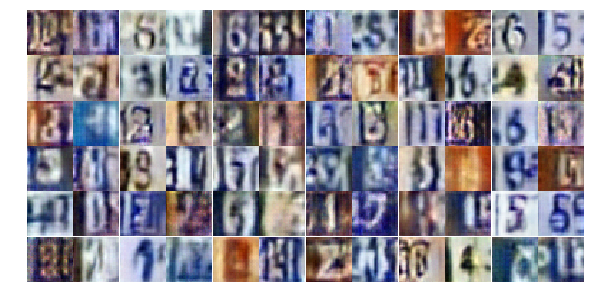

Epoch 8/25... Discriminator Loss: 0.5843... Generator Loss: 1.5003
Epoch 8/25... Discriminator Loss: 0.4084... Generator Loss: 1.6356
Epoch 8/25... Discriminator Loss: 0.5808... Generator Loss: 1.2339
Epoch 8/25... Discriminator Loss: 1.3203... Generator Loss: 0.5570
Epoch 8/25... Discriminator Loss: 0.3726... Generator Loss: 2.1414
Epoch 8/25... Discriminator Loss: 0.6808... Generator Loss: 1.2367
Epoch 8/25... Discriminator Loss: 0.4826... Generator Loss: 1.3053
Epoch 8/25... Discriminator Loss: 0.4553... Generator Loss: 2.6964
Epoch 9/25... Discriminator Loss: 0.7169... Generator Loss: 1.5083
Epoch 9/25... Discriminator Loss: 0.9304... Generator Loss: 0.6446


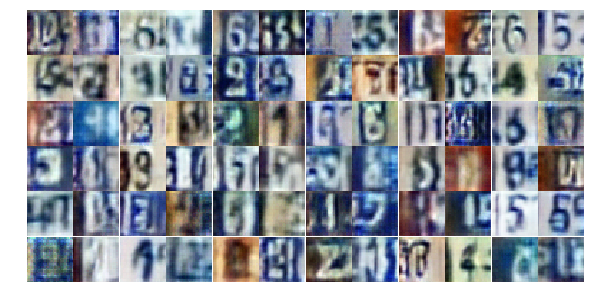

Epoch 9/25... Discriminator Loss: 0.6363... Generator Loss: 1.0631
Epoch 9/25... Discriminator Loss: 0.6717... Generator Loss: 1.0736
Epoch 9/25... Discriminator Loss: 1.0121... Generator Loss: 0.6008
Epoch 9/25... Discriminator Loss: 0.3851... Generator Loss: 1.8624
Epoch 9/25... Discriminator Loss: 1.1885... Generator Loss: 0.5454
Epoch 9/25... Discriminator Loss: 0.5345... Generator Loss: 2.3606
Epoch 9/25... Discriminator Loss: 0.7493... Generator Loss: 2.2309
Epoch 9/25... Discriminator Loss: 0.4971... Generator Loss: 1.3287
Epoch 9/25... Discriminator Loss: 0.8251... Generator Loss: 0.8249
Epoch 9/25... Discriminator Loss: 0.6344... Generator Loss: 1.3663


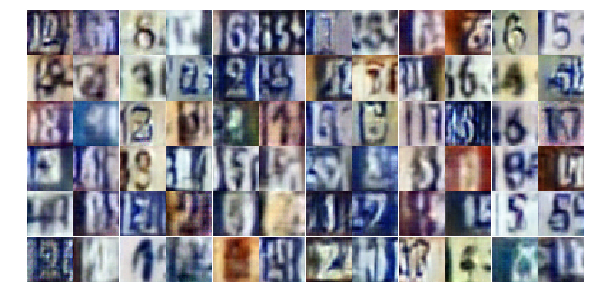

Epoch 9/25... Discriminator Loss: 0.5955... Generator Loss: 1.1281
Epoch 9/25... Discriminator Loss: 0.7574... Generator Loss: 0.9265
Epoch 9/25... Discriminator Loss: 0.9580... Generator Loss: 0.8270
Epoch 9/25... Discriminator Loss: 2.3601... Generator Loss: 0.1847
Epoch 9/25... Discriminator Loss: 0.4896... Generator Loss: 1.6630
Epoch 9/25... Discriminator Loss: 1.1172... Generator Loss: 0.6219
Epoch 9/25... Discriminator Loss: 0.7617... Generator Loss: 1.2000
Epoch 9/25... Discriminator Loss: 0.4170... Generator Loss: 1.5541
Epoch 9/25... Discriminator Loss: 0.8312... Generator Loss: 0.9495
Epoch 9/25... Discriminator Loss: 0.7245... Generator Loss: 1.1130


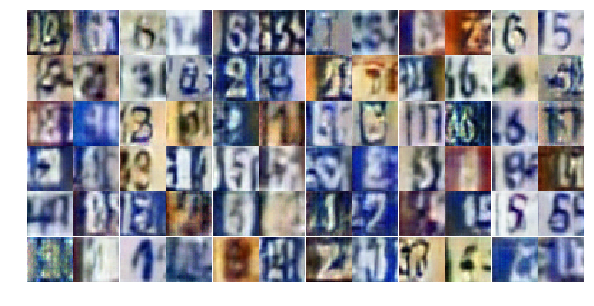

Epoch 9/25... Discriminator Loss: 0.9673... Generator Loss: 0.6906
Epoch 9/25... Discriminator Loss: 0.4284... Generator Loss: 1.5918
Epoch 9/25... Discriminator Loss: 0.7128... Generator Loss: 1.0299
Epoch 9/25... Discriminator Loss: 0.2671... Generator Loss: 2.4433
Epoch 9/25... Discriminator Loss: 0.3430... Generator Loss: 1.7898
Epoch 9/25... Discriminator Loss: 0.5268... Generator Loss: 1.4692
Epoch 9/25... Discriminator Loss: 0.6566... Generator Loss: 1.0327
Epoch 9/25... Discriminator Loss: 0.5963... Generator Loss: 1.5986
Epoch 9/25... Discriminator Loss: 0.5504... Generator Loss: 1.2563
Epoch 9/25... Discriminator Loss: 0.6994... Generator Loss: 0.9035


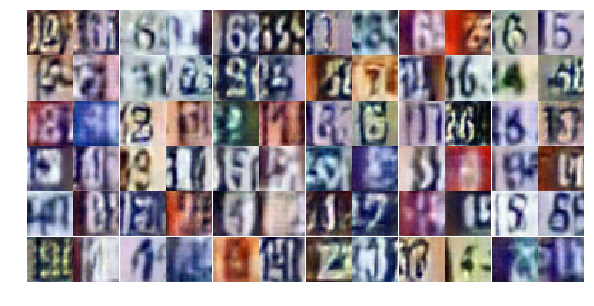

Epoch 9/25... Discriminator Loss: 0.8036... Generator Loss: 0.7845
Epoch 9/25... Discriminator Loss: 0.5619... Generator Loss: 1.1820
Epoch 9/25... Discriminator Loss: 0.8887... Generator Loss: 0.8288
Epoch 9/25... Discriminator Loss: 0.4769... Generator Loss: 1.4866
Epoch 9/25... Discriminator Loss: 0.6189... Generator Loss: 1.1532
Epoch 9/25... Discriminator Loss: 0.5810... Generator Loss: 1.3373
Epoch 9/25... Discriminator Loss: 0.7796... Generator Loss: 3.0449
Epoch 9/25... Discriminator Loss: 0.5048... Generator Loss: 1.2674
Epoch 9/25... Discriminator Loss: 0.9265... Generator Loss: 0.7774
Epoch 9/25... Discriminator Loss: 0.5966... Generator Loss: 1.1251


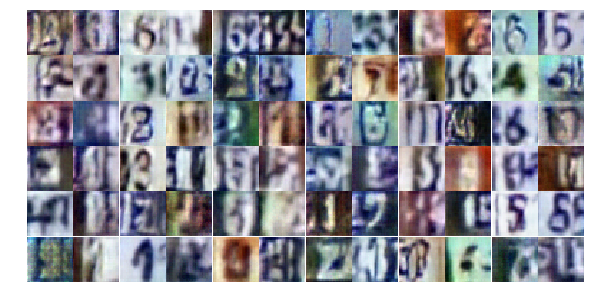

Epoch 9/25... Discriminator Loss: 0.5549... Generator Loss: 1.1651
Epoch 9/25... Discriminator Loss: 0.8407... Generator Loss: 0.7694
Epoch 9/25... Discriminator Loss: 0.8979... Generator Loss: 2.5179
Epoch 9/25... Discriminator Loss: 0.6212... Generator Loss: 1.9994
Epoch 9/25... Discriminator Loss: 0.4488... Generator Loss: 1.3160
Epoch 9/25... Discriminator Loss: 1.1341... Generator Loss: 0.5671
Epoch 9/25... Discriminator Loss: 0.6399... Generator Loss: 1.0800
Epoch 9/25... Discriminator Loss: 1.2868... Generator Loss: 0.4220
Epoch 9/25... Discriminator Loss: 0.5346... Generator Loss: 1.2700
Epoch 9/25... Discriminator Loss: 0.6389... Generator Loss: 1.2250


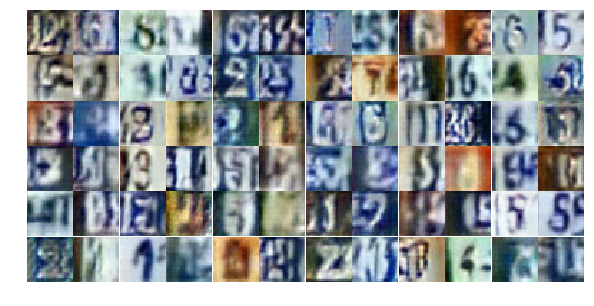

Epoch 9/25... Discriminator Loss: 0.8873... Generator Loss: 0.7764
Epoch 9/25... Discriminator Loss: 1.4356... Generator Loss: 4.3231
Epoch 9/25... Discriminator Loss: 0.7698... Generator Loss: 1.2726
Epoch 9/25... Discriminator Loss: 0.6205... Generator Loss: 1.0536
Epoch 9/25... Discriminator Loss: 0.5262... Generator Loss: 1.3935
Epoch 10/25... Discriminator Loss: 0.6969... Generator Loss: 0.9014
Epoch 10/25... Discriminator Loss: 0.5992... Generator Loss: 1.3752
Epoch 10/25... Discriminator Loss: 0.6913... Generator Loss: 0.9006
Epoch 10/25... Discriminator Loss: 0.6611... Generator Loss: 1.0265
Epoch 10/25... Discriminator Loss: 1.0520... Generator Loss: 0.5703


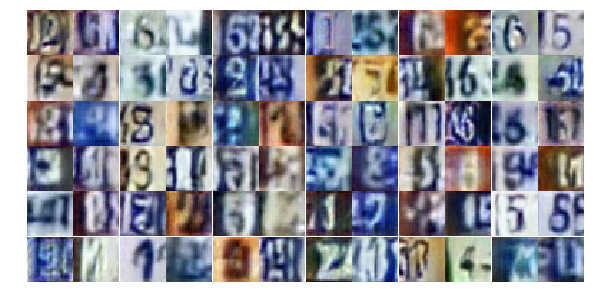

Epoch 10/25... Discriminator Loss: 1.2554... Generator Loss: 0.5214
Epoch 10/25... Discriminator Loss: 0.4066... Generator Loss: 1.9653
Epoch 10/25... Discriminator Loss: 0.7770... Generator Loss: 2.4673
Epoch 10/25... Discriminator Loss: 0.6824... Generator Loss: 1.0541
Epoch 10/25... Discriminator Loss: 0.5307... Generator Loss: 1.6136
Epoch 10/25... Discriminator Loss: 0.7065... Generator Loss: 1.4636
Epoch 10/25... Discriminator Loss: 0.4899... Generator Loss: 1.4540
Epoch 10/25... Discriminator Loss: 1.2817... Generator Loss: 0.5078
Epoch 10/25... Discriminator Loss: 0.8576... Generator Loss: 0.7726
Epoch 10/25... Discriminator Loss: 0.9132... Generator Loss: 0.8368


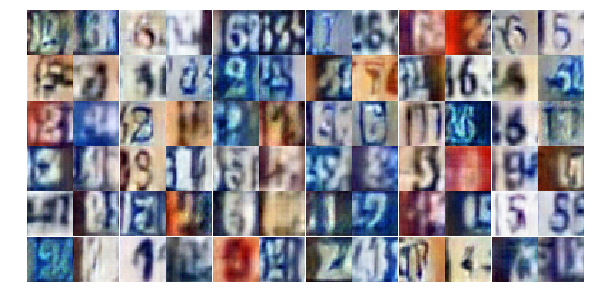

Epoch 10/25... Discriminator Loss: 0.7378... Generator Loss: 1.0963
Epoch 10/25... Discriminator Loss: 0.7006... Generator Loss: 0.9994
Epoch 10/25... Discriminator Loss: 0.4614... Generator Loss: 1.6482
Epoch 10/25... Discriminator Loss: 1.3384... Generator Loss: 0.4289
Epoch 10/25... Discriminator Loss: 0.7930... Generator Loss: 2.1953
Epoch 10/25... Discriminator Loss: 0.6267... Generator Loss: 1.1496
Epoch 10/25... Discriminator Loss: 0.9358... Generator Loss: 0.7242
Epoch 10/25... Discriminator Loss: 0.4587... Generator Loss: 1.4362
Epoch 10/25... Discriminator Loss: 0.5732... Generator Loss: 1.3103
Epoch 10/25... Discriminator Loss: 0.4457... Generator Loss: 2.6358


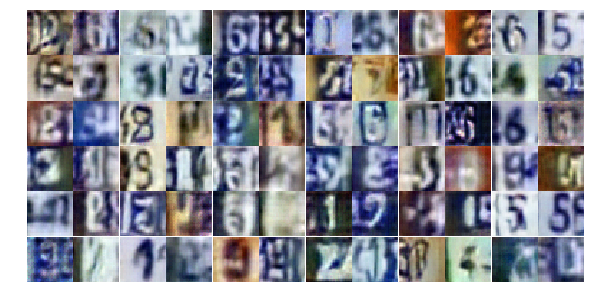

Epoch 10/25... Discriminator Loss: 0.7836... Generator Loss: 0.8110
Epoch 10/25... Discriminator Loss: 1.0057... Generator Loss: 0.6922
Epoch 10/25... Discriminator Loss: 0.4215... Generator Loss: 1.4476
Epoch 10/25... Discriminator Loss: 0.5620... Generator Loss: 1.9436
Epoch 10/25... Discriminator Loss: 1.2518... Generator Loss: 0.4207
Epoch 10/25... Discriminator Loss: 0.5984... Generator Loss: 1.1256
Epoch 10/25... Discriminator Loss: 0.3348... Generator Loss: 1.8220
Epoch 10/25... Discriminator Loss: 0.7209... Generator Loss: 1.3057
Epoch 10/25... Discriminator Loss: 0.9638... Generator Loss: 0.6644
Epoch 10/25... Discriminator Loss: 1.9578... Generator Loss: 3.2743


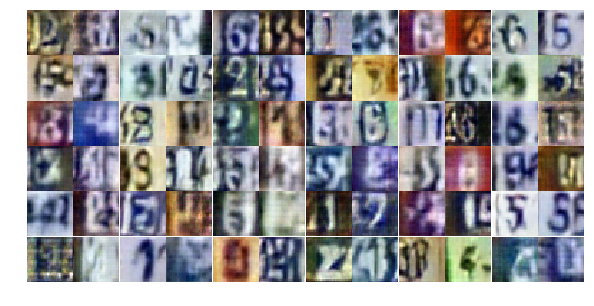

Epoch 10/25... Discriminator Loss: 0.6484... Generator Loss: 1.1802
Epoch 10/25... Discriminator Loss: 0.7069... Generator Loss: 0.9190
Epoch 10/25... Discriminator Loss: 0.5269... Generator Loss: 1.7110
Epoch 10/25... Discriminator Loss: 0.8385... Generator Loss: 0.8884
Epoch 10/25... Discriminator Loss: 0.6511... Generator Loss: 1.0690
Epoch 10/25... Discriminator Loss: 0.7227... Generator Loss: 1.0189
Epoch 10/25... Discriminator Loss: 1.1048... Generator Loss: 0.6071
Epoch 10/25... Discriminator Loss: 1.0398... Generator Loss: 0.6263
Epoch 10/25... Discriminator Loss: 0.6022... Generator Loss: 1.1267
Epoch 10/25... Discriminator Loss: 0.6948... Generator Loss: 1.9223


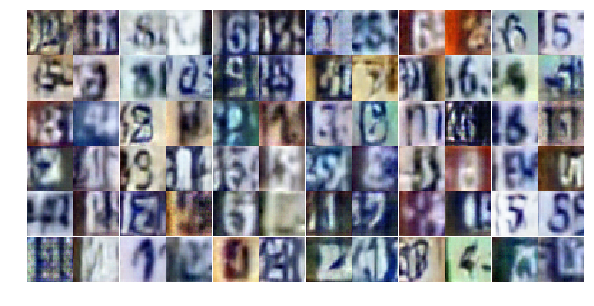

Epoch 10/25... Discriminator Loss: 0.5143... Generator Loss: 1.8231
Epoch 10/25... Discriminator Loss: 0.7609... Generator Loss: 0.9917
Epoch 10/25... Discriminator Loss: 0.5504... Generator Loss: 1.2749
Epoch 10/25... Discriminator Loss: 0.5320... Generator Loss: 1.3909
Epoch 10/25... Discriminator Loss: 0.7613... Generator Loss: 2.5201
Epoch 10/25... Discriminator Loss: 0.5876... Generator Loss: 1.3257
Epoch 10/25... Discriminator Loss: 0.7310... Generator Loss: 0.9878
Epoch 10/25... Discriminator Loss: 0.4976... Generator Loss: 1.9930
Epoch 10/25... Discriminator Loss: 0.8204... Generator Loss: 1.8927
Epoch 10/25... Discriminator Loss: 0.5592... Generator Loss: 1.3524


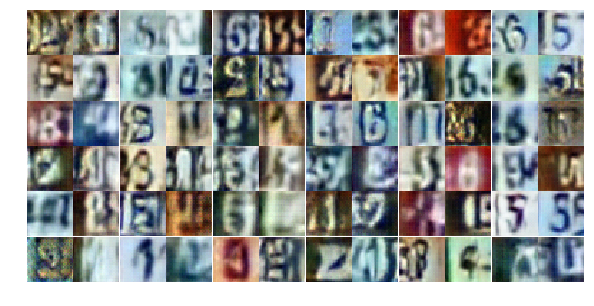

Epoch 10/25... Discriminator Loss: 0.8838... Generator Loss: 0.7380
Epoch 10/25... Discriminator Loss: 0.5659... Generator Loss: 1.2531
Epoch 10/25... Discriminator Loss: 0.5290... Generator Loss: 1.4582
Epoch 11/25... Discriminator Loss: 1.0070... Generator Loss: 0.6875
Epoch 11/25... Discriminator Loss: 0.6853... Generator Loss: 0.9254
Epoch 11/25... Discriminator Loss: 1.2453... Generator Loss: 0.4832
Epoch 11/25... Discriminator Loss: 0.7976... Generator Loss: 0.8286
Epoch 11/25... Discriminator Loss: 0.6534... Generator Loss: 1.5033
Epoch 11/25... Discriminator Loss: 1.5884... Generator Loss: 0.3285
Epoch 11/25... Discriminator Loss: 0.5254... Generator Loss: 1.7815


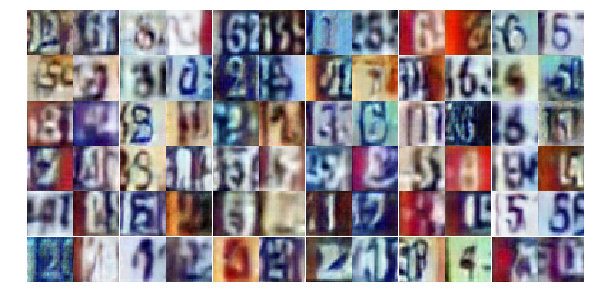

Epoch 11/25... Discriminator Loss: 0.5897... Generator Loss: 1.3719
Epoch 11/25... Discriminator Loss: 0.6494... Generator Loss: 1.0479
Epoch 11/25... Discriminator Loss: 0.5665... Generator Loss: 1.1780
Epoch 11/25... Discriminator Loss: 0.7301... Generator Loss: 0.9189
Epoch 11/25... Discriminator Loss: 0.7886... Generator Loss: 0.9356
Epoch 11/25... Discriminator Loss: 0.4759... Generator Loss: 1.5635
Epoch 11/25... Discriminator Loss: 0.7928... Generator Loss: 0.9123
Epoch 11/25... Discriminator Loss: 0.2846... Generator Loss: 2.5408
Epoch 11/25... Discriminator Loss: 0.9274... Generator Loss: 0.6472
Epoch 11/25... Discriminator Loss: 1.3726... Generator Loss: 0.4597


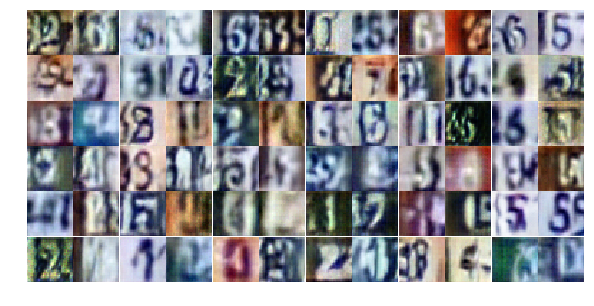

Epoch 11/25... Discriminator Loss: 1.1753... Generator Loss: 0.5403
Epoch 11/25... Discriminator Loss: 0.3500... Generator Loss: 1.8572
Epoch 11/25... Discriminator Loss: 0.9688... Generator Loss: 0.6304
Epoch 11/25... Discriminator Loss: 0.8861... Generator Loss: 0.7299
Epoch 11/25... Discriminator Loss: 0.4851... Generator Loss: 1.5538
Epoch 11/25... Discriminator Loss: 0.3718... Generator Loss: 1.8052
Epoch 11/25... Discriminator Loss: 0.5874... Generator Loss: 1.3069
Epoch 11/25... Discriminator Loss: 1.1523... Generator Loss: 0.5739
Epoch 11/25... Discriminator Loss: 0.4428... Generator Loss: 1.5336
Epoch 11/25... Discriminator Loss: 0.7119... Generator Loss: 0.9961


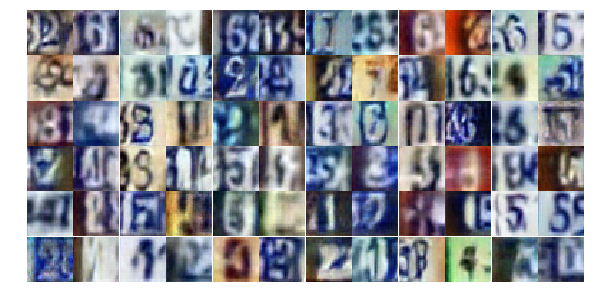

Epoch 11/25... Discriminator Loss: 0.6835... Generator Loss: 1.1236
Epoch 11/25... Discriminator Loss: 0.6892... Generator Loss: 1.3282
Epoch 11/25... Discriminator Loss: 0.8318... Generator Loss: 0.8526
Epoch 11/25... Discriminator Loss: 0.3611... Generator Loss: 1.7243
Epoch 11/25... Discriminator Loss: 0.7862... Generator Loss: 0.7997
Epoch 11/25... Discriminator Loss: 1.7475... Generator Loss: 0.3292
Epoch 11/25... Discriminator Loss: 0.9833... Generator Loss: 2.5938
Epoch 11/25... Discriminator Loss: 0.9745... Generator Loss: 0.6731
Epoch 11/25... Discriminator Loss: 0.5543... Generator Loss: 1.3428
Epoch 11/25... Discriminator Loss: 1.1189... Generator Loss: 0.5618


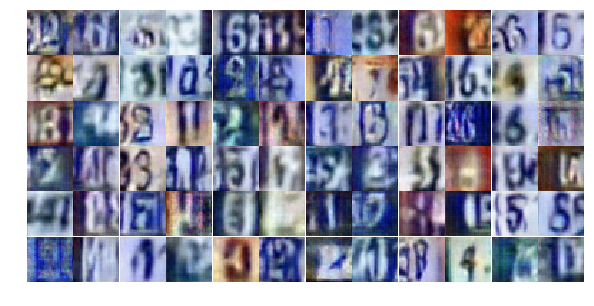

Epoch 11/25... Discriminator Loss: 0.6168... Generator Loss: 1.0877
Epoch 11/25... Discriminator Loss: 0.6508... Generator Loss: 1.0381
Epoch 11/25... Discriminator Loss: 0.5429... Generator Loss: 1.5290
Epoch 11/25... Discriminator Loss: 0.5218... Generator Loss: 1.2704
Epoch 11/25... Discriminator Loss: 0.7959... Generator Loss: 0.8174
Epoch 11/25... Discriminator Loss: 0.6721... Generator Loss: 1.0021
Epoch 11/25... Discriminator Loss: 0.4453... Generator Loss: 1.5470
Epoch 11/25... Discriminator Loss: 0.6747... Generator Loss: 1.0033
Epoch 11/25... Discriminator Loss: 1.0550... Generator Loss: 0.6802
Epoch 11/25... Discriminator Loss: 0.5971... Generator Loss: 1.1632


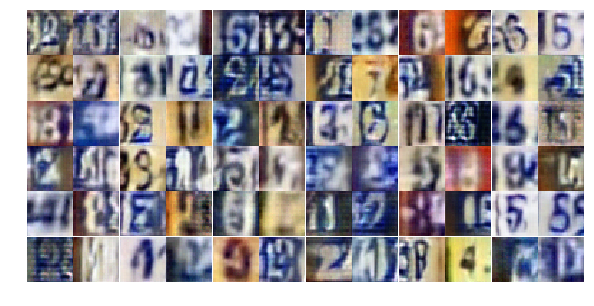

Epoch 11/25... Discriminator Loss: 1.1858... Generator Loss: 0.5116
Epoch 11/25... Discriminator Loss: 0.3899... Generator Loss: 2.3802
Epoch 11/25... Discriminator Loss: 1.3517... Generator Loss: 1.9490
Epoch 11/25... Discriminator Loss: 0.8956... Generator Loss: 0.8403
Epoch 11/25... Discriminator Loss: 0.7145... Generator Loss: 1.2065
Epoch 11/25... Discriminator Loss: 1.0975... Generator Loss: 0.5624
Epoch 11/25... Discriminator Loss: 0.9679... Generator Loss: 0.7165
Epoch 11/25... Discriminator Loss: 0.4645... Generator Loss: 1.5753
Epoch 11/25... Discriminator Loss: 0.7319... Generator Loss: 0.9147
Epoch 11/25... Discriminator Loss: 0.6465... Generator Loss: 1.0948


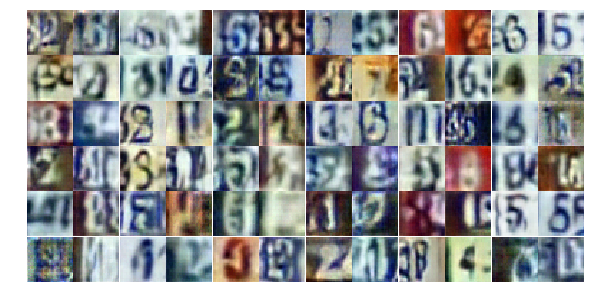

Epoch 12/25... Discriminator Loss: 0.7014... Generator Loss: 1.9913
Epoch 12/25... Discriminator Loss: 0.6861... Generator Loss: 0.9789
Epoch 12/25... Discriminator Loss: 0.8285... Generator Loss: 0.9511
Epoch 12/25... Discriminator Loss: 0.4532... Generator Loss: 1.5231
Epoch 12/25... Discriminator Loss: 0.5293... Generator Loss: 1.2425
Epoch 12/25... Discriminator Loss: 0.7074... Generator Loss: 0.9412
Epoch 12/25... Discriminator Loss: 0.5793... Generator Loss: 1.1936
Epoch 12/25... Discriminator Loss: 0.6151... Generator Loss: 1.2765
Epoch 12/25... Discriminator Loss: 0.6493... Generator Loss: 1.1003
Epoch 12/25... Discriminator Loss: 1.3893... Generator Loss: 0.3842


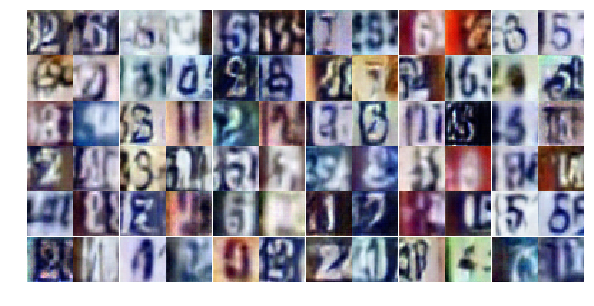

Epoch 12/25... Discriminator Loss: 0.4503... Generator Loss: 1.6356
Epoch 12/25... Discriminator Loss: 1.0365... Generator Loss: 0.5924
Epoch 12/25... Discriminator Loss: 0.5871... Generator Loss: 1.1155
Epoch 12/25... Discriminator Loss: 0.7136... Generator Loss: 1.0420
Epoch 12/25... Discriminator Loss: 0.4206... Generator Loss: 2.1734
Epoch 12/25... Discriminator Loss: 1.9605... Generator Loss: 0.2433
Epoch 12/25... Discriminator Loss: 2.1265... Generator Loss: 0.1819
Epoch 12/25... Discriminator Loss: 0.4863... Generator Loss: 1.7260
Epoch 12/25... Discriminator Loss: 0.6096... Generator Loss: 1.3908
Epoch 12/25... Discriminator Loss: 0.8052... Generator Loss: 0.8723


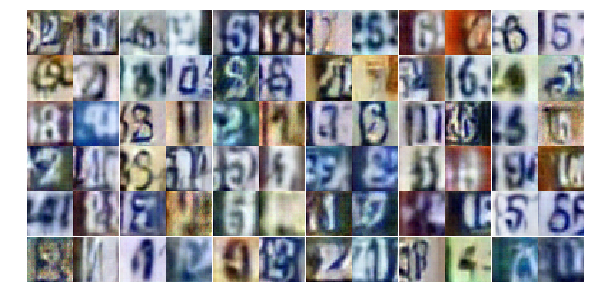

Epoch 12/25... Discriminator Loss: 0.3633... Generator Loss: 1.6863
Epoch 12/25... Discriminator Loss: 0.5372... Generator Loss: 1.1992
Epoch 12/25... Discriminator Loss: 0.5954... Generator Loss: 1.1697
Epoch 12/25... Discriminator Loss: 0.3839... Generator Loss: 1.7076
Epoch 12/25... Discriminator Loss: 0.4859... Generator Loss: 1.5049
Epoch 12/25... Discriminator Loss: 0.4046... Generator Loss: 1.6937
Epoch 12/25... Discriminator Loss: 1.0758... Generator Loss: 0.5536
Epoch 12/25... Discriminator Loss: 0.3740... Generator Loss: 1.5562
Epoch 12/25... Discriminator Loss: 0.5001... Generator Loss: 1.3668
Epoch 12/25... Discriminator Loss: 0.6743... Generator Loss: 0.9483


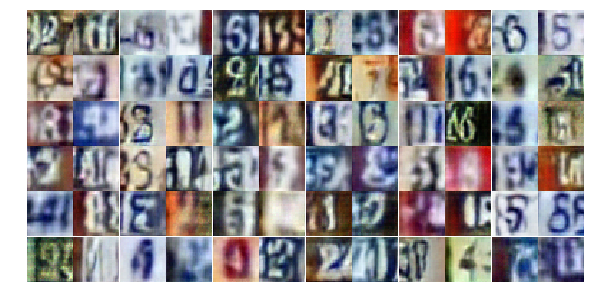

Epoch 12/25... Discriminator Loss: 0.5760... Generator Loss: 1.1826
Epoch 12/25... Discriminator Loss: 0.6868... Generator Loss: 1.2095
Epoch 12/25... Discriminator Loss: 0.9884... Generator Loss: 0.6175
Epoch 12/25... Discriminator Loss: 1.4863... Generator Loss: 0.3606
Epoch 12/25... Discriminator Loss: 0.5532... Generator Loss: 1.5301
Epoch 12/25... Discriminator Loss: 1.2440... Generator Loss: 0.5454
Epoch 12/25... Discriminator Loss: 0.7398... Generator Loss: 0.8717
Epoch 12/25... Discriminator Loss: 0.8719... Generator Loss: 0.7705
Epoch 12/25... Discriminator Loss: 0.6388... Generator Loss: 1.1321
Epoch 12/25... Discriminator Loss: 0.2949... Generator Loss: 1.7639


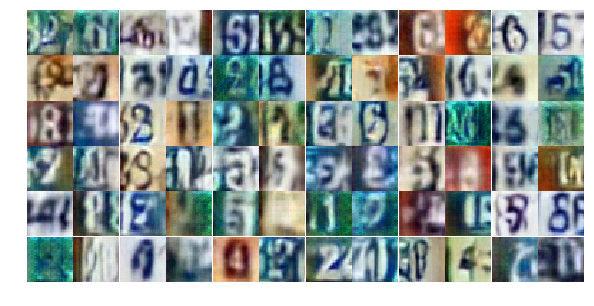

Epoch 12/25... Discriminator Loss: 0.6623... Generator Loss: 1.0279
Epoch 12/25... Discriminator Loss: 0.4724... Generator Loss: 1.4378
Epoch 12/25... Discriminator Loss: 0.4385... Generator Loss: 1.4325
Epoch 12/25... Discriminator Loss: 0.7462... Generator Loss: 1.1386
Epoch 12/25... Discriminator Loss: 0.7460... Generator Loss: 0.9367
Epoch 12/25... Discriminator Loss: 0.7364... Generator Loss: 0.9575
Epoch 12/25... Discriminator Loss: 0.3342... Generator Loss: 1.7355
Epoch 12/25... Discriminator Loss: 0.8920... Generator Loss: 0.7809
Epoch 12/25... Discriminator Loss: 0.5309... Generator Loss: 1.2051
Epoch 12/25... Discriminator Loss: 0.7038... Generator Loss: 1.1468


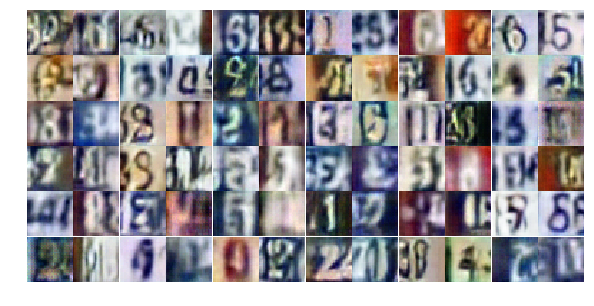

Epoch 12/25... Discriminator Loss: 1.0539... Generator Loss: 0.6383
Epoch 12/25... Discriminator Loss: 1.0700... Generator Loss: 0.5426
Epoch 12/25... Discriminator Loss: 0.5899... Generator Loss: 1.4747
Epoch 12/25... Discriminator Loss: 1.9847... Generator Loss: 0.2139
Epoch 12/25... Discriminator Loss: 0.6339... Generator Loss: 0.9513
Epoch 12/25... Discriminator Loss: 0.7707... Generator Loss: 1.0192
Epoch 12/25... Discriminator Loss: 1.0544... Generator Loss: 0.6333
Epoch 13/25... Discriminator Loss: 0.5771... Generator Loss: 1.2374
Epoch 13/25... Discriminator Loss: 0.3967... Generator Loss: 1.5852
Epoch 13/25... Discriminator Loss: 0.7032... Generator Loss: 1.0380


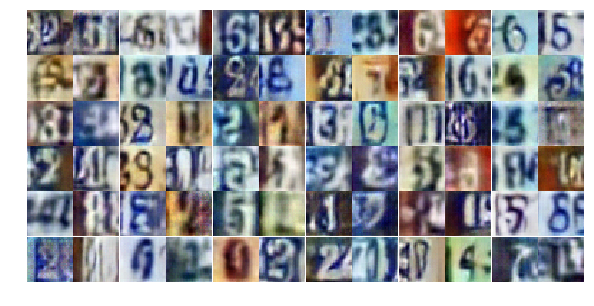

Epoch 13/25... Discriminator Loss: 0.6783... Generator Loss: 0.9564
Epoch 13/25... Discriminator Loss: 0.6414... Generator Loss: 2.4214
Epoch 13/25... Discriminator Loss: 1.7535... Generator Loss: 0.2634
Epoch 13/25... Discriminator Loss: 1.1704... Generator Loss: 0.5899
Epoch 13/25... Discriminator Loss: 0.6690... Generator Loss: 1.0612
Epoch 13/25... Discriminator Loss: 0.6125... Generator Loss: 1.0965
Epoch 13/25... Discriminator Loss: 0.4478... Generator Loss: 1.5278
Epoch 13/25... Discriminator Loss: 0.8078... Generator Loss: 0.8478
Epoch 13/25... Discriminator Loss: 0.4878... Generator Loss: 1.2930
Epoch 13/25... Discriminator Loss: 0.4793... Generator Loss: 1.2923


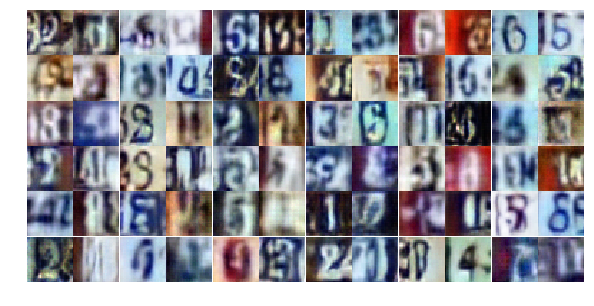

Epoch 13/25... Discriminator Loss: 0.9639... Generator Loss: 1.0234
Epoch 13/25... Discriminator Loss: 0.6327... Generator Loss: 1.0255
Epoch 13/25... Discriminator Loss: 3.3323... Generator Loss: 5.4480
Epoch 13/25... Discriminator Loss: 1.6690... Generator Loss: 0.7552
Epoch 13/25... Discriminator Loss: 1.0551... Generator Loss: 1.2594
Epoch 13/25... Discriminator Loss: 0.7245... Generator Loss: 1.3186
Epoch 13/25... Discriminator Loss: 0.8026... Generator Loss: 0.8651
Epoch 13/25... Discriminator Loss: 1.0578... Generator Loss: 0.6988
Epoch 13/25... Discriminator Loss: 0.5811... Generator Loss: 1.3391
Epoch 13/25... Discriminator Loss: 0.9712... Generator Loss: 0.6720


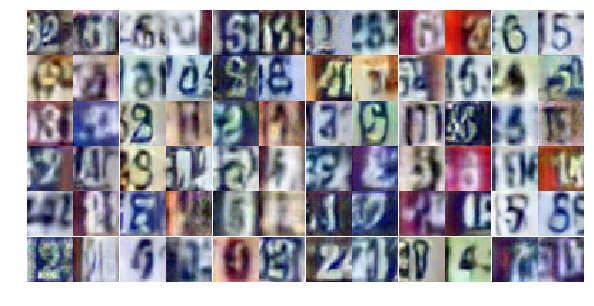

Epoch 13/25... Discriminator Loss: 0.9328... Generator Loss: 0.7501
Epoch 13/25... Discriminator Loss: 0.5515... Generator Loss: 1.4518
Epoch 13/25... Discriminator Loss: 0.5668... Generator Loss: 1.3319
Epoch 13/25... Discriminator Loss: 0.6978... Generator Loss: 0.9524
Epoch 13/25... Discriminator Loss: 0.7628... Generator Loss: 1.0144
Epoch 13/25... Discriminator Loss: 1.0751... Generator Loss: 0.5505
Epoch 13/25... Discriminator Loss: 0.6631... Generator Loss: 1.7999
Epoch 13/25... Discriminator Loss: 0.5094... Generator Loss: 1.3881
Epoch 13/25... Discriminator Loss: 0.5888... Generator Loss: 1.4297
Epoch 13/25... Discriminator Loss: 0.6360... Generator Loss: 1.1671


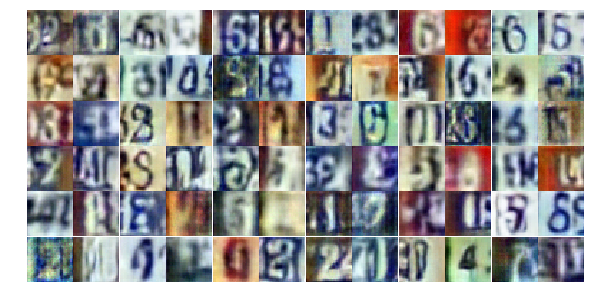

Epoch 13/25... Discriminator Loss: 0.9392... Generator Loss: 0.6941
Epoch 13/25... Discriminator Loss: 0.8903... Generator Loss: 1.0020
Epoch 13/25... Discriminator Loss: 1.4325... Generator Loss: 0.4642
Epoch 13/25... Discriminator Loss: 0.6718... Generator Loss: 1.1929
Epoch 13/25... Discriminator Loss: 0.6871... Generator Loss: 1.0119
Epoch 13/25... Discriminator Loss: 0.6342... Generator Loss: 1.1587
Epoch 13/25... Discriminator Loss: 0.5460... Generator Loss: 1.1572
Epoch 13/25... Discriminator Loss: 0.8887... Generator Loss: 0.7606
Epoch 13/25... Discriminator Loss: 0.6525... Generator Loss: 1.0546
Epoch 13/25... Discriminator Loss: 0.7749... Generator Loss: 0.8502


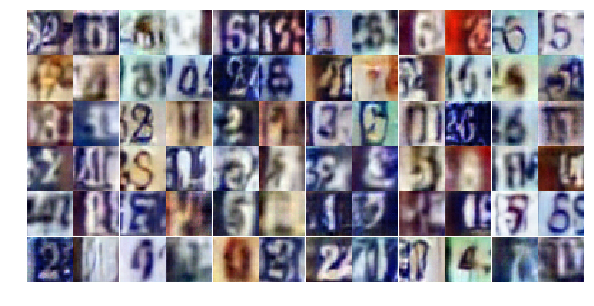

Epoch 13/25... Discriminator Loss: 0.5287... Generator Loss: 1.2757
Epoch 13/25... Discriminator Loss: 0.8716... Generator Loss: 0.7379
Epoch 13/25... Discriminator Loss: 0.6919... Generator Loss: 1.0560
Epoch 13/25... Discriminator Loss: 0.7839... Generator Loss: 0.8217
Epoch 13/25... Discriminator Loss: 1.1618... Generator Loss: 0.5473
Epoch 13/25... Discriminator Loss: 0.6350... Generator Loss: 1.7349
Epoch 13/25... Discriminator Loss: 0.6360... Generator Loss: 1.1702
Epoch 13/25... Discriminator Loss: 0.7645... Generator Loss: 0.8478
Epoch 13/25... Discriminator Loss: 0.8279... Generator Loss: 0.7417
Epoch 13/25... Discriminator Loss: 0.8336... Generator Loss: 0.8329


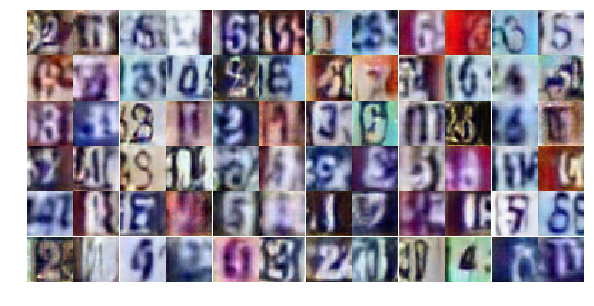

Epoch 13/25... Discriminator Loss: 0.3116... Generator Loss: 2.0210
Epoch 13/25... Discriminator Loss: 0.9880... Generator Loss: 0.7035
Epoch 13/25... Discriminator Loss: 0.7129... Generator Loss: 0.9504
Epoch 13/25... Discriminator Loss: 0.9852... Generator Loss: 0.6605
Epoch 14/25... Discriminator Loss: 0.9548... Generator Loss: 0.7105
Epoch 14/25... Discriminator Loss: 0.7135... Generator Loss: 1.0171
Epoch 14/25... Discriminator Loss: 0.8918... Generator Loss: 0.8031
Epoch 14/25... Discriminator Loss: 0.5768... Generator Loss: 1.3078
Epoch 14/25... Discriminator Loss: 0.6195... Generator Loss: 1.1988
Epoch 14/25... Discriminator Loss: 0.6967... Generator Loss: 0.9521


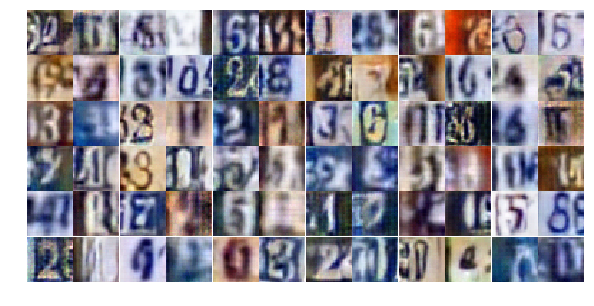

Epoch 14/25... Discriminator Loss: 0.7318... Generator Loss: 1.1360
Epoch 14/25... Discriminator Loss: 1.3376... Generator Loss: 0.4197
Epoch 14/25... Discriminator Loss: 1.0726... Generator Loss: 0.6280
Epoch 14/25... Discriminator Loss: 0.6583... Generator Loss: 1.0387
Epoch 14/25... Discriminator Loss: 1.1500... Generator Loss: 0.5714
Epoch 14/25... Discriminator Loss: 0.4344... Generator Loss: 1.4829
Epoch 14/25... Discriminator Loss: 0.5113... Generator Loss: 1.6093
Epoch 14/25... Discriminator Loss: 1.4945... Generator Loss: 0.3513
Epoch 14/25... Discriminator Loss: 1.0237... Generator Loss: 0.6358
Epoch 14/25... Discriminator Loss: 1.8426... Generator Loss: 0.2737


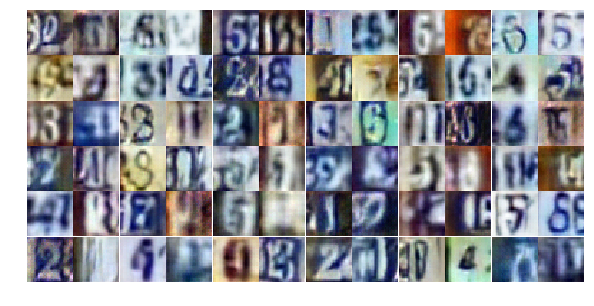

Epoch 14/25... Discriminator Loss: 0.7554... Generator Loss: 0.9692
Epoch 14/25... Discriminator Loss: 0.6944... Generator Loss: 2.7706
Epoch 14/25... Discriminator Loss: 0.9833... Generator Loss: 0.7756
Epoch 14/25... Discriminator Loss: 0.7267... Generator Loss: 1.1660
Epoch 14/25... Discriminator Loss: 1.0213... Generator Loss: 0.6573
Epoch 14/25... Discriminator Loss: 0.8341... Generator Loss: 0.9175
Epoch 14/25... Discriminator Loss: 0.8227... Generator Loss: 0.8756
Epoch 14/25... Discriminator Loss: 0.6921... Generator Loss: 1.0210
Epoch 14/25... Discriminator Loss: 0.4713... Generator Loss: 1.5261
Epoch 14/25... Discriminator Loss: 0.5057... Generator Loss: 1.3186


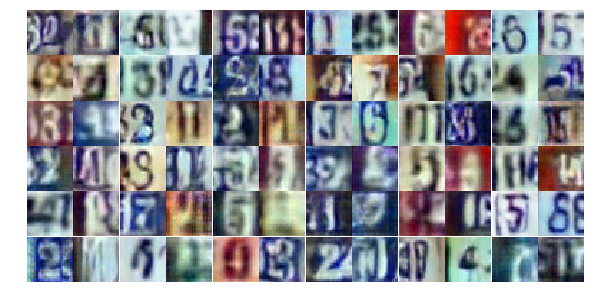

Epoch 14/25... Discriminator Loss: 1.0914... Generator Loss: 0.5606
Epoch 14/25... Discriminator Loss: 0.4278... Generator Loss: 1.4300
Epoch 14/25... Discriminator Loss: 0.5514... Generator Loss: 1.2936
Epoch 14/25... Discriminator Loss: 0.5119... Generator Loss: 1.2666
Epoch 14/25... Discriminator Loss: 0.5609... Generator Loss: 1.2767
Epoch 14/25... Discriminator Loss: 0.6238... Generator Loss: 1.0777
Epoch 14/25... Discriminator Loss: 0.5925... Generator Loss: 1.1080
Epoch 14/25... Discriminator Loss: 0.7891... Generator Loss: 3.1754
Epoch 14/25... Discriminator Loss: 0.4824... Generator Loss: 2.1090
Epoch 14/25... Discriminator Loss: 0.7757... Generator Loss: 1.2910


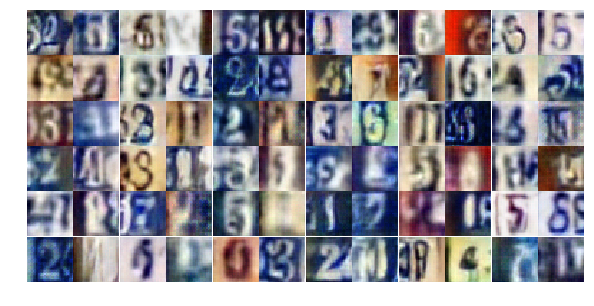

Epoch 14/25... Discriminator Loss: 1.2591... Generator Loss: 0.4669
Epoch 14/25... Discriminator Loss: 0.8531... Generator Loss: 0.9337
Epoch 14/25... Discriminator Loss: 1.0968... Generator Loss: 0.5508
Epoch 14/25... Discriminator Loss: 1.2521... Generator Loss: 0.4811
Epoch 14/25... Discriminator Loss: 1.1172... Generator Loss: 0.5452
Epoch 14/25... Discriminator Loss: 0.7472... Generator Loss: 0.9501
Epoch 14/25... Discriminator Loss: 0.5550... Generator Loss: 1.9509
Epoch 14/25... Discriminator Loss: 0.6061... Generator Loss: 1.2793
Epoch 14/25... Discriminator Loss: 1.5281... Generator Loss: 0.3659
Epoch 14/25... Discriminator Loss: 1.0534... Generator Loss: 0.6470


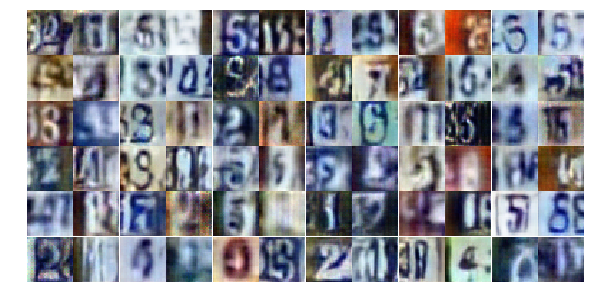

Epoch 14/25... Discriminator Loss: 1.1047... Generator Loss: 0.5958
Epoch 14/25... Discriminator Loss: 1.2581... Generator Loss: 0.4983
Epoch 14/25... Discriminator Loss: 0.6956... Generator Loss: 2.5041
Epoch 14/25... Discriminator Loss: 0.9492... Generator Loss: 0.7270
Epoch 14/25... Discriminator Loss: 0.6924... Generator Loss: 1.0170
Epoch 14/25... Discriminator Loss: 0.8919... Generator Loss: 0.8056
Epoch 14/25... Discriminator Loss: 0.7512... Generator Loss: 1.4108
Epoch 14/25... Discriminator Loss: 0.7351... Generator Loss: 0.9893
Epoch 14/25... Discriminator Loss: 1.0615... Generator Loss: 0.5619
Epoch 14/25... Discriminator Loss: 1.0557... Generator Loss: 0.6816


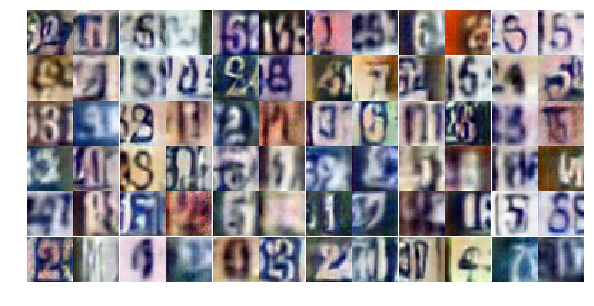

Epoch 14/25... Discriminator Loss: 1.0441... Generator Loss: 0.6482
Epoch 14/25... Discriminator Loss: 1.2172... Generator Loss: 2.0173
Epoch 15/25... Discriminator Loss: 0.9693... Generator Loss: 0.8186
Epoch 15/25... Discriminator Loss: 0.5381... Generator Loss: 1.5681
Epoch 15/25... Discriminator Loss: 0.7686... Generator Loss: 0.8967
Epoch 15/25... Discriminator Loss: 1.0655... Generator Loss: 0.6102
Epoch 15/25... Discriminator Loss: 1.1876... Generator Loss: 0.4977
Epoch 15/25... Discriminator Loss: 0.4926... Generator Loss: 1.5700
Epoch 15/25... Discriminator Loss: 1.4435... Generator Loss: 0.4737
Epoch 15/25... Discriminator Loss: 0.5340... Generator Loss: 1.2681


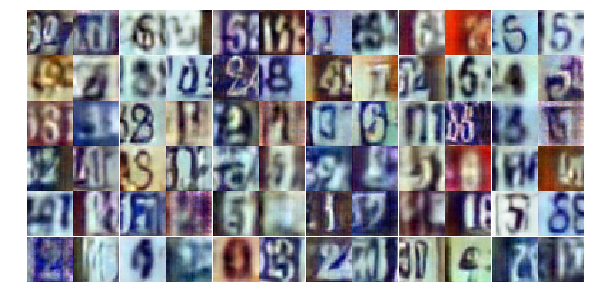

Epoch 15/25... Discriminator Loss: 0.8708... Generator Loss: 0.7985
Epoch 15/25... Discriminator Loss: 0.6526... Generator Loss: 1.2322
Epoch 15/25... Discriminator Loss: 0.6110... Generator Loss: 1.2227
Epoch 15/25... Discriminator Loss: 0.5957... Generator Loss: 1.1788
Epoch 15/25... Discriminator Loss: 1.1895... Generator Loss: 0.6046
Epoch 15/25... Discriminator Loss: 0.5027... Generator Loss: 1.6985
Epoch 15/25... Discriminator Loss: 1.1589... Generator Loss: 0.7867
Epoch 15/25... Discriminator Loss: 0.7618... Generator Loss: 1.2049
Epoch 15/25... Discriminator Loss: 0.6001... Generator Loss: 1.6649
Epoch 15/25... Discriminator Loss: 1.5289... Generator Loss: 0.3691


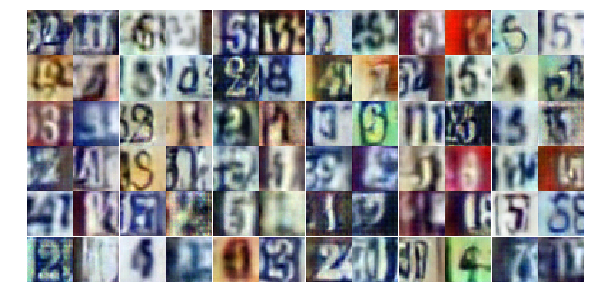

Epoch 15/25... Discriminator Loss: 1.3203... Generator Loss: 0.4761
Epoch 15/25... Discriminator Loss: 0.7279... Generator Loss: 0.9369
Epoch 15/25... Discriminator Loss: 0.5685... Generator Loss: 1.2984
Epoch 15/25... Discriminator Loss: 0.6284... Generator Loss: 1.2569
Epoch 15/25... Discriminator Loss: 1.2254... Generator Loss: 0.5536
Epoch 15/25... Discriminator Loss: 0.6202... Generator Loss: 1.1771
Epoch 15/25... Discriminator Loss: 0.8249... Generator Loss: 0.8861
Epoch 15/25... Discriminator Loss: 0.7496... Generator Loss: 1.1108
Epoch 15/25... Discriminator Loss: 0.6462... Generator Loss: 0.9705
Epoch 15/25... Discriminator Loss: 1.1703... Generator Loss: 0.5932


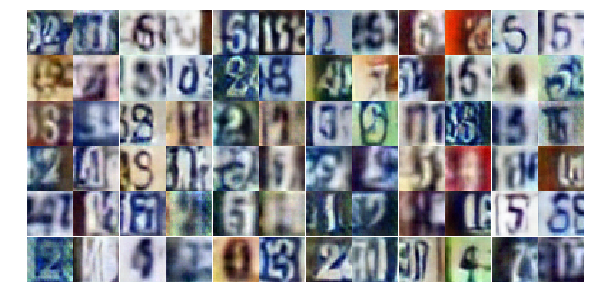

Epoch 15/25... Discriminator Loss: 0.7595... Generator Loss: 0.9416
Epoch 15/25... Discriminator Loss: 0.8022... Generator Loss: 0.8484
Epoch 15/25... Discriminator Loss: 0.3666... Generator Loss: 1.5913
Epoch 15/25... Discriminator Loss: 0.6493... Generator Loss: 1.1792
Epoch 15/25... Discriminator Loss: 0.6928... Generator Loss: 0.9816
Epoch 15/25... Discriminator Loss: 0.9343... Generator Loss: 1.9762
Epoch 15/25... Discriminator Loss: 1.0210... Generator Loss: 0.5927
Epoch 15/25... Discriminator Loss: 0.6502... Generator Loss: 1.1469
Epoch 15/25... Discriminator Loss: 0.5070... Generator Loss: 2.0998
Epoch 15/25... Discriminator Loss: 0.7298... Generator Loss: 1.2501


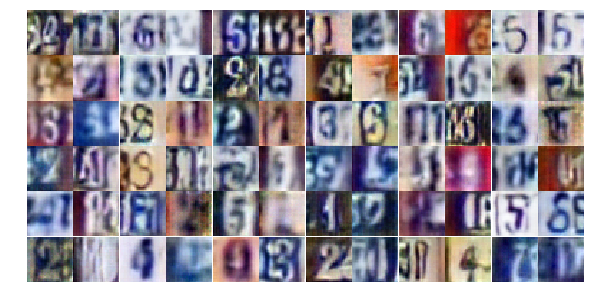

Epoch 15/25... Discriminator Loss: 0.8131... Generator Loss: 0.8595
Epoch 15/25... Discriminator Loss: 1.2614... Generator Loss: 0.4838
Epoch 15/25... Discriminator Loss: 0.5712... Generator Loss: 1.2439
Epoch 15/25... Discriminator Loss: 0.4350... Generator Loss: 1.5323
Epoch 15/25... Discriminator Loss: 0.3898... Generator Loss: 1.6862
Epoch 15/25... Discriminator Loss: 2.1013... Generator Loss: 0.2980
Epoch 15/25... Discriminator Loss: 0.6040... Generator Loss: 1.5898
Epoch 15/25... Discriminator Loss: 0.8577... Generator Loss: 1.1051
Epoch 15/25... Discriminator Loss: 0.7366... Generator Loss: 0.8929
Epoch 15/25... Discriminator Loss: 0.7166... Generator Loss: 1.1245


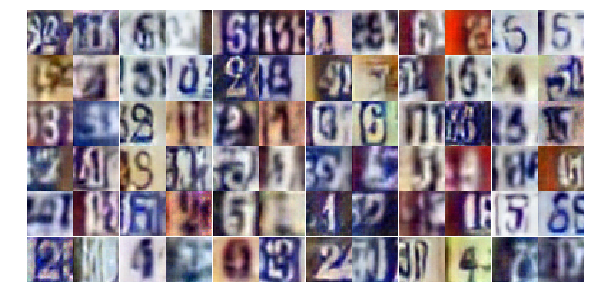

Epoch 15/25... Discriminator Loss: 1.5314... Generator Loss: 0.3801
Epoch 15/25... Discriminator Loss: 0.8611... Generator Loss: 0.9156
Epoch 15/25... Discriminator Loss: 0.5357... Generator Loss: 1.5214
Epoch 15/25... Discriminator Loss: 0.9313... Generator Loss: 0.9284
Epoch 15/25... Discriminator Loss: 0.6251... Generator Loss: 1.1321
Epoch 15/25... Discriminator Loss: 1.2231... Generator Loss: 3.1741
Epoch 15/25... Discriminator Loss: 1.1568... Generator Loss: 0.6078
Epoch 15/25... Discriminator Loss: 0.6548... Generator Loss: 1.1251
Epoch 15/25... Discriminator Loss: 1.5545... Generator Loss: 0.3405
Epoch 16/25... Discriminator Loss: 1.2411... Generator Loss: 0.5039


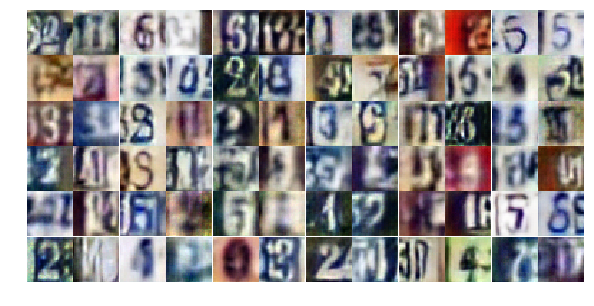

Epoch 16/25... Discriminator Loss: 0.6466... Generator Loss: 1.0867
Epoch 16/25... Discriminator Loss: 0.7882... Generator Loss: 1.0815
Epoch 16/25... Discriminator Loss: 1.1816... Generator Loss: 0.5282
Epoch 16/25... Discriminator Loss: 0.5905... Generator Loss: 1.4994
Epoch 16/25... Discriminator Loss: 0.5525... Generator Loss: 1.5640
Epoch 16/25... Discriminator Loss: 0.6261... Generator Loss: 2.0693
Epoch 16/25... Discriminator Loss: 1.4086... Generator Loss: 0.3724
Epoch 16/25... Discriminator Loss: 0.8122... Generator Loss: 0.8477
Epoch 16/25... Discriminator Loss: 0.5023... Generator Loss: 1.3175
Epoch 16/25... Discriminator Loss: 0.6441... Generator Loss: 0.9439


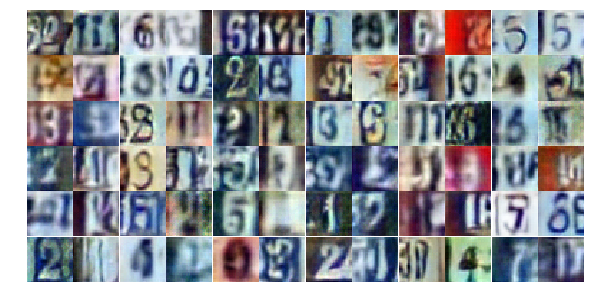

Epoch 16/25... Discriminator Loss: 1.0980... Generator Loss: 0.5908
Epoch 16/25... Discriminator Loss: 0.6273... Generator Loss: 1.1054
Epoch 16/25... Discriminator Loss: 0.6667... Generator Loss: 1.1224
Epoch 16/25... Discriminator Loss: 1.4834... Generator Loss: 0.3516
Epoch 16/25... Discriminator Loss: 2.4592... Generator Loss: 0.5232
Epoch 16/25... Discriminator Loss: 1.0380... Generator Loss: 0.8162
Epoch 16/25... Discriminator Loss: 0.9605... Generator Loss: 0.7140
Epoch 16/25... Discriminator Loss: 0.7223... Generator Loss: 1.1123
Epoch 16/25... Discriminator Loss: 0.7051... Generator Loss: 0.9506
Epoch 16/25... Discriminator Loss: 0.8397... Generator Loss: 0.8428


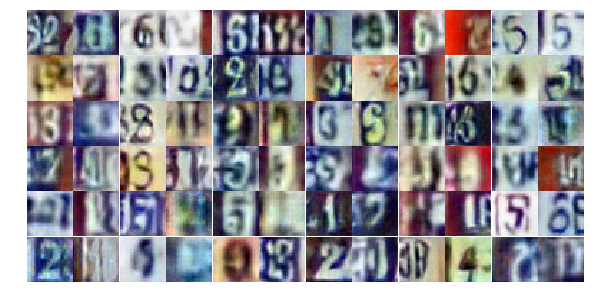

Epoch 16/25... Discriminator Loss: 0.9267... Generator Loss: 0.8069
Epoch 16/25... Discriminator Loss: 0.6274... Generator Loss: 1.4737
Epoch 16/25... Discriminator Loss: 0.7242... Generator Loss: 1.0246
Epoch 16/25... Discriminator Loss: 1.0080... Generator Loss: 0.7104
Epoch 16/25... Discriminator Loss: 0.8249... Generator Loss: 0.9565
Epoch 16/25... Discriminator Loss: 1.0402... Generator Loss: 0.6123
Epoch 16/25... Discriminator Loss: 0.7918... Generator Loss: 0.8202
Epoch 16/25... Discriminator Loss: 0.6690... Generator Loss: 1.0114
Epoch 16/25... Discriminator Loss: 0.6478... Generator Loss: 1.3797
Epoch 16/25... Discriminator Loss: 0.7138... Generator Loss: 0.9338


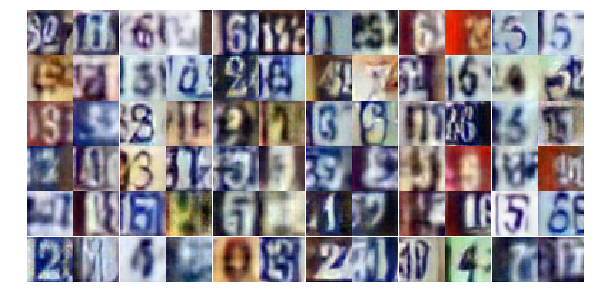

Epoch 16/25... Discriminator Loss: 0.5725... Generator Loss: 1.1664
Epoch 16/25... Discriminator Loss: 0.5290... Generator Loss: 1.3154
Epoch 16/25... Discriminator Loss: 0.5308... Generator Loss: 1.4793
Epoch 16/25... Discriminator Loss: 0.6964... Generator Loss: 1.0592
Epoch 16/25... Discriminator Loss: 1.0144... Generator Loss: 0.8822
Epoch 16/25... Discriminator Loss: 0.7072... Generator Loss: 1.3278
Epoch 16/25... Discriminator Loss: 0.7329... Generator Loss: 1.0346
Epoch 16/25... Discriminator Loss: 1.1009... Generator Loss: 0.5780
Epoch 16/25... Discriminator Loss: 0.8798... Generator Loss: 0.8182
Epoch 16/25... Discriminator Loss: 0.4563... Generator Loss: 2.0860


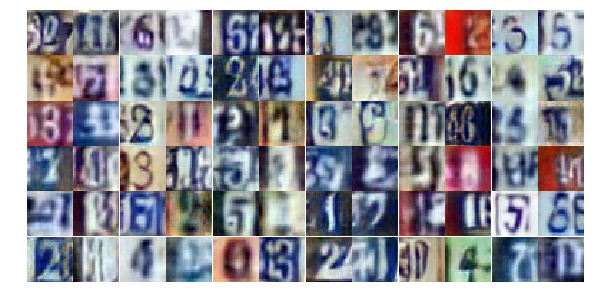

Epoch 16/25... Discriminator Loss: 0.7062... Generator Loss: 1.0892
Epoch 16/25... Discriminator Loss: 0.6315... Generator Loss: 1.7335
Epoch 16/25... Discriminator Loss: 0.7766... Generator Loss: 0.9778
Epoch 16/25... Discriminator Loss: 0.8188... Generator Loss: 0.9076
Epoch 16/25... Discriminator Loss: 0.7094... Generator Loss: 1.0398
Epoch 16/25... Discriminator Loss: 1.4586... Generator Loss: 0.3687
Epoch 16/25... Discriminator Loss: 0.5169... Generator Loss: 1.4674
Epoch 16/25... Discriminator Loss: 0.8761... Generator Loss: 0.7914
Epoch 16/25... Discriminator Loss: 0.4821... Generator Loss: 1.2847
Epoch 16/25... Discriminator Loss: 0.7957... Generator Loss: 0.8383


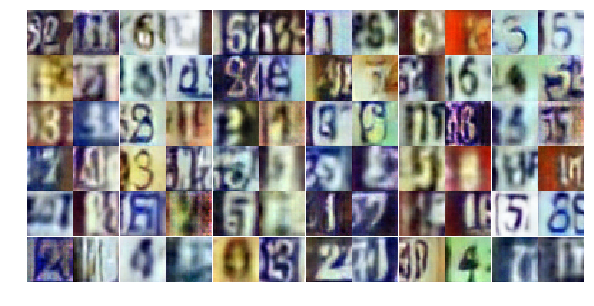

Epoch 16/25... Discriminator Loss: 1.6174... Generator Loss: 0.3095
Epoch 16/25... Discriminator Loss: 1.1997... Generator Loss: 0.5225
Epoch 16/25... Discriminator Loss: 1.8564... Generator Loss: 0.3597
Epoch 16/25... Discriminator Loss: 0.5626... Generator Loss: 2.7851
Epoch 16/25... Discriminator Loss: 0.5810... Generator Loss: 1.4452
Epoch 16/25... Discriminator Loss: 1.0574... Generator Loss: 0.6424
Epoch 17/25... Discriminator Loss: 0.5796... Generator Loss: 1.4693
Epoch 17/25... Discriminator Loss: 0.7125... Generator Loss: 1.0785
Epoch 17/25... Discriminator Loss: 0.6512... Generator Loss: 1.0141
Epoch 17/25... Discriminator Loss: 0.7972... Generator Loss: 0.9685


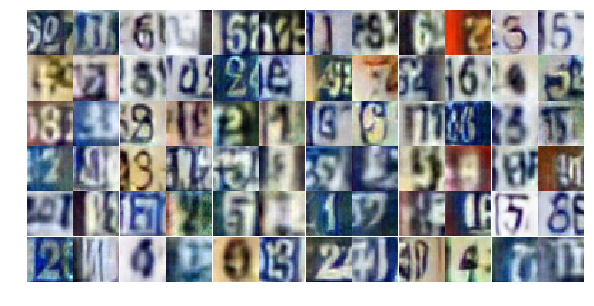

Epoch 17/25... Discriminator Loss: 0.6105... Generator Loss: 1.0986
Epoch 17/25... Discriminator Loss: 0.4933... Generator Loss: 1.2786
Epoch 17/25... Discriminator Loss: 1.0099... Generator Loss: 0.7084
Epoch 17/25... Discriminator Loss: 0.6865... Generator Loss: 1.0526
Epoch 17/25... Discriminator Loss: 1.1845... Generator Loss: 0.5515
Epoch 17/25... Discriminator Loss: 1.2712... Generator Loss: 0.4949
Epoch 17/25... Discriminator Loss: 0.7425... Generator Loss: 0.9709
Epoch 17/25... Discriminator Loss: 0.6384... Generator Loss: 1.0651
Epoch 17/25... Discriminator Loss: 0.4652... Generator Loss: 1.5635
Epoch 17/25... Discriminator Loss: 0.5750... Generator Loss: 1.4447


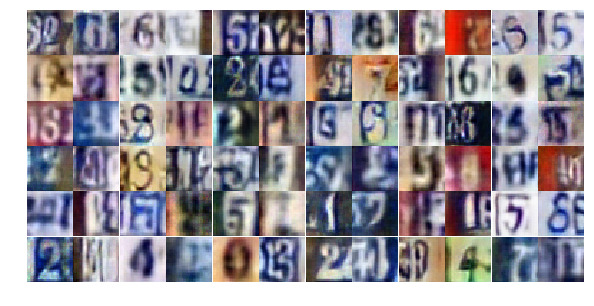

Epoch 17/25... Discriminator Loss: 1.1404... Generator Loss: 0.6915
Epoch 17/25... Discriminator Loss: 0.4853... Generator Loss: 1.4677
Epoch 17/25... Discriminator Loss: 0.6501... Generator Loss: 1.2245
Epoch 17/25... Discriminator Loss: 0.6656... Generator Loss: 1.1861
Epoch 17/25... Discriminator Loss: 0.7320... Generator Loss: 1.0165
Epoch 17/25... Discriminator Loss: 0.8842... Generator Loss: 0.8068
Epoch 17/25... Discriminator Loss: 0.5867... Generator Loss: 1.1965
Epoch 17/25... Discriminator Loss: 0.4736... Generator Loss: 1.3926
Epoch 17/25... Discriminator Loss: 0.8183... Generator Loss: 0.8439
Epoch 17/25... Discriminator Loss: 0.6646... Generator Loss: 0.9963


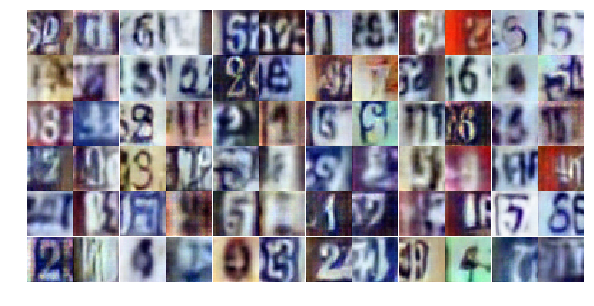

Epoch 17/25... Discriminator Loss: 1.6540... Generator Loss: 0.3108
Epoch 17/25... Discriminator Loss: 0.4295... Generator Loss: 1.8201
Epoch 17/25... Discriminator Loss: 0.5087... Generator Loss: 1.2527
Epoch 17/25... Discriminator Loss: 0.8753... Generator Loss: 0.8575
Epoch 17/25... Discriminator Loss: 2.1105... Generator Loss: 0.1958
Epoch 17/25... Discriminator Loss: 1.1976... Generator Loss: 0.5103
Epoch 17/25... Discriminator Loss: 0.7315... Generator Loss: 1.0070
Epoch 17/25... Discriminator Loss: 0.8794... Generator Loss: 0.8117
Epoch 17/25... Discriminator Loss: 0.9225... Generator Loss: 0.7743
Epoch 17/25... Discriminator Loss: 0.3169... Generator Loss: 2.0358


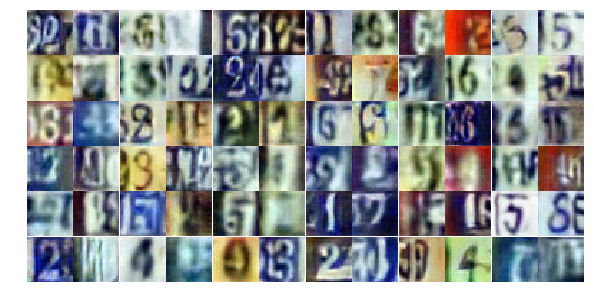

Epoch 17/25... Discriminator Loss: 0.6295... Generator Loss: 1.3483
Epoch 17/25... Discriminator Loss: 1.0967... Generator Loss: 0.6475
Epoch 17/25... Discriminator Loss: 0.7049... Generator Loss: 1.1699
Epoch 17/25... Discriminator Loss: 0.7882... Generator Loss: 1.8789
Epoch 17/25... Discriminator Loss: 1.1353... Generator Loss: 0.5661
Epoch 17/25... Discriminator Loss: 0.7495... Generator Loss: 1.1546
Epoch 17/25... Discriminator Loss: 0.8331... Generator Loss: 1.6572
Epoch 17/25... Discriminator Loss: 0.5608... Generator Loss: 1.3475
Epoch 17/25... Discriminator Loss: 0.3154... Generator Loss: 1.9133
Epoch 17/25... Discriminator Loss: 0.6625... Generator Loss: 1.1039


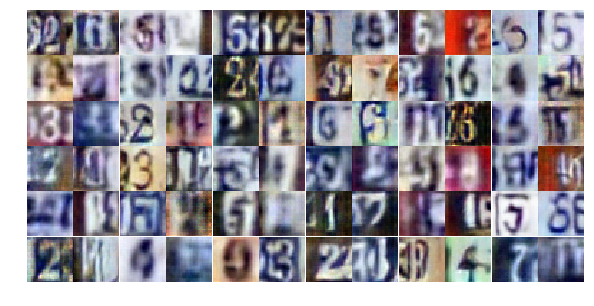

Epoch 17/25... Discriminator Loss: 1.8196... Generator Loss: 2.5804
Epoch 17/25... Discriminator Loss: 0.3859... Generator Loss: 1.6467
Epoch 17/25... Discriminator Loss: 0.8963... Generator Loss: 0.8158
Epoch 17/25... Discriminator Loss: 0.4144... Generator Loss: 1.8854
Epoch 17/25... Discriminator Loss: 0.6756... Generator Loss: 1.0579
Epoch 17/25... Discriminator Loss: 0.9164... Generator Loss: 0.7038
Epoch 17/25... Discriminator Loss: 1.5974... Generator Loss: 0.3016
Epoch 17/25... Discriminator Loss: 0.6824... Generator Loss: 1.1232
Epoch 17/25... Discriminator Loss: 0.6359... Generator Loss: 1.2378
Epoch 17/25... Discriminator Loss: 1.1541... Generator Loss: 0.6443


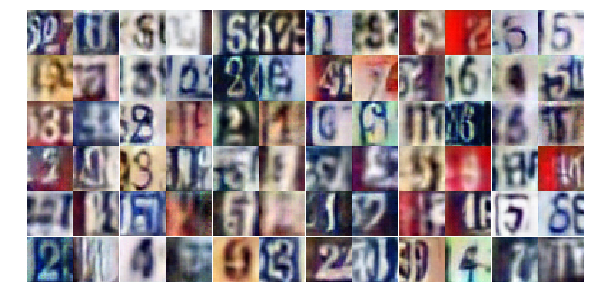

Epoch 17/25... Discriminator Loss: 0.6661... Generator Loss: 1.2380
Epoch 17/25... Discriminator Loss: 1.4897... Generator Loss: 3.0753
Epoch 17/25... Discriminator Loss: 0.6610... Generator Loss: 1.3033
Epoch 17/25... Discriminator Loss: 0.6260... Generator Loss: 1.2291
Epoch 18/25... Discriminator Loss: 1.2997... Generator Loss: 0.4925
Epoch 18/25... Discriminator Loss: 1.4208... Generator Loss: 0.3962
Epoch 18/25... Discriminator Loss: 0.6508... Generator Loss: 1.1513
Epoch 18/25... Discriminator Loss: 0.8031... Generator Loss: 0.8370
Epoch 18/25... Discriminator Loss: 0.7413... Generator Loss: 1.5362
Epoch 18/25... Discriminator Loss: 1.0139... Generator Loss: 0.6806


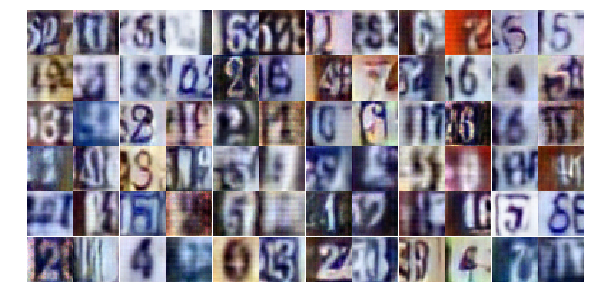

Epoch 18/25... Discriminator Loss: 0.6178... Generator Loss: 1.2237
Epoch 18/25... Discriminator Loss: 0.5740... Generator Loss: 1.8597
Epoch 18/25... Discriminator Loss: 0.6394... Generator Loss: 1.1658
Epoch 18/25... Discriminator Loss: 0.4261... Generator Loss: 1.7580
Epoch 18/25... Discriminator Loss: 0.8206... Generator Loss: 0.8301
Epoch 18/25... Discriminator Loss: 0.8993... Generator Loss: 0.7313
Epoch 18/25... Discriminator Loss: 0.6862... Generator Loss: 1.0839
Epoch 18/25... Discriminator Loss: 0.8051... Generator Loss: 0.8786
Epoch 18/25... Discriminator Loss: 0.5211... Generator Loss: 1.3226
Epoch 18/25... Discriminator Loss: 0.3968... Generator Loss: 1.7280


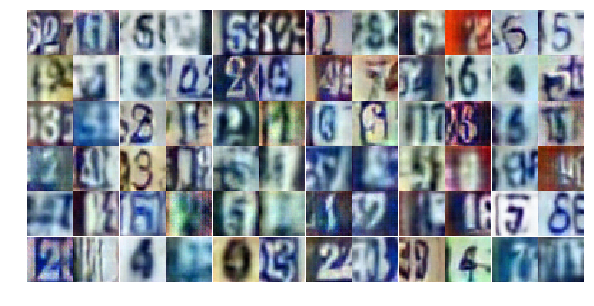

Epoch 18/25... Discriminator Loss: 0.5279... Generator Loss: 1.5509
Epoch 18/25... Discriminator Loss: 0.8247... Generator Loss: 2.3455
Epoch 18/25... Discriminator Loss: 1.3116... Generator Loss: 1.9640
Epoch 18/25... Discriminator Loss: 0.8984... Generator Loss: 0.8652
Epoch 18/25... Discriminator Loss: 0.5059... Generator Loss: 1.3369
Epoch 18/25... Discriminator Loss: 1.0189... Generator Loss: 0.6816
Epoch 18/25... Discriminator Loss: 0.8626... Generator Loss: 0.8584
Epoch 18/25... Discriminator Loss: 1.1472... Generator Loss: 0.5806
Epoch 18/25... Discriminator Loss: 0.8489... Generator Loss: 0.8147
Epoch 18/25... Discriminator Loss: 0.6077... Generator Loss: 1.2834


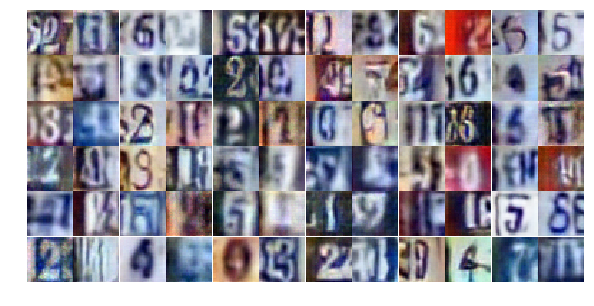

Epoch 18/25... Discriminator Loss: 0.4983... Generator Loss: 1.7091
Epoch 18/25... Discriminator Loss: 0.7397... Generator Loss: 1.1107
Epoch 18/25... Discriminator Loss: 0.7068... Generator Loss: 1.0200
Epoch 18/25... Discriminator Loss: 0.7078... Generator Loss: 1.0177
Epoch 18/25... Discriminator Loss: 0.7938... Generator Loss: 0.8427
Epoch 18/25... Discriminator Loss: 0.5952... Generator Loss: 1.1972
Epoch 18/25... Discriminator Loss: 0.6161... Generator Loss: 1.1402
Epoch 18/25... Discriminator Loss: 0.7209... Generator Loss: 1.4117
Epoch 18/25... Discriminator Loss: 0.8398... Generator Loss: 0.8001
Epoch 18/25... Discriminator Loss: 0.7973... Generator Loss: 0.9083


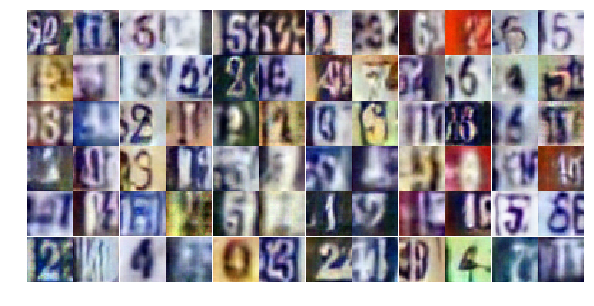

Epoch 18/25... Discriminator Loss: 0.6554... Generator Loss: 1.1251
Epoch 18/25... Discriminator Loss: 0.7481... Generator Loss: 0.9410
Epoch 18/25... Discriminator Loss: 0.6689... Generator Loss: 0.9725
Epoch 18/25... Discriminator Loss: 0.7915... Generator Loss: 0.8303
Epoch 18/25... Discriminator Loss: 0.6570... Generator Loss: 1.6789
Epoch 18/25... Discriminator Loss: 0.6224... Generator Loss: 1.1333
Epoch 18/25... Discriminator Loss: 0.6670... Generator Loss: 1.0259
Epoch 18/25... Discriminator Loss: 2.9274... Generator Loss: 4.9912
Epoch 18/25... Discriminator Loss: 1.8264... Generator Loss: 0.3114
Epoch 18/25... Discriminator Loss: 0.4262... Generator Loss: 1.5371


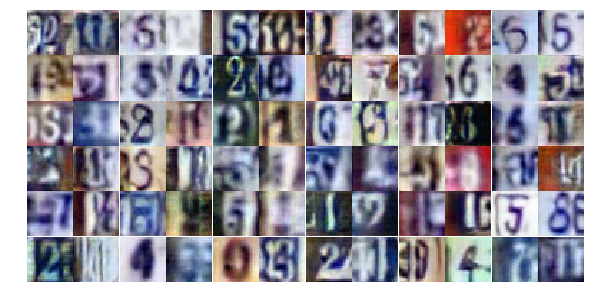

Epoch 18/25... Discriminator Loss: 0.7021... Generator Loss: 1.0661
Epoch 18/25... Discriminator Loss: 1.2218... Generator Loss: 0.5614
Epoch 18/25... Discriminator Loss: 0.7925... Generator Loss: 0.9346
Epoch 18/25... Discriminator Loss: 0.8411... Generator Loss: 0.8601
Epoch 18/25... Discriminator Loss: 0.4308... Generator Loss: 1.7720
Epoch 18/25... Discriminator Loss: 0.7799... Generator Loss: 1.0198
Epoch 18/25... Discriminator Loss: 0.7611... Generator Loss: 0.9187
Epoch 18/25... Discriminator Loss: 0.4703... Generator Loss: 1.5128
Epoch 18/25... Discriminator Loss: 1.0523... Generator Loss: 0.6164
Epoch 18/25... Discriminator Loss: 0.5478... Generator Loss: 1.2217


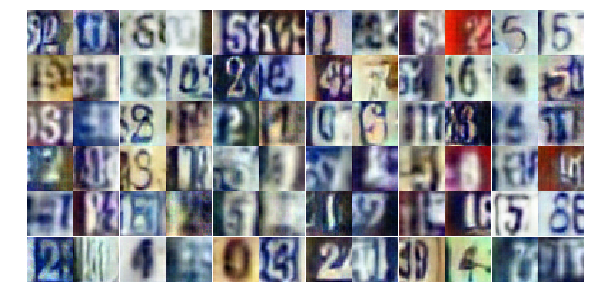

Epoch 18/25... Discriminator Loss: 0.6151... Generator Loss: 1.1927
Epoch 19/25... Discriminator Loss: 1.3661... Generator Loss: 0.4554
Epoch 19/25... Discriminator Loss: 1.2264... Generator Loss: 0.5032
Epoch 19/25... Discriminator Loss: 0.8711... Generator Loss: 1.2545
Epoch 19/25... Discriminator Loss: 0.6283... Generator Loss: 1.1210
Epoch 19/25... Discriminator Loss: 1.0603... Generator Loss: 0.6913
Epoch 19/25... Discriminator Loss: 0.6344... Generator Loss: 1.0326
Epoch 19/25... Discriminator Loss: 0.9260... Generator Loss: 0.7616
Epoch 19/25... Discriminator Loss: 0.5062... Generator Loss: 1.7131
Epoch 19/25... Discriminator Loss: 0.7931... Generator Loss: 1.0015


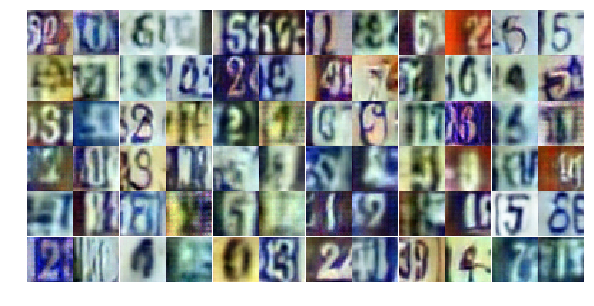

Epoch 19/25... Discriminator Loss: 0.5646... Generator Loss: 1.1939
Epoch 19/25... Discriminator Loss: 0.6069... Generator Loss: 1.0486
Epoch 19/25... Discriminator Loss: 0.9033... Generator Loss: 0.7972
Epoch 19/25... Discriminator Loss: 1.3108... Generator Loss: 0.4518
Epoch 19/25... Discriminator Loss: 0.7026... Generator Loss: 1.1528
Epoch 19/25... Discriminator Loss: 0.6068... Generator Loss: 1.4647
Epoch 19/25... Discriminator Loss: 0.9443... Generator Loss: 0.7218
Epoch 19/25... Discriminator Loss: 0.8295... Generator Loss: 0.8668
Epoch 19/25... Discriminator Loss: 0.6803... Generator Loss: 1.2608
Epoch 19/25... Discriminator Loss: 0.9111... Generator Loss: 0.7863


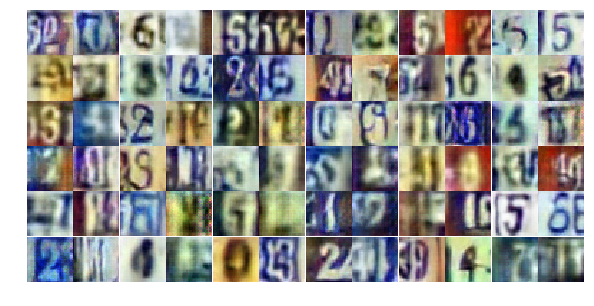

Epoch 19/25... Discriminator Loss: 0.7428... Generator Loss: 0.9915
Epoch 19/25... Discriminator Loss: 1.5795... Generator Loss: 0.3886
Epoch 19/25... Discriminator Loss: 1.5398... Generator Loss: 0.4018
Epoch 19/25... Discriminator Loss: 0.8888... Generator Loss: 0.7727
Epoch 19/25... Discriminator Loss: 0.9304... Generator Loss: 0.7903
Epoch 19/25... Discriminator Loss: 0.7987... Generator Loss: 1.0060
Epoch 19/25... Discriminator Loss: 0.8265... Generator Loss: 0.8129
Epoch 19/25... Discriminator Loss: 0.5469... Generator Loss: 1.2726
Epoch 19/25... Discriminator Loss: 0.7303... Generator Loss: 0.9388
Epoch 19/25... Discriminator Loss: 1.2421... Generator Loss: 0.4829


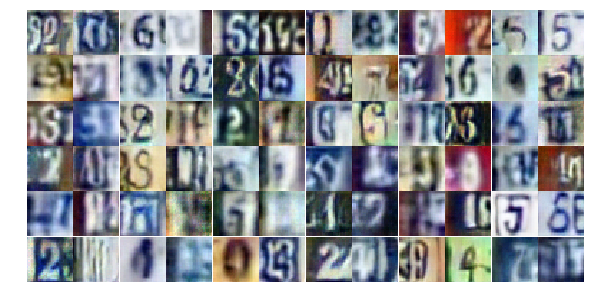

Epoch 19/25... Discriminator Loss: 0.9439... Generator Loss: 0.6877
Epoch 19/25... Discriminator Loss: 1.1112... Generator Loss: 0.5754
Epoch 19/25... Discriminator Loss: 0.8899... Generator Loss: 0.7415
Epoch 19/25... Discriminator Loss: 0.6015... Generator Loss: 1.1290
Epoch 19/25... Discriminator Loss: 0.8592... Generator Loss: 0.7748
Epoch 19/25... Discriminator Loss: 1.9606... Generator Loss: 0.2575
Epoch 19/25... Discriminator Loss: 0.6513... Generator Loss: 1.5708
Epoch 19/25... Discriminator Loss: 0.5171... Generator Loss: 1.3706
Epoch 19/25... Discriminator Loss: 0.6815... Generator Loss: 1.3766
Epoch 19/25... Discriminator Loss: 0.4086... Generator Loss: 1.8836


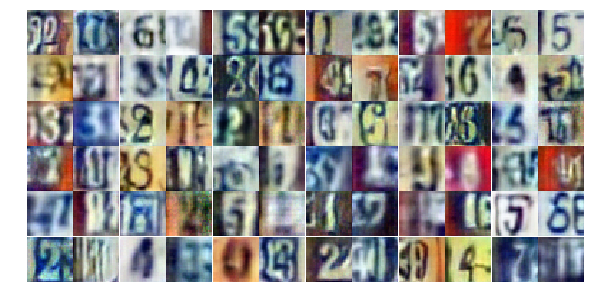

Epoch 19/25... Discriminator Loss: 0.5529... Generator Loss: 1.2037
Epoch 19/25... Discriminator Loss: 0.6776... Generator Loss: 1.1383
Epoch 19/25... Discriminator Loss: 1.1454... Generator Loss: 0.5249
Epoch 19/25... Discriminator Loss: 1.0898... Generator Loss: 0.5741
Epoch 19/25... Discriminator Loss: 0.7553... Generator Loss: 1.5683
Epoch 19/25... Discriminator Loss: 0.6824... Generator Loss: 1.0450
Epoch 19/25... Discriminator Loss: 1.2014... Generator Loss: 0.5111
Epoch 19/25... Discriminator Loss: 0.5622... Generator Loss: 1.2189
Epoch 19/25... Discriminator Loss: 0.4198... Generator Loss: 1.8955
Epoch 19/25... Discriminator Loss: 1.4368... Generator Loss: 0.3886


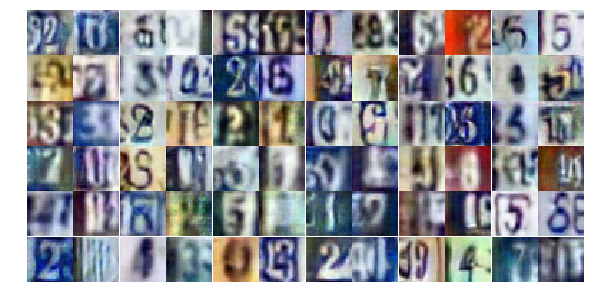

Epoch 19/25... Discriminator Loss: 0.7856... Generator Loss: 0.9680
Epoch 19/25... Discriminator Loss: 0.6193... Generator Loss: 1.3102
Epoch 19/25... Discriminator Loss: 0.6982... Generator Loss: 1.2030
Epoch 19/25... Discriminator Loss: 0.7365... Generator Loss: 1.4143
Epoch 19/25... Discriminator Loss: 0.7418... Generator Loss: 1.5217
Epoch 19/25... Discriminator Loss: 0.6718... Generator Loss: 1.3120
Epoch 19/25... Discriminator Loss: 2.1144... Generator Loss: 0.2467
Epoch 19/25... Discriminator Loss: 0.6952... Generator Loss: 1.2178
Epoch 20/25... Discriminator Loss: 0.8487... Generator Loss: 0.8388
Epoch 20/25... Discriminator Loss: 0.6149... Generator Loss: 1.2151


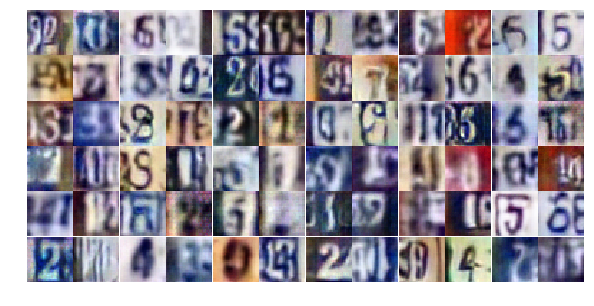

Epoch 20/25... Discriminator Loss: 0.5696... Generator Loss: 1.3483
Epoch 20/25... Discriminator Loss: 0.8608... Generator Loss: 0.8763
Epoch 20/25... Discriminator Loss: 1.5837... Generator Loss: 0.3007
Epoch 20/25... Discriminator Loss: 0.7894... Generator Loss: 0.9611
Epoch 20/25... Discriminator Loss: 0.5208... Generator Loss: 1.3904
Epoch 20/25... Discriminator Loss: 0.6779... Generator Loss: 1.0598
Epoch 20/25... Discriminator Loss: 0.8377... Generator Loss: 0.7724
Epoch 20/25... Discriminator Loss: 0.7211... Generator Loss: 0.9736
Epoch 20/25... Discriminator Loss: 0.8162... Generator Loss: 1.0077
Epoch 20/25... Discriminator Loss: 0.8419... Generator Loss: 0.7810


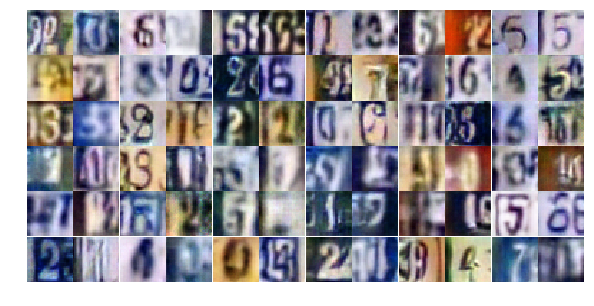

Epoch 20/25... Discriminator Loss: 1.1257... Generator Loss: 0.5890
Epoch 20/25... Discriminator Loss: 0.9604... Generator Loss: 0.6873
Epoch 20/25... Discriminator Loss: 0.6599... Generator Loss: 1.1156
Epoch 20/25... Discriminator Loss: 0.7882... Generator Loss: 1.2519
Epoch 20/25... Discriminator Loss: 0.9983... Generator Loss: 0.7065
Epoch 20/25... Discriminator Loss: 1.0020... Generator Loss: 0.7066
Epoch 20/25... Discriminator Loss: 1.6340... Generator Loss: 0.4125
Epoch 20/25... Discriminator Loss: 0.5917... Generator Loss: 1.4748
Epoch 20/25... Discriminator Loss: 0.6417... Generator Loss: 1.1372
Epoch 20/25... Discriminator Loss: 1.2283... Generator Loss: 0.5319


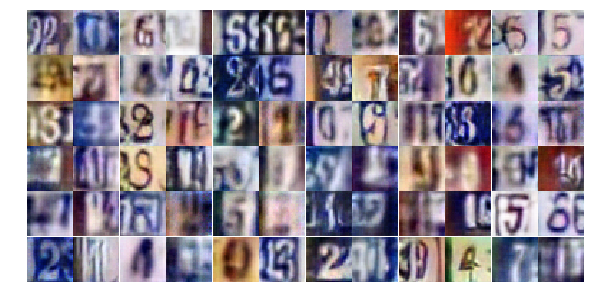

Epoch 20/25... Discriminator Loss: 0.7258... Generator Loss: 0.9763
Epoch 20/25... Discriminator Loss: 0.7504... Generator Loss: 1.0192
Epoch 20/25... Discriminator Loss: 0.3782... Generator Loss: 1.6648
Epoch 20/25... Discriminator Loss: 1.3695... Generator Loss: 0.4770
Epoch 20/25... Discriminator Loss: 1.1035... Generator Loss: 0.6621
Epoch 20/25... Discriminator Loss: 0.6403... Generator Loss: 0.9999
Epoch 20/25... Discriminator Loss: 0.3470... Generator Loss: 2.0991
Epoch 20/25... Discriminator Loss: 1.2878... Generator Loss: 0.5158
Epoch 20/25... Discriminator Loss: 1.2003... Generator Loss: 0.5021
Epoch 20/25... Discriminator Loss: 0.4271... Generator Loss: 1.3501


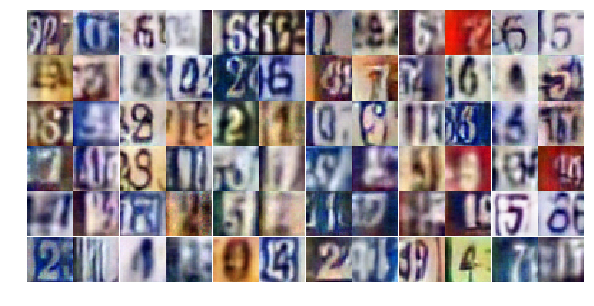

Epoch 20/25... Discriminator Loss: 0.9013... Generator Loss: 0.7990
Epoch 20/25... Discriminator Loss: 0.9163... Generator Loss: 0.8983
Epoch 20/25... Discriminator Loss: 1.6854... Generator Loss: 0.3495
Epoch 20/25... Discriminator Loss: 0.6574... Generator Loss: 1.1420
Epoch 20/25... Discriminator Loss: 0.9088... Generator Loss: 1.2661
Epoch 20/25... Discriminator Loss: 0.7116... Generator Loss: 0.9333
Epoch 20/25... Discriminator Loss: 1.2551... Generator Loss: 0.5060
Epoch 20/25... Discriminator Loss: 0.7946... Generator Loss: 0.9145
Epoch 20/25... Discriminator Loss: 0.6081... Generator Loss: 2.0207
Epoch 20/25... Discriminator Loss: 0.7898... Generator Loss: 1.2282


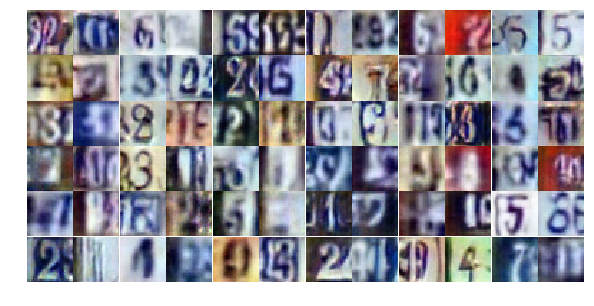

Epoch 20/25... Discriminator Loss: 0.9989... Generator Loss: 0.6787
Epoch 20/25... Discriminator Loss: 0.6935... Generator Loss: 1.2791
Epoch 20/25... Discriminator Loss: 0.6410... Generator Loss: 1.2917
Epoch 20/25... Discriminator Loss: 0.5615... Generator Loss: 1.2119
Epoch 20/25... Discriminator Loss: 0.6060... Generator Loss: 1.2649
Epoch 20/25... Discriminator Loss: 0.6409... Generator Loss: 1.1606
Epoch 20/25... Discriminator Loss: 1.1646... Generator Loss: 0.5213
Epoch 20/25... Discriminator Loss: 0.4192... Generator Loss: 1.7203
Epoch 20/25... Discriminator Loss: 0.7332... Generator Loss: 0.9839
Epoch 20/25... Discriminator Loss: 0.6947... Generator Loss: 1.1004


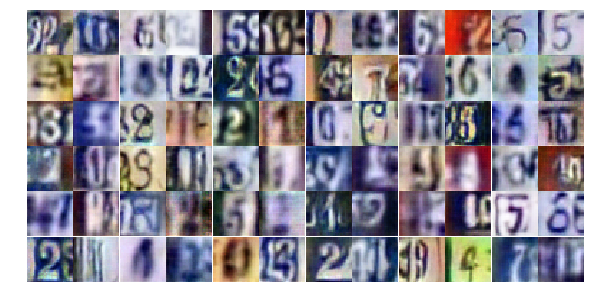

Epoch 20/25... Discriminator Loss: 0.5759... Generator Loss: 1.5154
Epoch 20/25... Discriminator Loss: 0.9776... Generator Loss: 0.7397
Epoch 20/25... Discriminator Loss: 0.4463... Generator Loss: 2.3288
Epoch 20/25... Discriminator Loss: 1.4613... Generator Loss: 0.5028
Epoch 20/25... Discriminator Loss: 0.4895... Generator Loss: 1.5586
Epoch 20/25... Discriminator Loss: 0.6017... Generator Loss: 1.1373
Epoch 21/25... Discriminator Loss: 0.7996... Generator Loss: 1.1745
Epoch 21/25... Discriminator Loss: 0.7451... Generator Loss: 1.4735
Epoch 21/25... Discriminator Loss: 1.5349... Generator Loss: 0.4032
Epoch 21/25... Discriminator Loss: 1.5675... Generator Loss: 0.3562


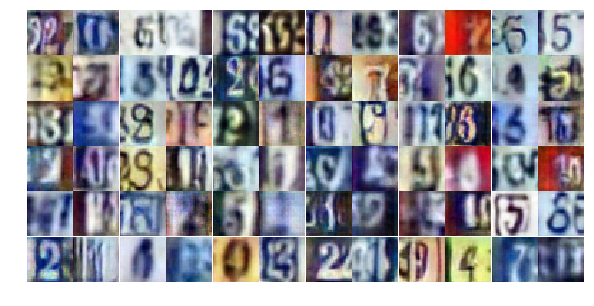

Epoch 21/25... Discriminator Loss: 0.6515... Generator Loss: 1.2619
Epoch 21/25... Discriminator Loss: 1.7508... Generator Loss: 0.3471
Epoch 21/25... Discriminator Loss: 0.4558... Generator Loss: 1.6022
Epoch 21/25... Discriminator Loss: 0.4726... Generator Loss: 1.4015
Epoch 21/25... Discriminator Loss: 0.6474... Generator Loss: 1.0506
Epoch 21/25... Discriminator Loss: 0.6367... Generator Loss: 1.0645
Epoch 21/25... Discriminator Loss: 0.7452... Generator Loss: 0.9203
Epoch 21/25... Discriminator Loss: 0.8699... Generator Loss: 0.8521
Epoch 21/25... Discriminator Loss: 0.4878... Generator Loss: 1.4354
Epoch 21/25... Discriminator Loss: 0.8720... Generator Loss: 0.9267


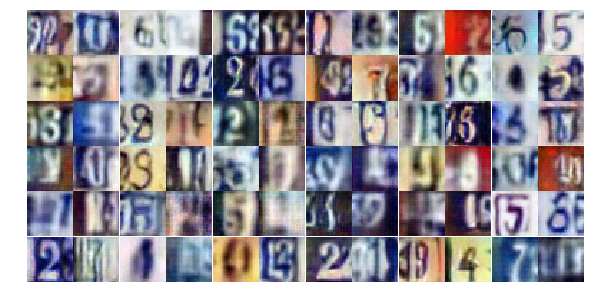

Epoch 21/25... Discriminator Loss: 1.2307... Generator Loss: 0.5383
Epoch 21/25... Discriminator Loss: 1.1768... Generator Loss: 0.5117
Epoch 21/25... Discriminator Loss: 1.9118... Generator Loss: 0.2513
Epoch 21/25... Discriminator Loss: 0.7143... Generator Loss: 1.3417
Epoch 21/25... Discriminator Loss: 0.5956... Generator Loss: 1.3405
Epoch 21/25... Discriminator Loss: 0.9189... Generator Loss: 0.7640
Epoch 21/25... Discriminator Loss: 0.9603... Generator Loss: 0.7236
Epoch 21/25... Discriminator Loss: 0.5087... Generator Loss: 1.4944
Epoch 21/25... Discriminator Loss: 0.4654... Generator Loss: 1.4917
Epoch 21/25... Discriminator Loss: 0.6446... Generator Loss: 1.1503


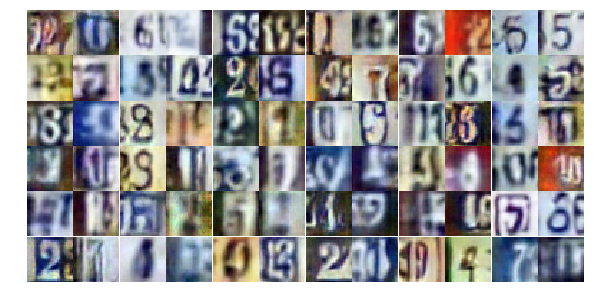

Epoch 21/25... Discriminator Loss: 0.8263... Generator Loss: 0.9535
Epoch 21/25... Discriminator Loss: 0.3923... Generator Loss: 1.6931
Epoch 21/25... Discriminator Loss: 0.7541... Generator Loss: 1.0873
Epoch 21/25... Discriminator Loss: 0.7765... Generator Loss: 0.9914
Epoch 21/25... Discriminator Loss: 1.0556... Generator Loss: 0.6137
Epoch 21/25... Discriminator Loss: 1.1843... Generator Loss: 0.5557
Epoch 21/25... Discriminator Loss: 0.6361... Generator Loss: 1.0238
Epoch 21/25... Discriminator Loss: 1.3124... Generator Loss: 0.4766
Epoch 21/25... Discriminator Loss: 1.1463... Generator Loss: 0.5990
Epoch 21/25... Discriminator Loss: 1.6500... Generator Loss: 0.4282


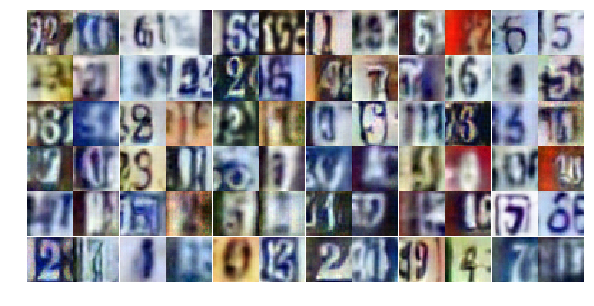

Epoch 21/25... Discriminator Loss: 1.7170... Generator Loss: 0.4562
Epoch 21/25... Discriminator Loss: 0.6588... Generator Loss: 1.1877
Epoch 21/25... Discriminator Loss: 1.1427... Generator Loss: 0.6032
Epoch 21/25... Discriminator Loss: 0.6242... Generator Loss: 1.0784
Epoch 21/25... Discriminator Loss: 0.4846... Generator Loss: 1.4064
Epoch 21/25... Discriminator Loss: 0.6274... Generator Loss: 1.2309
Epoch 21/25... Discriminator Loss: 1.0653... Generator Loss: 0.6265
Epoch 21/25... Discriminator Loss: 1.3885... Generator Loss: 0.4163
Epoch 21/25... Discriminator Loss: 0.8407... Generator Loss: 0.7872
Epoch 21/25... Discriminator Loss: 1.1179... Generator Loss: 4.0426


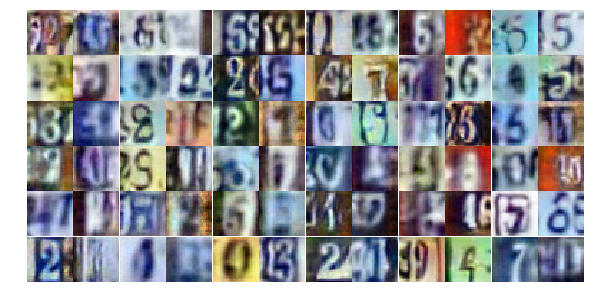

Epoch 21/25... Discriminator Loss: 0.8571... Generator Loss: 0.8391
Epoch 21/25... Discriminator Loss: 0.7879... Generator Loss: 0.9074
Epoch 21/25... Discriminator Loss: 0.6725... Generator Loss: 1.0193
Epoch 21/25... Discriminator Loss: 1.0904... Generator Loss: 0.7254
Epoch 21/25... Discriminator Loss: 0.4204... Generator Loss: 1.9637
Epoch 21/25... Discriminator Loss: 0.7358... Generator Loss: 1.0624
Epoch 21/25... Discriminator Loss: 0.9489... Generator Loss: 0.7325
Epoch 21/25... Discriminator Loss: 0.8643... Generator Loss: 0.9751
Epoch 21/25... Discriminator Loss: 1.0485... Generator Loss: 0.6442
Epoch 21/25... Discriminator Loss: 1.0585... Generator Loss: 0.6499


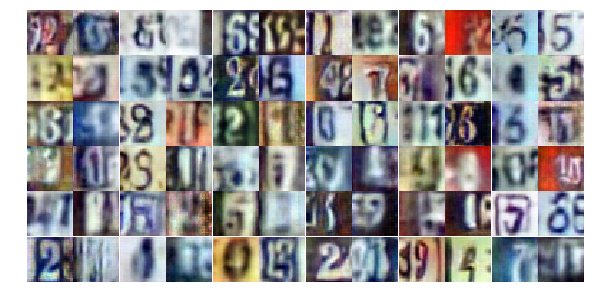

Epoch 21/25... Discriminator Loss: 0.6542... Generator Loss: 1.1639
Epoch 21/25... Discriminator Loss: 1.1638... Generator Loss: 0.5410
Epoch 21/25... Discriminator Loss: 0.7538... Generator Loss: 1.0167
Epoch 22/25... Discriminator Loss: 0.7297... Generator Loss: 1.2203
Epoch 22/25... Discriminator Loss: 0.8969... Generator Loss: 1.3961
Epoch 22/25... Discriminator Loss: 0.6543... Generator Loss: 1.6842
Epoch 22/25... Discriminator Loss: 0.5099... Generator Loss: 1.3881
Epoch 22/25... Discriminator Loss: 0.6627... Generator Loss: 0.9958
Epoch 22/25... Discriminator Loss: 1.3070... Generator Loss: 0.5109
Epoch 22/25... Discriminator Loss: 0.8093... Generator Loss: 0.8781


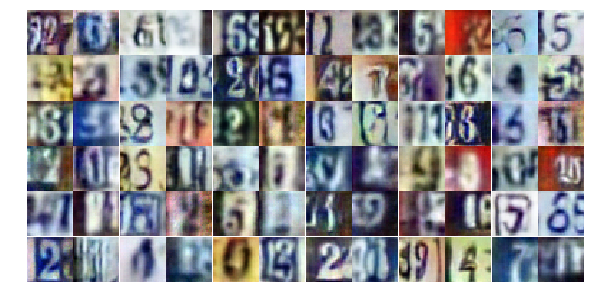

Epoch 22/25... Discriminator Loss: 0.4645... Generator Loss: 1.9801
Epoch 22/25... Discriminator Loss: 0.6622... Generator Loss: 1.2943
Epoch 22/25... Discriminator Loss: 1.6840... Generator Loss: 0.3880
Epoch 22/25... Discriminator Loss: 0.7203... Generator Loss: 0.9936
Epoch 22/25... Discriminator Loss: 1.2364... Generator Loss: 0.5312
Epoch 22/25... Discriminator Loss: 0.5645... Generator Loss: 1.2192
Epoch 22/25... Discriminator Loss: 0.8278... Generator Loss: 0.8284
Epoch 22/25... Discriminator Loss: 0.5331... Generator Loss: 2.0052
Epoch 22/25... Discriminator Loss: 0.9630... Generator Loss: 0.6981
Epoch 22/25... Discriminator Loss: 1.8251... Generator Loss: 0.2889


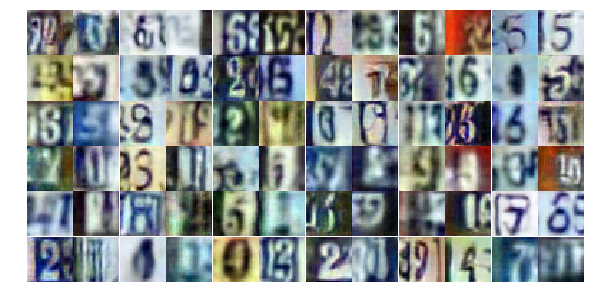

Epoch 22/25... Discriminator Loss: 5.4464... Generator Loss: 3.7147
Epoch 22/25... Discriminator Loss: 2.1242... Generator Loss: 4.5263
Epoch 22/25... Discriminator Loss: 0.8914... Generator Loss: 0.8233
Epoch 22/25... Discriminator Loss: 0.8225... Generator Loss: 0.8345
Epoch 22/25... Discriminator Loss: 0.7236... Generator Loss: 1.8301
Epoch 22/25... Discriminator Loss: 1.4089... Generator Loss: 0.4104
Epoch 22/25... Discriminator Loss: 0.6442... Generator Loss: 1.1055
Epoch 22/25... Discriminator Loss: 0.5921... Generator Loss: 1.1686
Epoch 22/25... Discriminator Loss: 0.8261... Generator Loss: 0.9055
Epoch 22/25... Discriminator Loss: 1.6182... Generator Loss: 0.3181


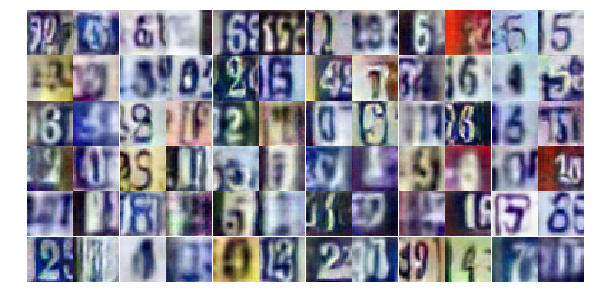

Epoch 22/25... Discriminator Loss: 0.5848... Generator Loss: 1.1575
Epoch 22/25... Discriminator Loss: 0.7602... Generator Loss: 0.9116
Epoch 22/25... Discriminator Loss: 0.8128... Generator Loss: 0.8298
Epoch 22/25... Discriminator Loss: 0.8094... Generator Loss: 0.8915
Epoch 22/25... Discriminator Loss: 0.8182... Generator Loss: 0.9205
Epoch 22/25... Discriminator Loss: 1.0508... Generator Loss: 0.6483
Epoch 22/25... Discriminator Loss: 1.2994... Generator Loss: 0.4509
Epoch 22/25... Discriminator Loss: 0.5290... Generator Loss: 1.5456
Epoch 22/25... Discriminator Loss: 0.9580... Generator Loss: 0.8106
Epoch 22/25... Discriminator Loss: 0.5790... Generator Loss: 1.4661


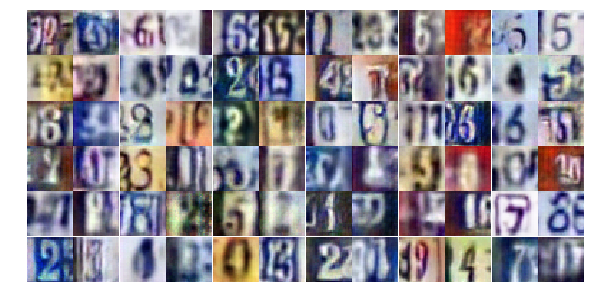

Epoch 22/25... Discriminator Loss: 0.8617... Generator Loss: 0.8804
Epoch 22/25... Discriminator Loss: 0.7277... Generator Loss: 1.0209
Epoch 22/25... Discriminator Loss: 0.5230... Generator Loss: 1.3009
Epoch 22/25... Discriminator Loss: 0.8282... Generator Loss: 0.8998
Epoch 22/25... Discriminator Loss: 0.7275... Generator Loss: 0.9605
Epoch 22/25... Discriminator Loss: 0.5667... Generator Loss: 1.2006
Epoch 22/25... Discriminator Loss: 0.7038... Generator Loss: 1.0143
Epoch 22/25... Discriminator Loss: 0.7003... Generator Loss: 1.0933
Epoch 22/25... Discriminator Loss: 1.4467... Generator Loss: 0.4408
Epoch 22/25... Discriminator Loss: 0.6543... Generator Loss: 1.2019


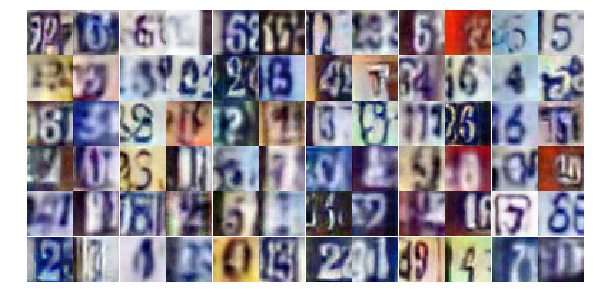

Epoch 22/25... Discriminator Loss: 1.1912... Generator Loss: 0.5399
Epoch 22/25... Discriminator Loss: 0.5049... Generator Loss: 1.5002
Epoch 22/25... Discriminator Loss: 1.1395... Generator Loss: 0.5535
Epoch 22/25... Discriminator Loss: 0.9069... Generator Loss: 0.9613
Epoch 22/25... Discriminator Loss: 1.1197... Generator Loss: 0.6303
Epoch 22/25... Discriminator Loss: 0.7013... Generator Loss: 1.6366
Epoch 22/25... Discriminator Loss: 0.7440... Generator Loss: 1.3144
Epoch 22/25... Discriminator Loss: 0.5083... Generator Loss: 1.4562
Epoch 22/25... Discriminator Loss: 1.2075... Generator Loss: 2.6940
Epoch 22/25... Discriminator Loss: 1.0200... Generator Loss: 0.6275


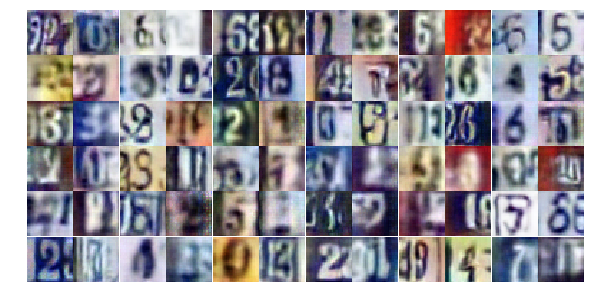

Epoch 23/25... Discriminator Loss: 0.5227... Generator Loss: 1.3876
Epoch 23/25... Discriminator Loss: 0.4553... Generator Loss: 1.5388
Epoch 23/25... Discriminator Loss: 1.3902... Generator Loss: 0.3876
Epoch 23/25... Discriminator Loss: 0.7077... Generator Loss: 1.0028
Epoch 23/25... Discriminator Loss: 0.6595... Generator Loss: 1.0443
Epoch 23/25... Discriminator Loss: 1.0477... Generator Loss: 0.7083
Epoch 23/25... Discriminator Loss: 1.5767... Generator Loss: 0.3460
Epoch 23/25... Discriminator Loss: 0.8462... Generator Loss: 0.8045
Epoch 23/25... Discriminator Loss: 0.6277... Generator Loss: 1.2686
Epoch 23/25... Discriminator Loss: 0.5576... Generator Loss: 1.0960


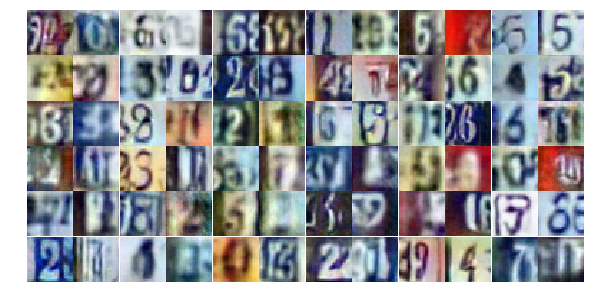

Epoch 23/25... Discriminator Loss: 0.5775... Generator Loss: 1.1073
Epoch 23/25... Discriminator Loss: 0.4405... Generator Loss: 2.2507
Epoch 23/25... Discriminator Loss: 0.6099... Generator Loss: 2.1139
Epoch 23/25... Discriminator Loss: 0.8907... Generator Loss: 0.8495
Epoch 23/25... Discriminator Loss: 0.5692... Generator Loss: 1.3380
Epoch 23/25... Discriminator Loss: 0.6423... Generator Loss: 1.5113
Epoch 23/25... Discriminator Loss: 0.9382... Generator Loss: 0.7242
Epoch 23/25... Discriminator Loss: 0.5665... Generator Loss: 2.8602
Epoch 23/25... Discriminator Loss: 0.7426... Generator Loss: 1.3264
Epoch 23/25... Discriminator Loss: 0.7434... Generator Loss: 1.0778


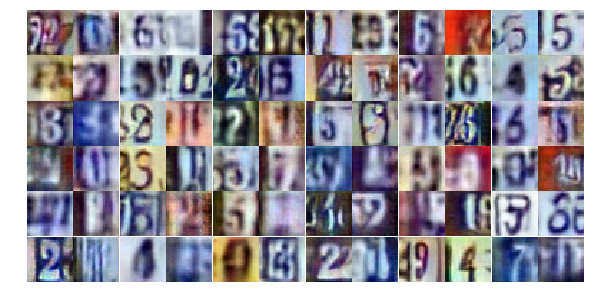

Epoch 23/25... Discriminator Loss: 1.7323... Generator Loss: 0.3097
Epoch 23/25... Discriminator Loss: 0.5702... Generator Loss: 1.1710
Epoch 23/25... Discriminator Loss: 1.2989... Generator Loss: 0.4560
Epoch 23/25... Discriminator Loss: 1.0454... Generator Loss: 0.6607
Epoch 23/25... Discriminator Loss: 0.6260... Generator Loss: 1.2095
Epoch 23/25... Discriminator Loss: 0.6476... Generator Loss: 1.0639
Epoch 23/25... Discriminator Loss: 0.8210... Generator Loss: 0.8094
Epoch 23/25... Discriminator Loss: 0.6790... Generator Loss: 1.0286
Epoch 23/25... Discriminator Loss: 0.5083... Generator Loss: 1.3310
Epoch 23/25... Discriminator Loss: 0.7097... Generator Loss: 1.6688


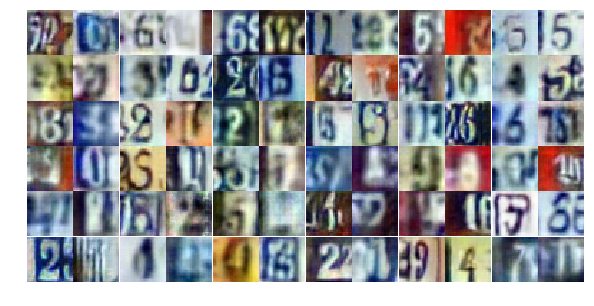

Epoch 23/25... Discriminator Loss: 0.6337... Generator Loss: 1.0038
Epoch 23/25... Discriminator Loss: 0.5207... Generator Loss: 1.3085
Epoch 23/25... Discriminator Loss: 0.6328... Generator Loss: 1.1644
Epoch 23/25... Discriminator Loss: 1.3871... Generator Loss: 0.5759
Epoch 23/25... Discriminator Loss: 0.8387... Generator Loss: 2.3719
Epoch 23/25... Discriminator Loss: 0.8678... Generator Loss: 1.9690
Epoch 23/25... Discriminator Loss: 0.8808... Generator Loss: 0.9964
Epoch 23/25... Discriminator Loss: 0.6561... Generator Loss: 1.1211
Epoch 23/25... Discriminator Loss: 0.5206... Generator Loss: 1.3280
Epoch 23/25... Discriminator Loss: 0.6542... Generator Loss: 1.0141


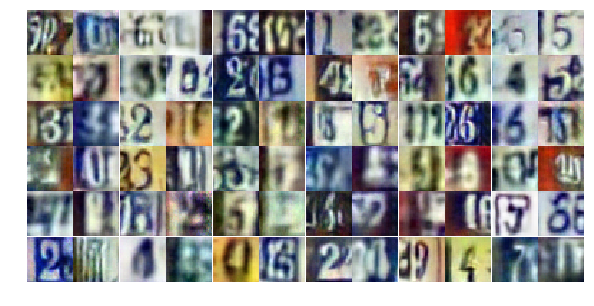

Epoch 23/25... Discriminator Loss: 0.9719... Generator Loss: 0.8997
Epoch 23/25... Discriminator Loss: 0.7075... Generator Loss: 0.9979
Epoch 23/25... Discriminator Loss: 1.2457... Generator Loss: 0.5140
Epoch 23/25... Discriminator Loss: 0.6490... Generator Loss: 1.1498
Epoch 23/25... Discriminator Loss: 1.3263... Generator Loss: 0.5175
Epoch 23/25... Discriminator Loss: 0.9566... Generator Loss: 0.6765
Epoch 23/25... Discriminator Loss: 0.8259... Generator Loss: 0.7957
Epoch 23/25... Discriminator Loss: 1.0630... Generator Loss: 0.6167
Epoch 23/25... Discriminator Loss: 0.6044... Generator Loss: 1.3127
Epoch 23/25... Discriminator Loss: 0.6103... Generator Loss: 1.3054


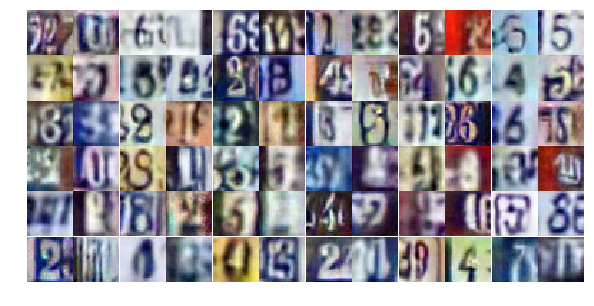

Epoch 23/25... Discriminator Loss: 0.8273... Generator Loss: 0.8804
Epoch 23/25... Discriminator Loss: 1.0338... Generator Loss: 0.5951
Epoch 23/25... Discriminator Loss: 1.1750... Generator Loss: 0.7003
Epoch 23/25... Discriminator Loss: 0.3079... Generator Loss: 1.9243
Epoch 23/25... Discriminator Loss: 1.8954... Generator Loss: 0.2798
Epoch 23/25... Discriminator Loss: 0.5123... Generator Loss: 2.3435
Epoch 23/25... Discriminator Loss: 1.2335... Generator Loss: 0.7035
Epoch 24/25... Discriminator Loss: 0.5448... Generator Loss: 1.6422
Epoch 24/25... Discriminator Loss: 0.8062... Generator Loss: 1.0180
Epoch 24/25... Discriminator Loss: 1.1337... Generator Loss: 0.6576


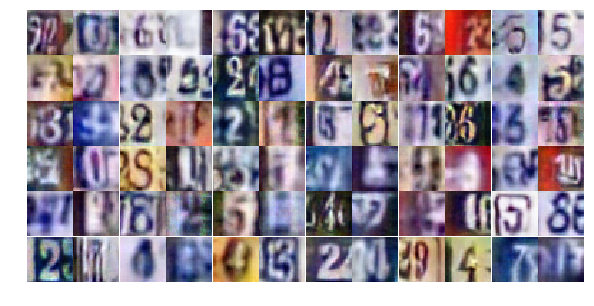

Epoch 24/25... Discriminator Loss: 0.7399... Generator Loss: 1.5861
Epoch 24/25... Discriminator Loss: 0.6963... Generator Loss: 1.0599
Epoch 24/25... Discriminator Loss: 0.8799... Generator Loss: 0.7731
Epoch 24/25... Discriminator Loss: 0.7108... Generator Loss: 1.2338
Epoch 24/25... Discriminator Loss: 1.0388... Generator Loss: 0.6916
Epoch 24/25... Discriminator Loss: 0.7079... Generator Loss: 1.0542
Epoch 24/25... Discriminator Loss: 0.6737... Generator Loss: 1.0843
Epoch 24/25... Discriminator Loss: 1.4189... Generator Loss: 0.4039
Epoch 24/25... Discriminator Loss: 0.5462... Generator Loss: 1.2173
Epoch 24/25... Discriminator Loss: 0.6436... Generator Loss: 1.1457


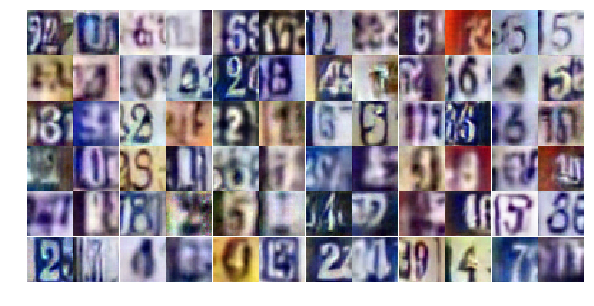

Epoch 24/25... Discriminator Loss: 1.2763... Generator Loss: 0.4529
Epoch 24/25... Discriminator Loss: 1.3177... Generator Loss: 0.4680
Epoch 24/25... Discriminator Loss: 1.3328... Generator Loss: 0.4717
Epoch 24/25... Discriminator Loss: 0.6649... Generator Loss: 1.0215
Epoch 24/25... Discriminator Loss: 0.5847... Generator Loss: 1.5033
Epoch 24/25... Discriminator Loss: 0.8290... Generator Loss: 0.7966
Epoch 24/25... Discriminator Loss: 0.4847... Generator Loss: 1.4388
Epoch 24/25... Discriminator Loss: 0.8825... Generator Loss: 0.8455
Epoch 24/25... Discriminator Loss: 0.8990... Generator Loss: 0.8696
Epoch 24/25... Discriminator Loss: 1.2084... Generator Loss: 0.5533


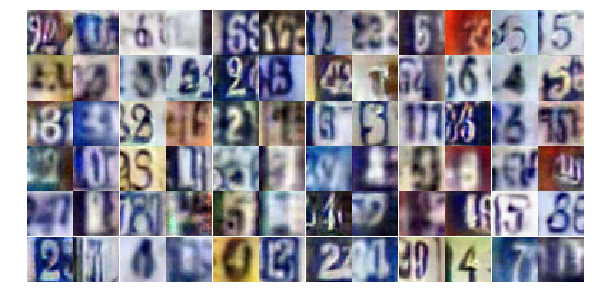

Epoch 24/25... Discriminator Loss: 1.0750... Generator Loss: 2.6495
Epoch 24/25... Discriminator Loss: 1.0722... Generator Loss: 0.6835
Epoch 24/25... Discriminator Loss: 0.7686... Generator Loss: 0.9897
Epoch 24/25... Discriminator Loss: 1.2682... Generator Loss: 0.5760
Epoch 24/25... Discriminator Loss: 0.7549... Generator Loss: 0.9644
Epoch 24/25... Discriminator Loss: 0.6713... Generator Loss: 1.0309
Epoch 24/25... Discriminator Loss: 0.6649... Generator Loss: 0.9750
Epoch 24/25... Discriminator Loss: 0.6958... Generator Loss: 1.0325
Epoch 24/25... Discriminator Loss: 0.7307... Generator Loss: 0.9545
Epoch 24/25... Discriminator Loss: 1.2244... Generator Loss: 0.4865


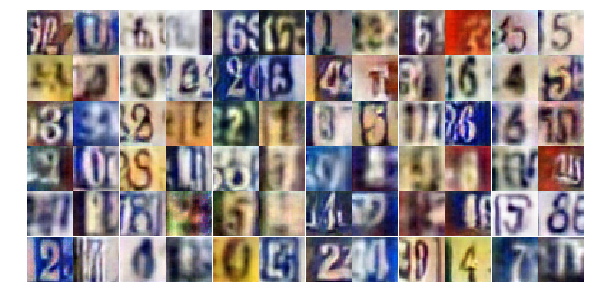

Epoch 24/25... Discriminator Loss: 0.7305... Generator Loss: 0.9770
Epoch 24/25... Discriminator Loss: 0.5107... Generator Loss: 1.6065
Epoch 24/25... Discriminator Loss: 0.7013... Generator Loss: 1.1827
Epoch 24/25... Discriminator Loss: 1.6220... Generator Loss: 0.3419
Epoch 24/25... Discriminator Loss: 0.9461... Generator Loss: 0.8287
Epoch 24/25... Discriminator Loss: 0.7983... Generator Loss: 0.8270
Epoch 24/25... Discriminator Loss: 1.5303... Generator Loss: 0.3693
Epoch 24/25... Discriminator Loss: 0.7911... Generator Loss: 0.8403
Epoch 24/25... Discriminator Loss: 1.1954... Generator Loss: 0.5892
Epoch 24/25... Discriminator Loss: 0.7873... Generator Loss: 0.8906


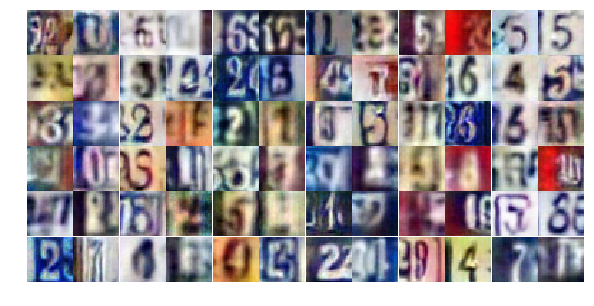

Epoch 24/25... Discriminator Loss: 1.4927... Generator Loss: 0.3822
Epoch 24/25... Discriminator Loss: 0.9362... Generator Loss: 0.7869
Epoch 24/25... Discriminator Loss: 1.4216... Generator Loss: 0.4074
Epoch 24/25... Discriminator Loss: 0.9736... Generator Loss: 0.6344
Epoch 24/25... Discriminator Loss: 1.6400... Generator Loss: 0.3287
Epoch 24/25... Discriminator Loss: 0.6172... Generator Loss: 1.2843
Epoch 24/25... Discriminator Loss: 1.5839... Generator Loss: 0.3370
Epoch 24/25... Discriminator Loss: 0.6505... Generator Loss: 1.1622
Epoch 24/25... Discriminator Loss: 1.2080... Generator Loss: 0.5232
Epoch 24/25... Discriminator Loss: 0.6191... Generator Loss: 1.3410


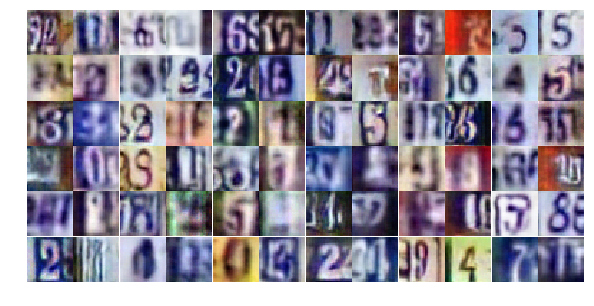

Epoch 24/25... Discriminator Loss: 0.5308... Generator Loss: 1.6846
Epoch 24/25... Discriminator Loss: 1.5609... Generator Loss: 0.3822
Epoch 24/25... Discriminator Loss: 2.0878... Generator Loss: 0.2710
Epoch 24/25... Discriminator Loss: 1.8233... Generator Loss: 3.4037
Epoch 24/25... Discriminator Loss: 0.8676... Generator Loss: 1.1578
Epoch 25/25... Discriminator Loss: 0.7465... Generator Loss: 1.0346
Epoch 25/25... Discriminator Loss: 0.5583... Generator Loss: 1.5690
Epoch 25/25... Discriminator Loss: 1.1433... Generator Loss: 0.5540
Epoch 25/25... Discriminator Loss: 0.6605... Generator Loss: 1.0713
Epoch 25/25... Discriminator Loss: 1.2060... Generator Loss: 0.5352


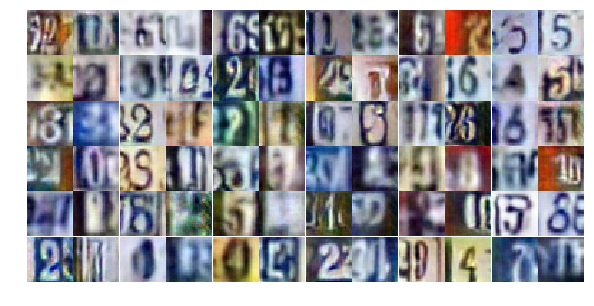

Epoch 25/25... Discriminator Loss: 0.9098... Generator Loss: 0.7482
Epoch 25/25... Discriminator Loss: 1.3454... Generator Loss: 0.4949
Epoch 25/25... Discriminator Loss: 0.5182... Generator Loss: 1.3382
Epoch 25/25... Discriminator Loss: 0.6122... Generator Loss: 1.2346
Epoch 25/25... Discriminator Loss: 0.6561... Generator Loss: 1.6800
Epoch 25/25... Discriminator Loss: 0.7059... Generator Loss: 1.0220
Epoch 25/25... Discriminator Loss: 0.7902... Generator Loss: 0.8316
Epoch 25/25... Discriminator Loss: 0.8060... Generator Loss: 0.8433
Epoch 25/25... Discriminator Loss: 0.4833... Generator Loss: 1.3761
Epoch 25/25... Discriminator Loss: 0.8887... Generator Loss: 0.8070


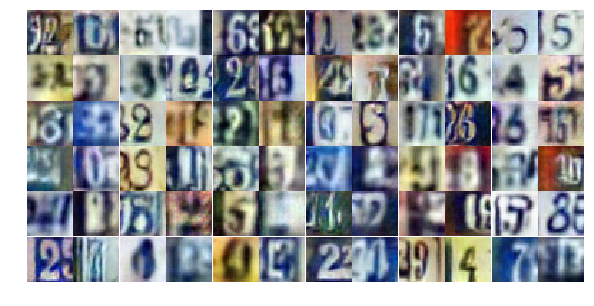

Epoch 25/25... Discriminator Loss: 0.9207... Generator Loss: 0.7337
Epoch 25/25... Discriminator Loss: 0.9608... Generator Loss: 2.8122
Epoch 25/25... Discriminator Loss: 0.8478... Generator Loss: 0.8193
Epoch 25/25... Discriminator Loss: 0.6888... Generator Loss: 1.0682
Epoch 25/25... Discriminator Loss: 0.7278... Generator Loss: 1.0201
Epoch 25/25... Discriminator Loss: 0.5821... Generator Loss: 1.4240
Epoch 25/25... Discriminator Loss: 1.0720... Generator Loss: 0.6148
Epoch 25/25... Discriminator Loss: 1.1827... Generator Loss: 0.5950
Epoch 25/25... Discriminator Loss: 0.6332... Generator Loss: 1.2440
Epoch 25/25... Discriminator Loss: 0.5372... Generator Loss: 1.2732


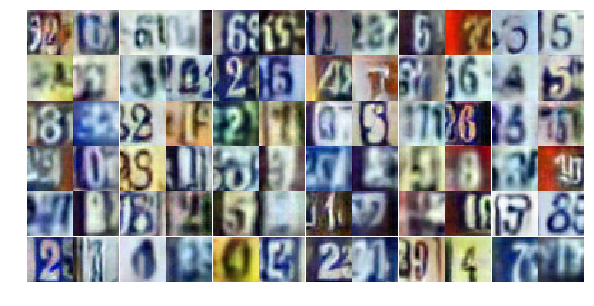

Epoch 25/25... Discriminator Loss: 1.0700... Generator Loss: 0.6065
Epoch 25/25... Discriminator Loss: 0.4395... Generator Loss: 1.9805
Epoch 25/25... Discriminator Loss: 1.6694... Generator Loss: 0.4507
Epoch 25/25... Discriminator Loss: 0.6295... Generator Loss: 1.0558
Epoch 25/25... Discriminator Loss: 1.1960... Generator Loss: 0.5620
Epoch 25/25... Discriminator Loss: 0.5564... Generator Loss: 1.2036
Epoch 25/25... Discriminator Loss: 0.9570... Generator Loss: 0.7042
Epoch 25/25... Discriminator Loss: 0.8736... Generator Loss: 0.8293
Epoch 25/25... Discriminator Loss: 1.0582... Generator Loss: 0.7539
Epoch 25/25... Discriminator Loss: 0.5890... Generator Loss: 1.1379


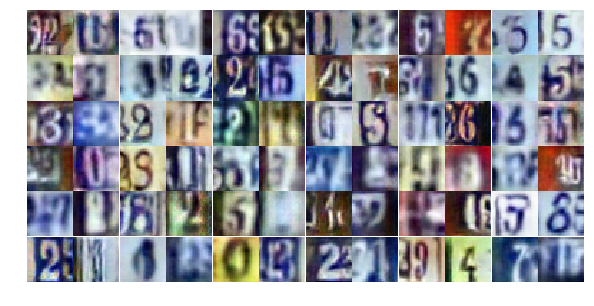

Epoch 25/25... Discriminator Loss: 0.6191... Generator Loss: 1.3053
Epoch 25/25... Discriminator Loss: 0.7741... Generator Loss: 0.8808
Epoch 25/25... Discriminator Loss: 0.6068... Generator Loss: 1.3279
Epoch 25/25... Discriminator Loss: 0.7369... Generator Loss: 1.0270
Epoch 25/25... Discriminator Loss: 1.0201... Generator Loss: 0.7072
Epoch 25/25... Discriminator Loss: 0.7429... Generator Loss: 1.2370
Epoch 25/25... Discriminator Loss: 0.4987... Generator Loss: 1.4308
Epoch 25/25... Discriminator Loss: 0.9693... Generator Loss: 0.7518
Epoch 25/25... Discriminator Loss: 1.9948... Generator Loss: 0.2596
Epoch 25/25... Discriminator Loss: 0.5512... Generator Loss: 2.4345


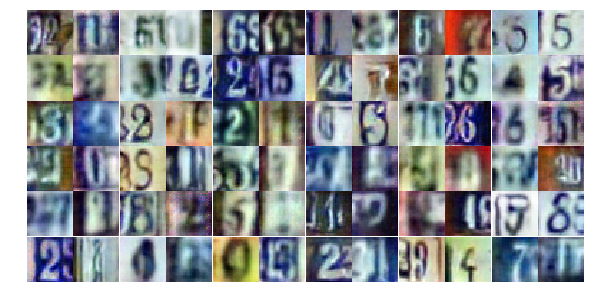

Epoch 25/25... Discriminator Loss: 0.7045... Generator Loss: 1.2977
Epoch 25/25... Discriminator Loss: 0.7551... Generator Loss: 0.9518
Epoch 25/25... Discriminator Loss: 0.7225... Generator Loss: 1.0462
Epoch 25/25... Discriminator Loss: 0.6207... Generator Loss: 1.3269
Epoch 25/25... Discriminator Loss: 1.1863... Generator Loss: 0.6359
Epoch 25/25... Discriminator Loss: 0.8682... Generator Loss: 0.8086
Epoch 25/25... Discriminator Loss: 1.6591... Generator Loss: 0.3398
Epoch 25/25... Discriminator Loss: 8.0128... Generator Loss: 0.0013
Epoch 25/25... Discriminator Loss: 1.1870... Generator Loss: 1.8200
Epoch 25/25... Discriminator Loss: 1.4728... Generator Loss: 0.5448


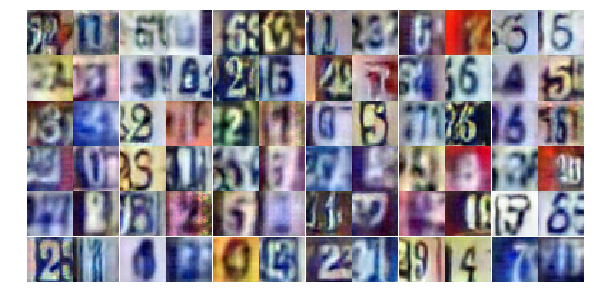

Epoch 25/25... Discriminator Loss: 0.6588... Generator Loss: 1.2636
Epoch 25/25... Discriminator Loss: 1.5837... Generator Loss: 0.3452


In [25]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

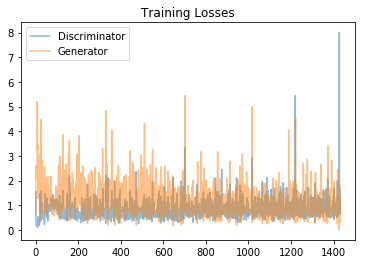

In [26]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

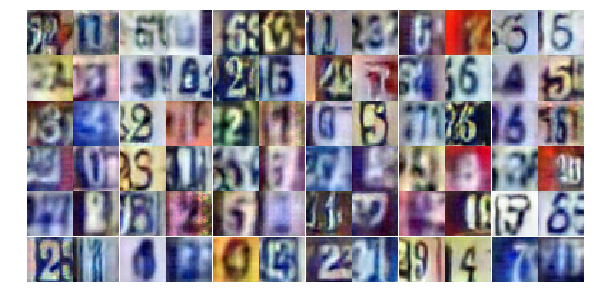

In [27]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))